In [1]:
import matplotlib.pyplot as plt
from mpl_toolkits.mplot3d import Axes3D
import numpy as np
from sklearn.linear_model import Lasso
from scipy.io import loadmat
from sklearn.metrics import mean_squared_error
from scipy.integrate import solve_ivp
import pandas as pd
import random
import pysindy as ps

import os

import math  

from compare_center import cmp_center

import sys  
sys.path.append('C:/Users/j/hotai/myfolder')

from my_function import miscore, siscore
# Ignore matplotlib deprecation warnings
import warnings
warnings.filterwarnings("ignore", category=UserWarning)

# Seed the random number generators for reproducibility
np.random.seed(100)

integrator_keywords = {}
integrator_keywords['rtol'] = 1e-12
integrator_keywords['method'] = 'LSODA'
integrator_keywords['atol'] = 1e-12

addp=5
startp=90
endp=120
dp=endp-startp
p_tot=addp*(dp-1)+1
file_tot=100

xstart=0
xend=25
n=xend-xstart

In [2]:
def read_data(file_path,file_name,n,file_start=0,file_end=0,xstart=0,xend=0):
    x=np.zeros((121,n,n))
    y=np.zeros((121,n,n))
    vx=np.zeros((121,n,n))
    vy=np.zeros((121,n,n))
    
    for i in range(file_start,file_end):
        xp=[]
        yp=[]
        vxp=[]
        vyp=[]
        isvalid=[]
        xtmp=[]
        ytmp=[]
        vxtmp=[]
        vytmp=[]
        isvalidtmp=[]
        
        for root,dirs,files in os.walk(file_path):
            #print(root)
            
            for dir in dirs:
                #print(os.path.join(root,file))
                
    
                    with open(os.path.join(root,dir,file_name[i]), 'r') as f:  
                        lines = f.readlines()
                        for line in lines[3:]: 
                            num=line.split()
                            xtmp.append(float(num[0]))
                            ytmp.append(float(num[1]))
                            vxtmp.append(float(num[2]))
                            vytmp.append(float(num[3]))
                            isvalidtmp.append(float(num[4]))
        
                    xp.append(np.array(xtmp).reshape(25,25))
                    yp.append(np.array(ytmp).reshape(25,25))
                    vxp.append(np.array(vxtmp).reshape(25,25))
                    vyp.append(np.array(vytmp).reshape(25,25))
                    isvalid.append(np.array(isvalidtmp).reshape(25,25))
                    xtmp=[]
                    ytmp=[]
                    vxtmp=[]
                    vytmp=[]
                    isvalidtmp=[]
        #
        xp=np.array(xp)
        yp=np.array(yp)
        vxp=np.array(vxp)
        vyp=np.array(vyp)
        isvalid=np.array(isvalid)
        x=xp
        y=yp
        vx=vx+vxp/file_tot
        vy=vy+vyp/file_tot
        print(file_tot)
    x=x.T
    x=x[xstart:xend,xstart:xend]
    y=y.T
    y=y[xstart:xend,xstart:xend]
    vx=vx.T
    vx=vx[xstart:xend,xstart:xend]
    vy=vy.T
    vy=vy[xstart:xend,xstart:xend]
    isvalid=isvalid.T
    isvalid=isvalid[xstart:xend,xstart:xend]
    return x,y,vx,vy

In [3]:
file_path = os.path.join('D:\\', 'hotaidata','sr_C6_01')
file_name=['B00001.dat','B00002.dat','B00003.dat','B00004.dat','B00005.dat','B00006.dat','B00007.dat','B00008.dat',
           'B00009.dat','B00010.dat','B00011.dat','B00012.dat','B00013.dat','B00014.dat','B00015.dat','B00016.dat','B00017.dat',
           'B00018.dat','B00019.dat','B00020.dat','B00021.dat','B00022.dat','B00023.dat','B00024.dat','B00025.dat','B00026.dat',
           'B00027.dat','B00028.dat','B00029.dat','B00030.dat','B00031.dat','B00032.dat','B00033.dat','B00034.dat','B00035.dat',
           'B00036.dat','B00037.dat','B00038.dat','B00039.dat','B00040.dat','B00041.dat','B00042.dat','B00043.dat','B00044.dat',
           'B00045.dat','B00046.dat','B00047.dat','B00048.dat','B00049.dat','B00050.dat','B00051.dat','B00052.dat','B00053.dat',
           'B00054.dat','B00055.dat','B00056.dat','B00057.dat','B00058.dat','B00059.dat','B00060.dat','B00061.dat','B00062.dat',
           'B00063.dat','B00064.dat','B00065.dat','B00066.dat','B00067.dat','B00068.dat','B00069.dat','B00070.dat','B00071.dat',
           'B00072.dat','B00073.dat','B00074.dat','B00075.dat','B00076.dat','B00077.dat','B00078.dat','B00079.dat','B00080.dat',
           'B00081.dat','B00082.dat','B00083.dat','B00084.dat','B00085.dat','B00086.dat','B00087.dat','B00088.dat','B00089.dat',
           'B00090.dat','B00091.dat','B00092.dat','B00093.dat','B00094.dat','B00095.dat','B00096.dat','B00097.dat','B00098.dat',
           'B00099.dat','B00100.dat']
x=np.zeros((121,n,n))
y=np.zeros((121,n,n))
vx=np.zeros((121,n,n))
vy=np.zeros((121,n,n))

x,y,vx,vy=read_data(file_path,file_name,25,0,50,xstart,xend)
#print(x[0,:,:])
t=np.linspace(0,60/800,121)
dt=t[1]-t[0]

t=t[startp:endp]
print(len(t))
t_train=np.linspace(t[0],t[-1],addp*(len(t)-1)+1)
dt_train=t_train[1]-t_train[0]
print(len(t_train.shape))

100
100
100
100
100
100
100
100
100
100
100
100
100
100
100
100
100
100
100
100
100
100
100
100
100
100
100
100
100
100
100
100
100
100
100
100
100
100
100
100
100
100
100
100
100
100
100
100
100
100
30
1


In [4]:
#u is not pre adding, v add a median
spatial_grid = np.asarray([x[:,:,0].T,y[:,:,0].T]).T
print(spatial_grid.shape)
n=xend-xstart

t_in=np.zeros((n,n,dp))
for i in range (dp):
    t_in[:,:,i]=t[i]

print(t_in[0,0])

u=np.zeros((n,n,121, 3))

u[:, :, :, 0] = vx
u[:, :, :, 1] = vy
u[:, :, startp:endp, 2] = t_in
u_train=np.zeros((n,n,len(t), 3))
u_train=u[:,:,startp:endp,:]

v_train=np.zeros((n,n,len(t_train),3))

for i in range(len(t)-1):
    for j in range(addp):
        v_train[:,:,addp*i+j]=(u_train[:,:,i]*(addp-j)+u_train[:,:,i+1]*j)/addp
v_train[:,:,-1]=u_train[:,:,-1]


(25, 25, 2)
[0.05625  0.056875 0.0575   0.058125 0.05875  0.059375 0.06     0.060625
 0.06125  0.061875 0.0625   0.063125 0.06375  0.064375 0.065    0.065625
 0.06625  0.066875 0.0675   0.068125 0.06875  0.069375 0.07     0.070625
 0.07125  0.071875 0.0725   0.073125 0.07375  0.074375]


<function matplotlib.pyplot.show(close=None, block=None)>

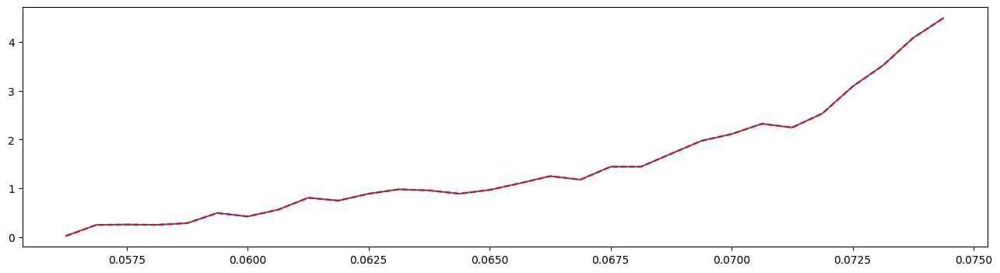

In [5]:
op=np.zeros(len(t))
op=u_train[10,10,:,0]
op_train=np.zeros(len(t_train))
for i in range(len(t)-1):
    for j in range(addp):
        op_train[i*addp+j]=(op[i]*(addp-j)+op[i+1]*j)/addp
op_train[-1]=op[-1]
plt.figure(figsize=(16, 4))
plt.plot(t,op)
plt.plot(t_train,op_train,'r--')
plt.show

In [6]:
v_train_dot = ps.FiniteDifference(axis=2)._differentiate(v_train, dt_train)

vtmp=np.zeros(v_train_dot.shape)
vtmp[:,:,0]=v_train[:,:,0]
for i in range(len(t_train)-1):
    vtmp[:,:,i+1]=vtmp[:,:,i]+v_train_dot[:,:,i]*dt_train
miscore(vtmp,v_train)
siscore(vtmp,v_train)
vtmp=v_train+v_train_dot*dt_train

vtmp[:,:,1:]=vtmp[:,:,:len(t_train)-1]
miscore(vtmp,v_train)
siscore(vtmp,v_train)


MI(average/percent):
0.9957774001416696 0.9997569597878921
SI(average/percent):
0.9999999999999895 1.0
MI(average/percent):
0.9991837746583707 0.9999779054352629
SI(average/percent):
0.9999497164065217 1.0


(0.9999497164065217, 1.0)

In [7]:
# Define PDE library that is quadratic in u, and
# fourth-order in spatial derivatives of u.    periodic=True

library_functions = [
    lambda y: y,
    lambda x: x*x,
    
    lambda x, y: x * y,
    lambda x, y: x * x * y,
    lambda x , y , z: x * y * z
]
library_function_names = [
    lambda y: y,
    lambda x: x+x,
    
    lambda x, y: x + y,
    lambda x, y: x + x + y,
    lambda x , y , z: x + y + z
]
pde_lib = ps.PDELibrary(
    library_functions=library_functions,
    function_names=library_function_names,
    derivative_order=1,
    spatial_grid=spatial_grid,
    include_bias=True,
    is_uniform=True
    
)




print('SINDy')
model = ps.SINDy(feature_library=pde_lib, feature_names=['Vx','Vy','t'])

model.fit(v_train, x_dot=v_train_dot)
model.print()
#u_dot_stlsq = model.predict(v_train)x_dot=v_train_dot
'''
print('STLSQ model: ')
optimizer = ps.STLSQ(threshold=50, alpha=1e-5, 
                     normalize_columns=True, max_iter=200)
model = ps.SINDy(feature_library=pde_lib, optimizer=optimizer,feature_names=['Vx','Vy','t'])
model.fit(v_train, dt_train)
model.print()'''

SINDy
(Vx)' = 4654.058 1 + 32.297 Vx + 89.068 Vy + -148991.585 t + -81.036 VxVx + -58.894 VyVy + 1192490.120 tt + 20.528 VxVy + -461.177 Vxt + -1083.993 Vyt + -0.094 VxVxVy + 1254.168 VxVxt + 1014.206 VyVyt + -407.609 VxVyt + 13649.929 Vx_2 + -15903.186 Vy_2 + 984.892 Vx_1 + -6590.046 Vy_1 + -817.996 VxVx_2 + 1569.689 VxVy_2 + -434899.456 Vxt_2 + -34.002 VyVx_2 + -174.475 VyVy_2 + 3472103.103 Vyt_2 + 133.173 tVx_2 + 11638.989 tVy_2 + -26637.983 tt_2 + 3.687 VxVxVx_2 + 210.892 VxVxVy_2 + 2521.871 VxVxt_2 + -1791.968 VyVyVx_2 + -2032.492 VyVyVy_2 + -501.581 VyVyt_2 + 511636.869 ttVx_2 + 220.826 ttVy_2 + 39.925 ttt_2 + -4086209.546 VxVyVx_2 + 262.889 VxVyVy_2 + 33277.697 VxVyt_2 + 7746.445 VxtVx_2 + -2.327 VxtVy_2 + -3497.450 Vxtt_2 + -586.783 VytVx_2 + -3632.434 VytVy_2 + -512.732 VxVx_1 + -661.400 VxVy_1 + -17022.892 Vxt_1 + 124.082 VyVx_1 + 157.892 VyVy_1 + 26165.857 Vyt_1 + 212.721 tVx_1 + 7439.026 tVy_1 + 7847.625 tt_1 + 3.646 VxVxVx_1 + -1995.701 VxVxVy_1 + -1853.733 VxVxt_1 + -2588

"\nprint('STLSQ model: ')\noptimizer = ps.STLSQ(threshold=50, alpha=1e-5, \n                     normalize_columns=True, max_iter=200)\nmodel = ps.SINDy(feature_library=pde_lib, optimizer=optimizer,feature_names=['Vx','Vy','t'])\nmodel.fit(v_train, dt_train)\nmodel.print()"

In [8]:
print("Model score: %f" % model.score(u_train, t=t))
print("Model score: %f" % model.score(u_train, t=dt))
print("Model score: %f" % model.score(v_train, t=t_train))
print("Model score: %f" % model.score(v_train, t=dt_train))

Model score: -7.056836
Model score: -22.409309
Model score: 0.374072
Model score: 0.423231


In [9]:
x_test,y_test,vx_test,vy_test=read_data(file_path,file_name,25,50,100,xstart,xend)


t_test=np.linspace(t[0],t[-1],addp*(len(t)-1)+1)
dt_test=t_test[1]-t_test[0]

si_t=np.zeros(p_tot)
mi_t=np.zeros(p_tot)
si_t_per=np.zeros(p_tot)
mi_t_per=np.zeros(p_tot)

100
100
100
100
100
100
100
100
100
100
100
100
100
100
100
100
100
100
100
100
100
100
100
100
100
100
100
100
100
100
100
100
100
100
100
100
100
100
100
100
100
100
100
100
100
100
100
100
100
100


In [10]:
#u is not pre adding, v add a median


n=xend-xstart


u[:, :, :, 0] = vx_test
u[:, :, :, 1] = vy_test

u_test=np.zeros((n,n,len(t), 3))
u_test=u[:,:,startp:endp,:]

v_test=np.zeros((n,n,len(t_test),3))
for i in range(len(t)-1):
    for j in range(addp):
        v_test[:,:,addp*i+j]=(u_test[:,:,i]*(addp-j)+u_test[:,:,i+1]*j)/addp
v_test[:,:,-1]=u_test[:,:,-1]


In [11]:
x_dot_test_predicted = model.predict(v_test)
x_dot_test_predicted=x_dot_test_predicted.reshape(n,n,p_tot,3)
tlen=len(t_train)
dot_tmp=np.array(x_dot_test_predicted)
pltpredict=np.zeros((n,n,tlen,2))
#print(dot_tmp[10,10])

In [12]:
print('add 7 point, from 80 to 120, with library x^3, derivative order 2, MI:0.6748241001379309, SI:0.8570345301079201')
print('add 7 point, from 80 to 120, with library x^3, derivative order 1, MI:0.6732771082529756, SI:0.8589308511150588')
print('add 7 point, from 80 to 120, with library x^2, derivative order 2, MI:0.6707939885275049, SI:0.8459658232811543')
print('add 7 point, from 80 to 120, with library x^2, derivative order 1, MI:0.6693806511354194, SI:0.8426666431380524')
print('add 7 point, from 90 to 120, with library x^2, derivative order 1, MI:0.6709005447980256, SI:0.8424080789942714')

pltpredict[:,:,0]=v_train[:,:,0,:2]
for i in range(tlen-1):
    pltpredict[:,:,i+1]=pltpredict[:,:,i]+dot_tmp[:,:,i,:2]*dt_train
miscore(pltpredict,v_test)
siscore(pltpredict,v_test)
#print(pltpredict[10,10])
#print(v_train[10,10])

add 7 point, from 80 to 120, with library x^3, derivative order 2, MI:0.6748241001379309, SI:0.8570345301079201
add 7 point, from 80 to 120, with library x^3, derivative order 1, MI:0.6732771082529756, SI:0.8589308511150588
add 7 point, from 80 to 120, with library x^2, derivative order 2, MI:0.6707939885275049, SI:0.8459658232811543
add 7 point, from 80 to 120, with library x^2, derivative order 1, MI:0.6693806511354194, SI:0.8426666431380524
add 7 point, from 90 to 120, with library x^2, derivative order 1, MI:0.6709005447980256, SI:0.8424080789942714
MI(average/percent):
0.8892562025527129 0.8545072912063633
SI(average/percent):
0.9955295369786356 1.0


(0.9955295369786356, 1.0)

0
MI(average/percent):
0.9576396857385286 0.9838709677419355
SI(average/percent):
0.9952581640986122 1.0


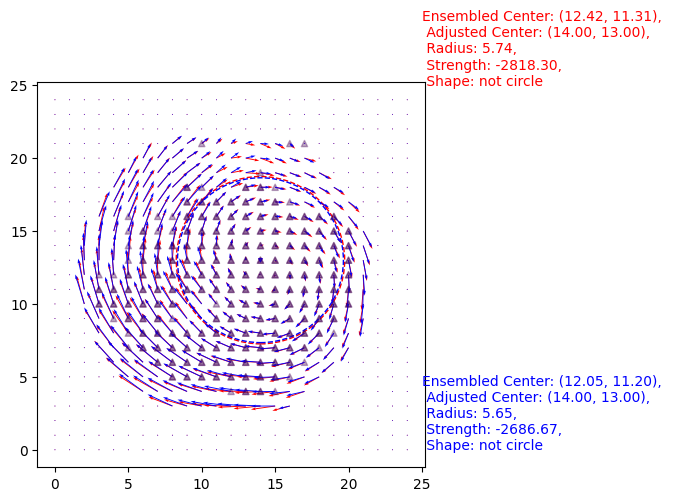

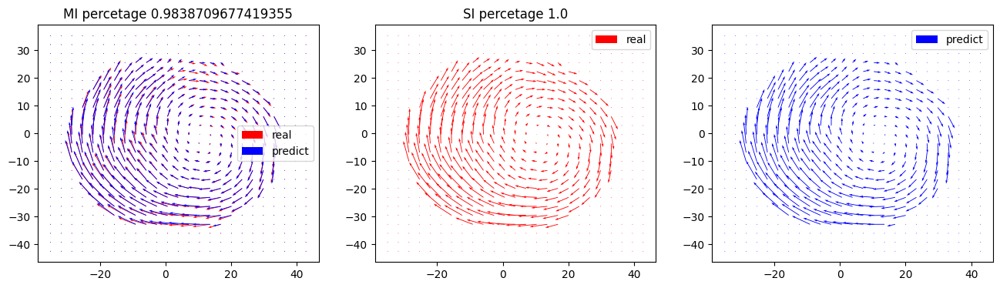

1
MI(average/percent):
0.9598021673848344 0.9903225806451613
SI(average/percent):
0.9958009098586593 1.0
2
MI(average/percent):
0.9609900356200274 0.9935483870967742
SI(average/percent):
0.9961419370690138 1.0
3
MI(average/percent):
0.9617520202643738 0.9967741935483871
SI(average/percent):
0.996296192615883 1.0
4
MI(average/percent):
0.9620114395346923 0.9967741935483871
SI(average/percent):
0.9962723204161661 1.0
5
MI(average/percent):
0.961800732321888 1.0
SI(average/percent):
0.99607451250246 1.0


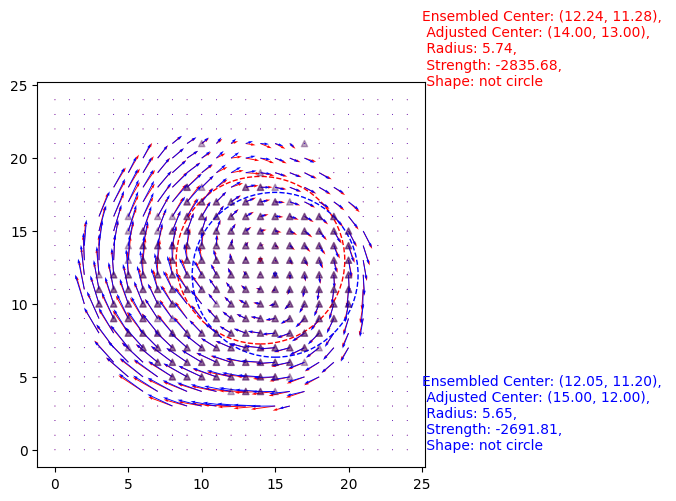

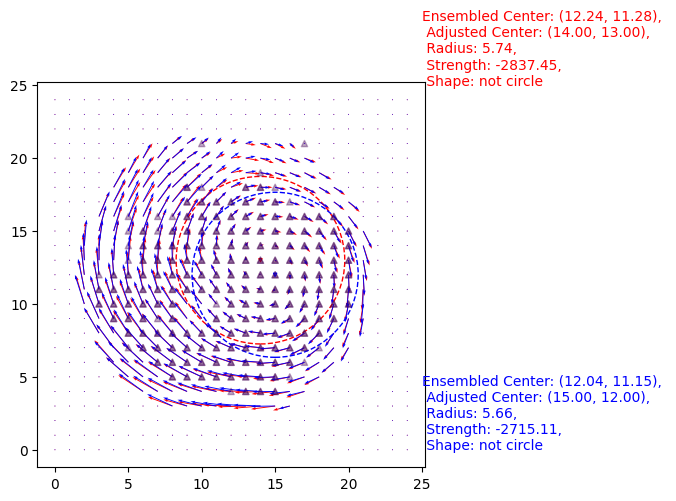

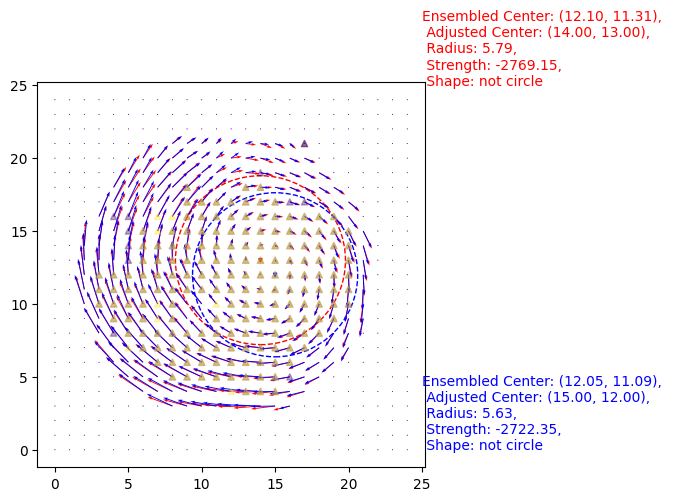

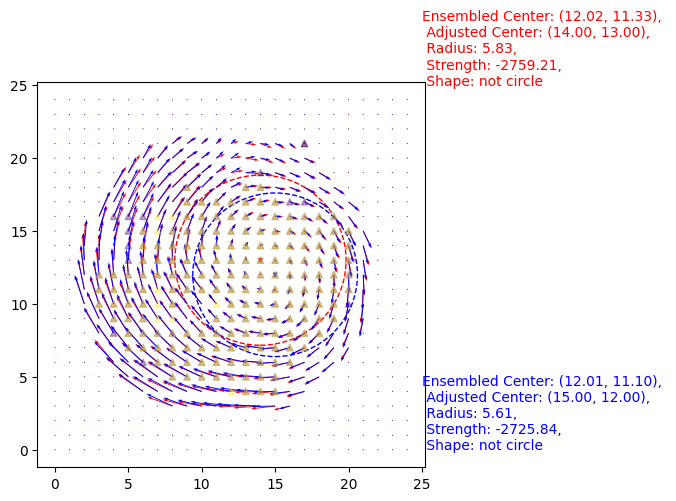

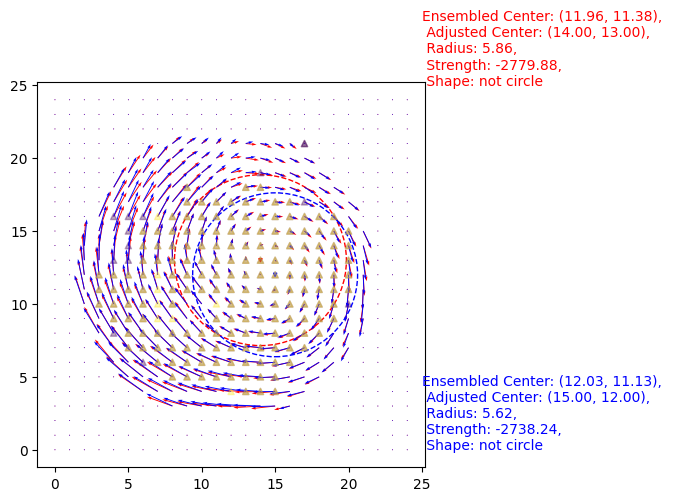

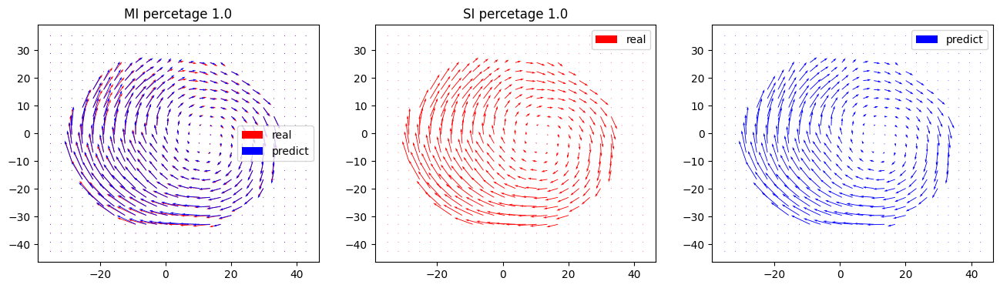

6
MI(average/percent):
0.9624225132496169 0.9935483870967742
SI(average/percent):
0.99613345945419 1.0
7
MI(average/percent):
0.961263262455899 0.9935483870967742
SI(average/percent):
0.9957776017185842 1.0
8
MI(average/percent):
0.9591352156860959 0.9935483870967742
SI(average/percent):
0.9949452369331439 1.0
9
MI(average/percent):
0.9562141183175951 0.9838709677419355
SI(average/percent):
0.9935570864844643 0.9967741935483871
10
MI(average/percent):
0.9526668540296974 0.9774193548387097
SI(average/percent):
0.9914886528335983 0.9935483870967742


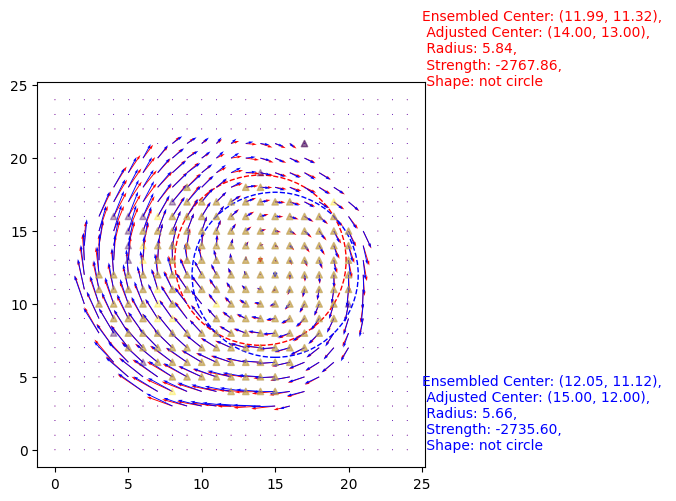

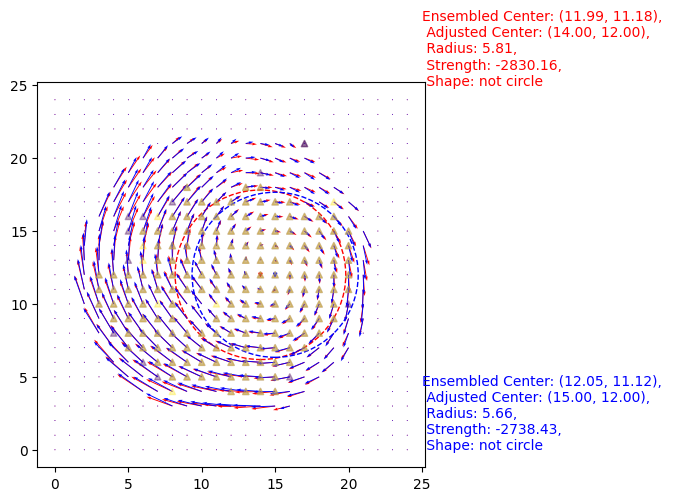

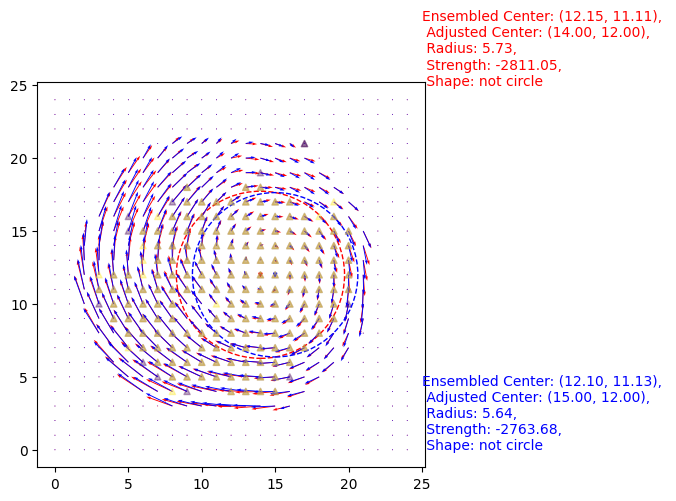

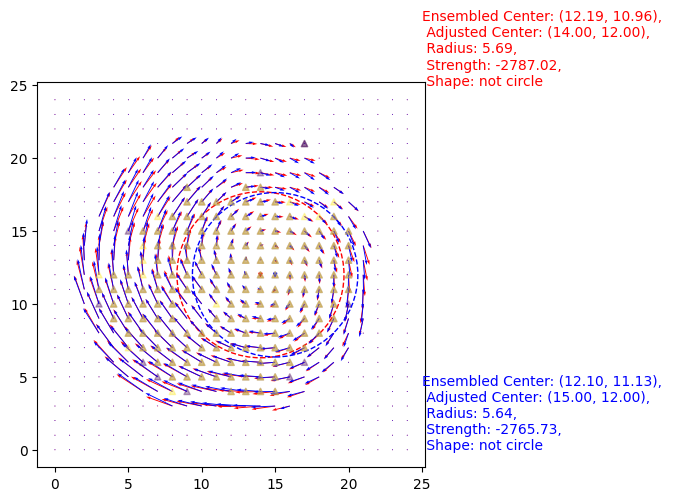

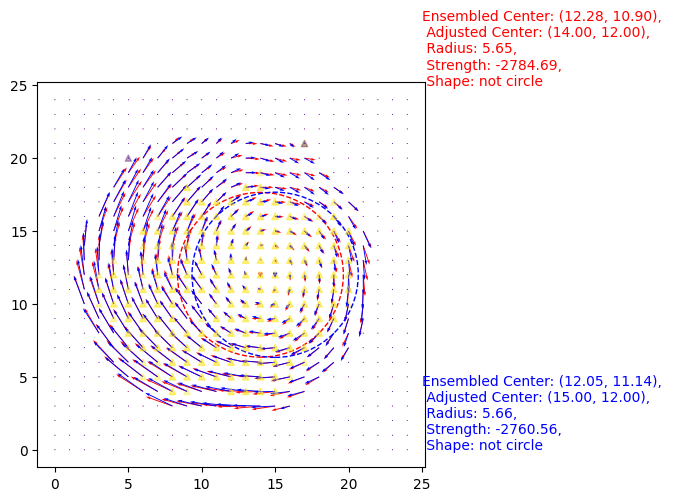

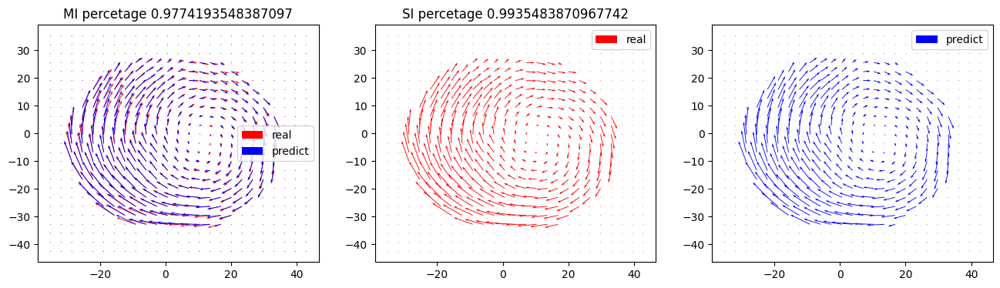

11
MI(average/percent):
0.9542101690524079 0.9838709677419355
SI(average/percent):
0.9906817411284132 0.9935483870967742
12
MI(average/percent):
0.9552763285778771 0.9838709677419355
SI(average/percent):
0.9896101117496856 0.9903225806451613
13
MI(average/percent):
0.956029912101907 0.9806451612903225
SI(average/percent):
0.9886831912166355 0.9903225806451613
14
MI(average/percent):
0.9559759965851913 0.9838709677419355
SI(average/percent):
0.9886760146632307 0.9903225806451613
15
MI(average/percent):
0.9554262856052445 0.9806451612903225
SI(average/percent):
0.9883916891123576 0.9903225806451613


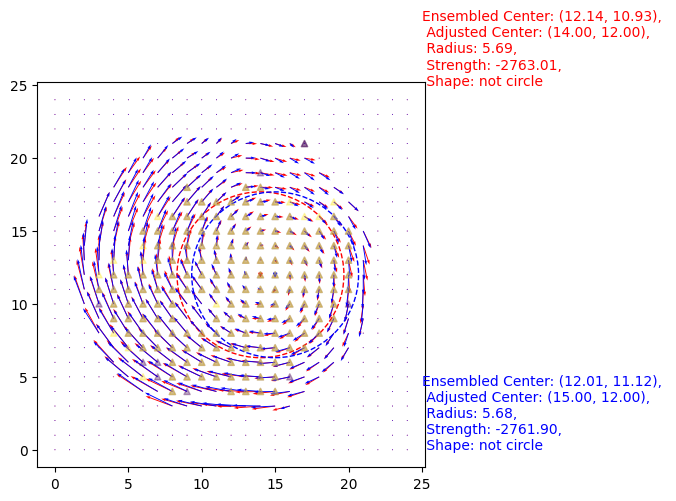

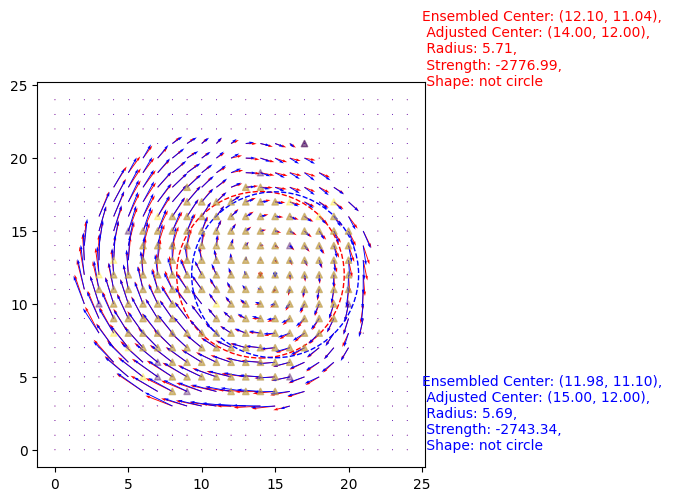

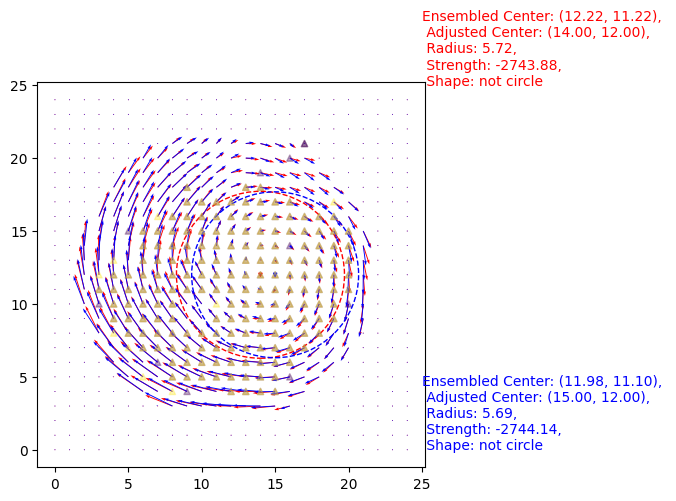

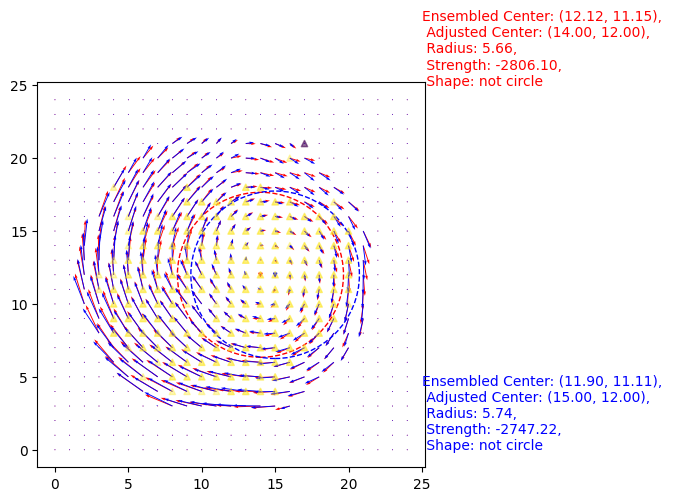

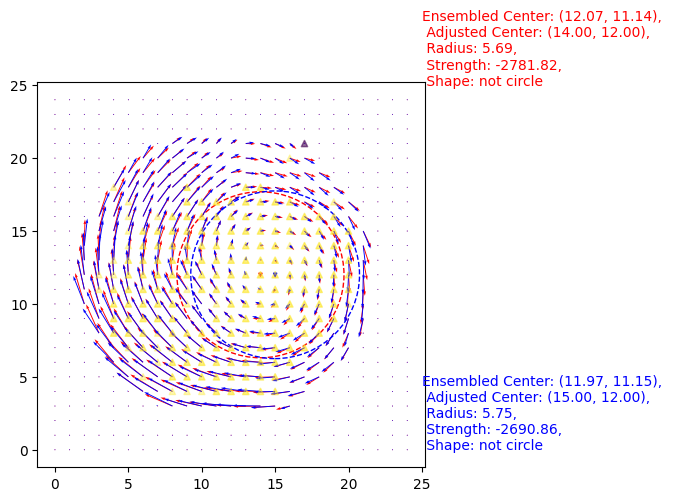

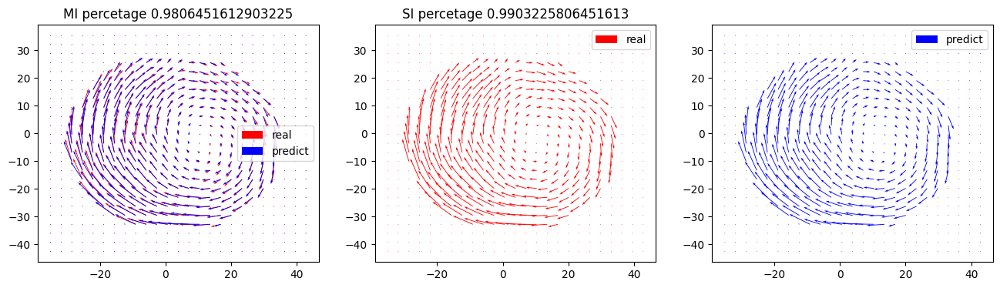

16
MI(average/percent):
0.9572825701696654 0.9838709677419355
SI(average/percent):
0.9879763969880622 0.9903225806451613
17
MI(average/percent):
0.9583528625074142 0.9870967741935484
SI(average/percent):
0.9872311539501516 0.9903225806451613
18
MI(average/percent):
0.9584817750286238 0.9838709677419355
SI(average/percent):
0.9861375800468234 0.9903225806451613
19
MI(average/percent):
0.9579123130870936 0.9838709677419355
SI(average/percent):
0.9846743649670416 0.9935483870967742
20
MI(average/percent):
0.9563892890801604 0.9838709677419355
SI(average/percent):
0.9833129883529538 0.9935483870967742


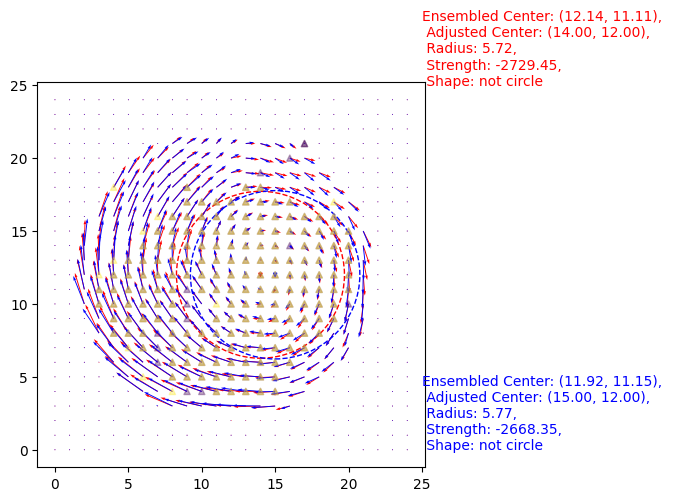

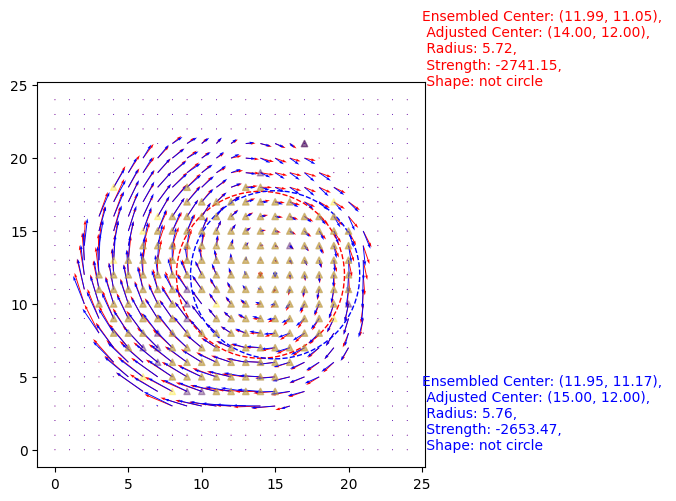

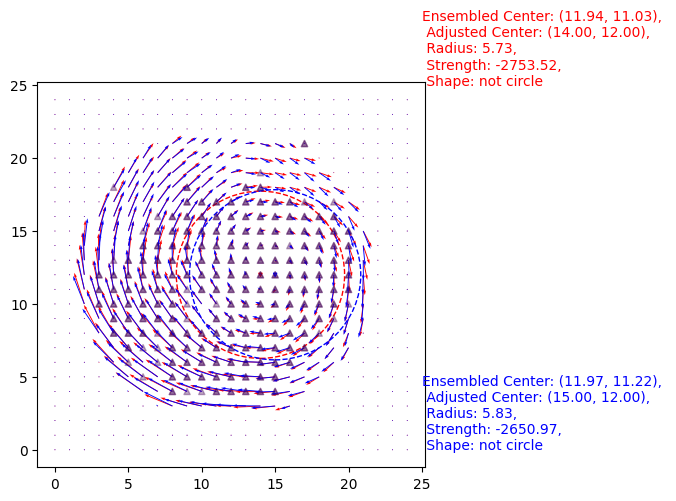

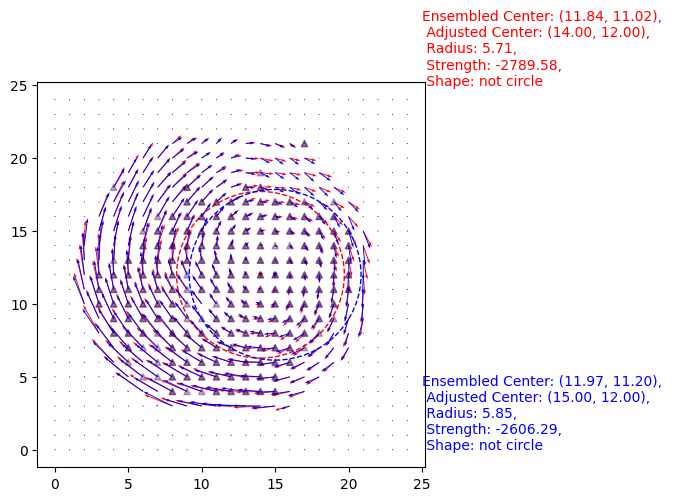

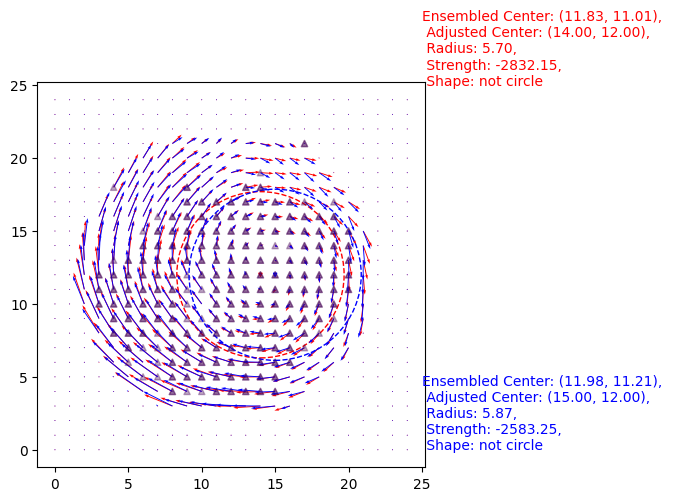

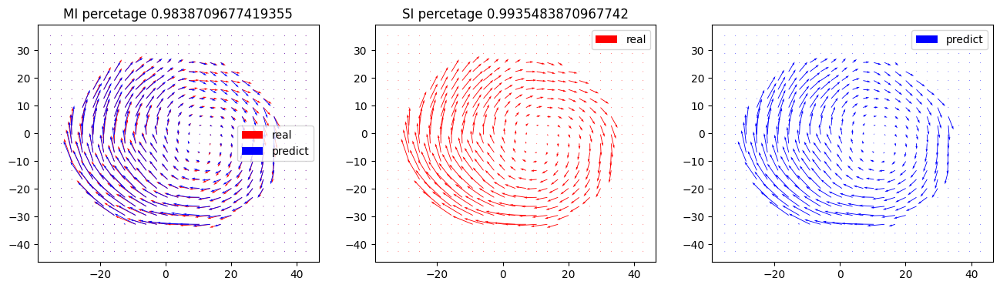

21
MI(average/percent):
0.9564563213513612 0.9838709677419355
SI(average/percent):
0.9830616208615214 0.9935483870967742
22
MI(average/percent):
0.956156778945429 0.9838709677419355
SI(average/percent):
0.9827260258613336 0.9935483870967742
23
MI(average/percent):
0.9553989480621278 0.9838709677419355
SI(average/percent):
0.9823159500491381 0.9903225806451613
24
MI(average/percent):
0.9540474709778741 0.9806451612903225
SI(average/percent):
0.9818374123490107 0.9903225806451613
25
MI(average/percent):
0.9519817060745281 0.9806451612903225
SI(average/percent):
0.9812928101747248 0.9903225806451613


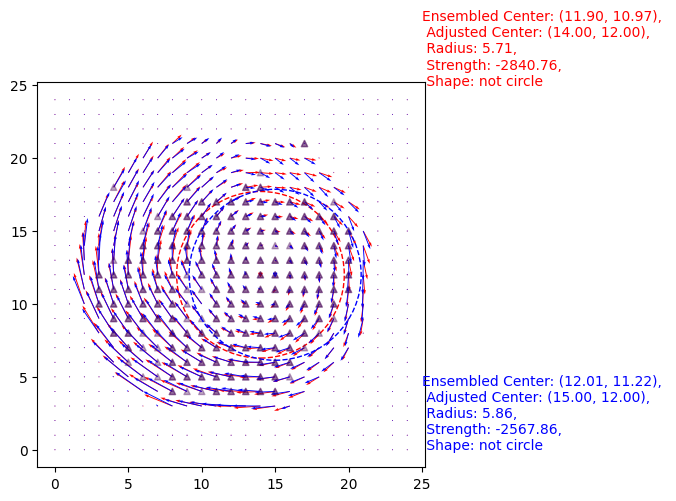

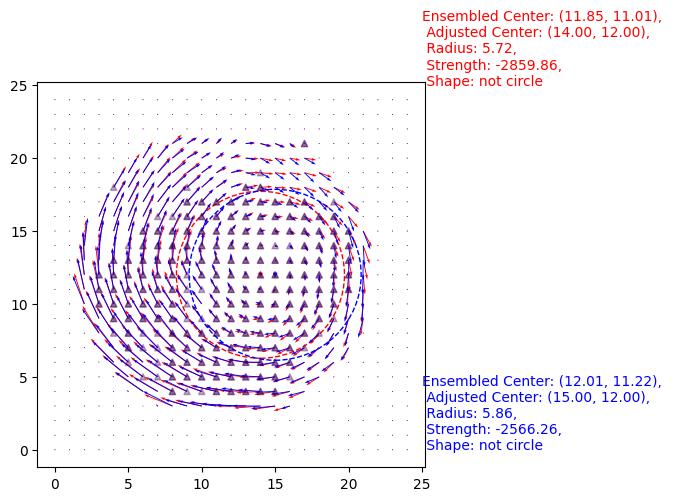

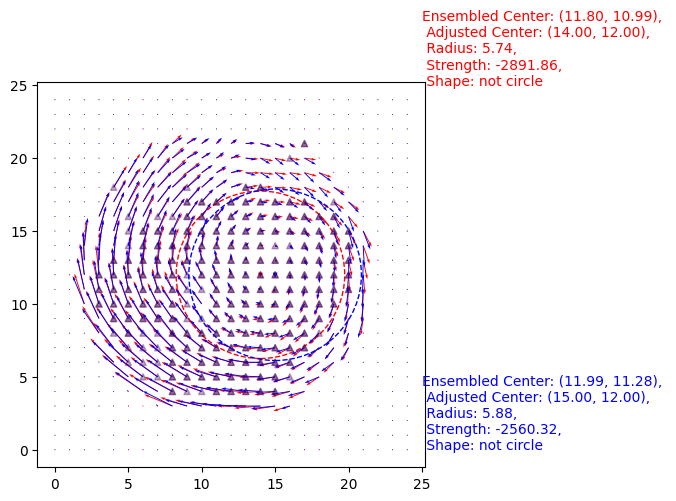

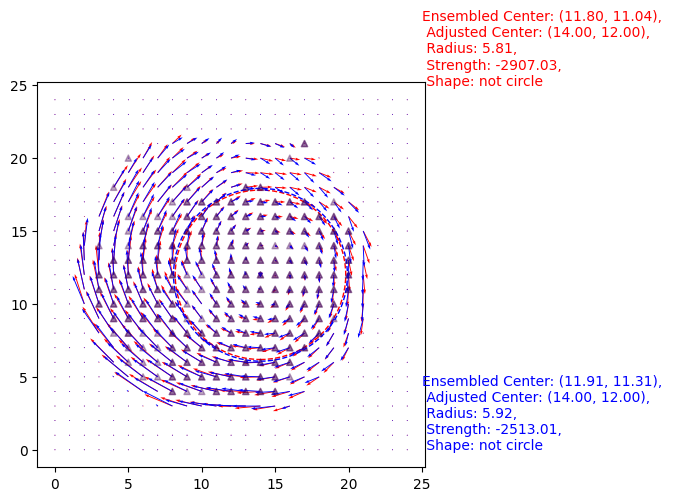

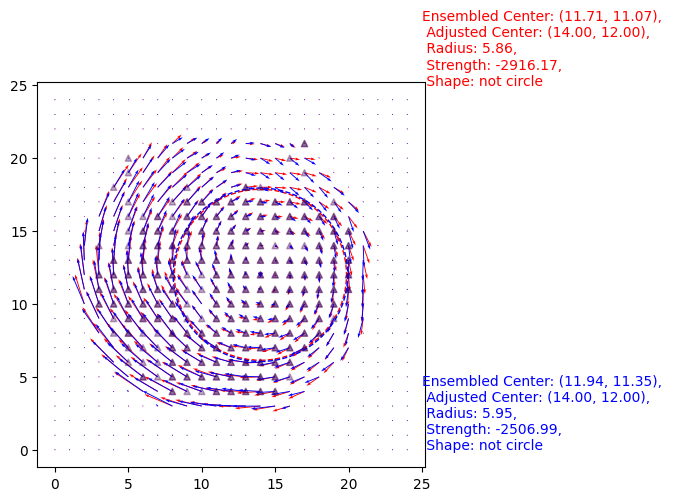

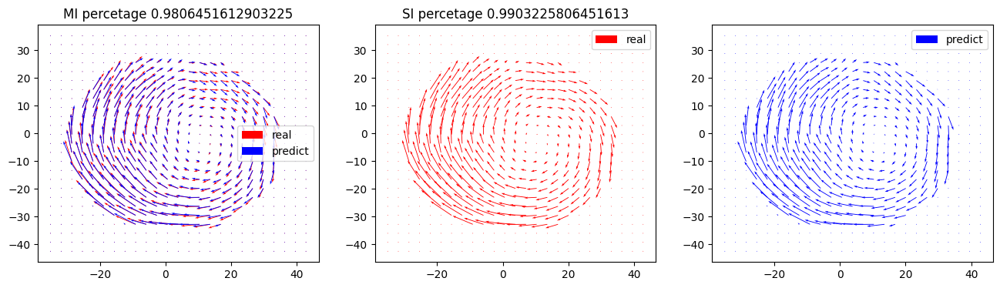

26
MI(average/percent):
0.9527340416657072 0.9806451612903225
SI(average/percent):
0.9818551991174572 0.9903225806451613
27
MI(average/percent):
0.9526695732379793 0.9838709677419355
SI(average/percent):
0.9826561177278349 0.9903225806451613
28
MI(average/percent):
0.952032320728489 0.9838709677419355
SI(average/percent):
0.9832033043880372 0.9903225806451613
29
MI(average/percent):
0.9507650975203303 0.9838709677419355
SI(average/percent):
0.9835195367438205 0.9903225806451613
30
MI(average/percent):
0.9487040104888835 0.9741935483870968
SI(average/percent):
0.98362630421632 0.9903225806451613


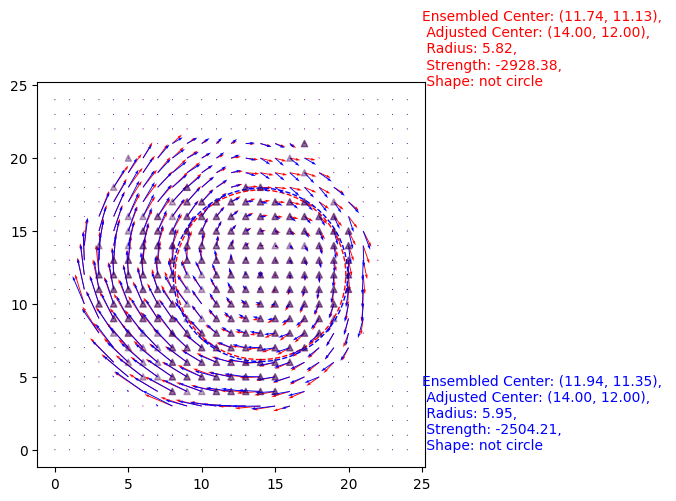

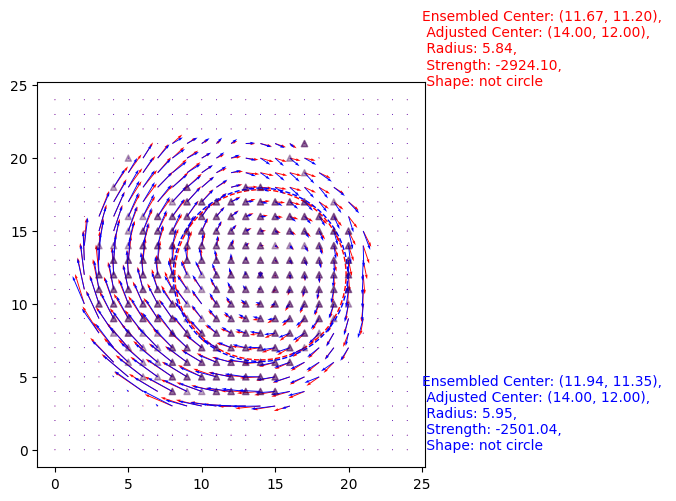

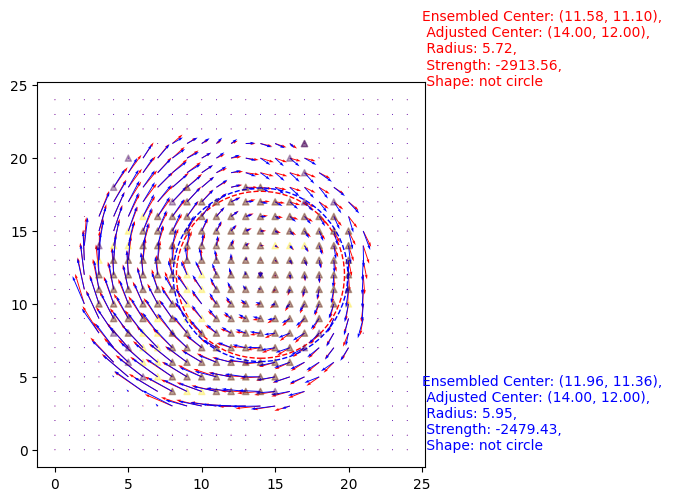

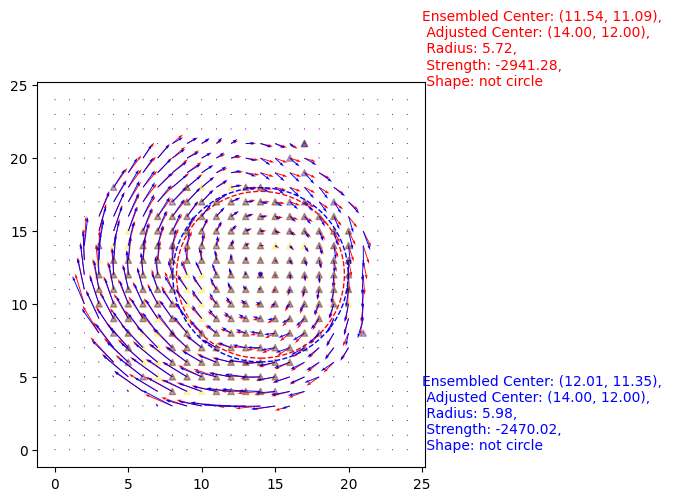

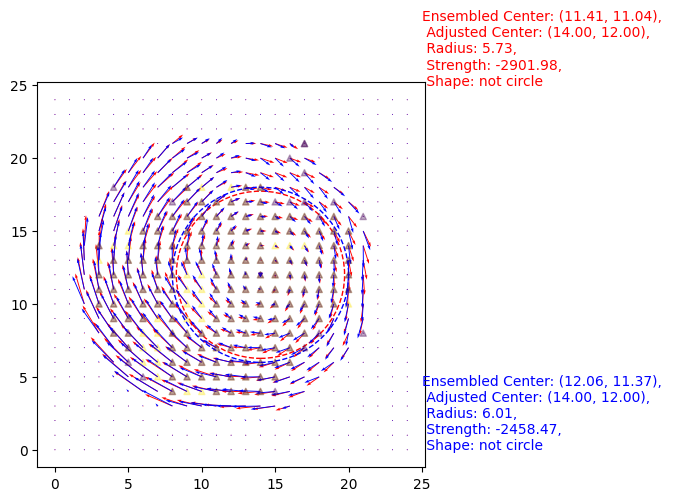

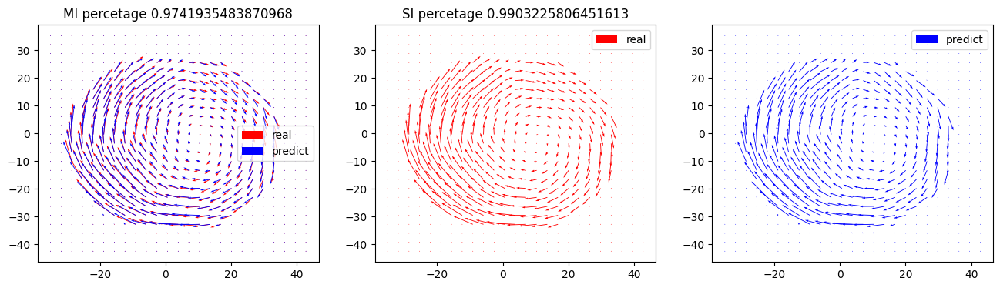

31
MI(average/percent):
0.9487066921237067 0.9774193548387097
SI(average/percent):
0.9830614304807068 0.9903225806451613
32
MI(average/percent):
0.9479909376025987 0.9806451612903225
SI(average/percent):
0.9822183565449516 0.9903225806451613
33
MI(average/percent):
0.9463667984215893 0.9806451612903225
SI(average/percent):
0.9811304603761631 0.9903225806451613
34
MI(average/percent):
0.9438077755238412 0.9774193548387097
SI(average/percent):
0.979810469455854 0.9870967741935484
35
MI(average/percent):
0.9407502763301657 0.964516129032258
SI(average/percent):
0.9782603273047967 0.9870967741935484


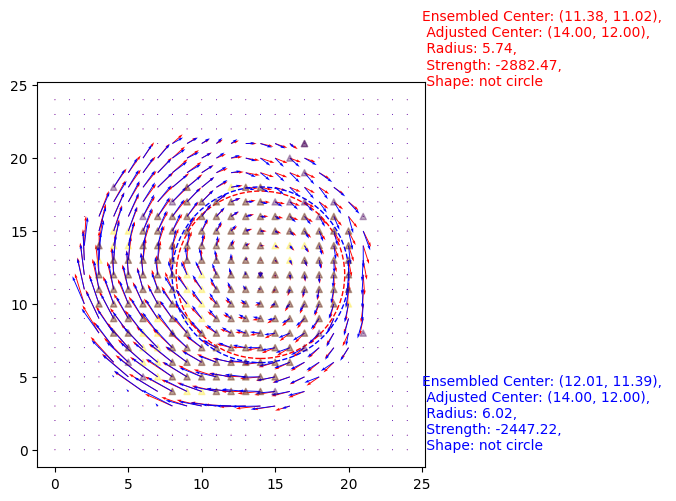

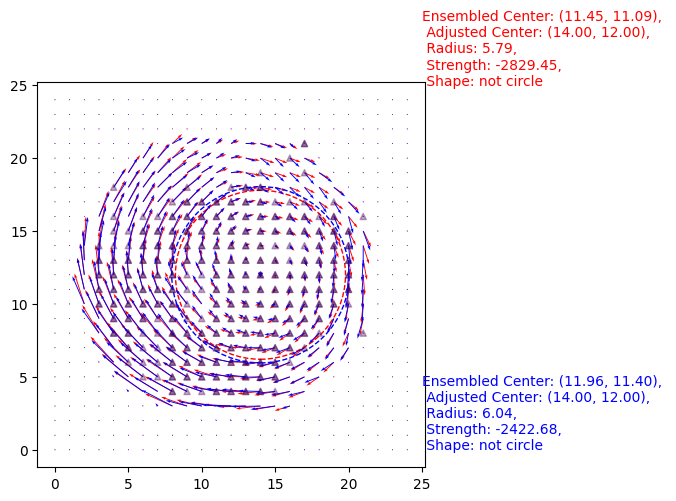

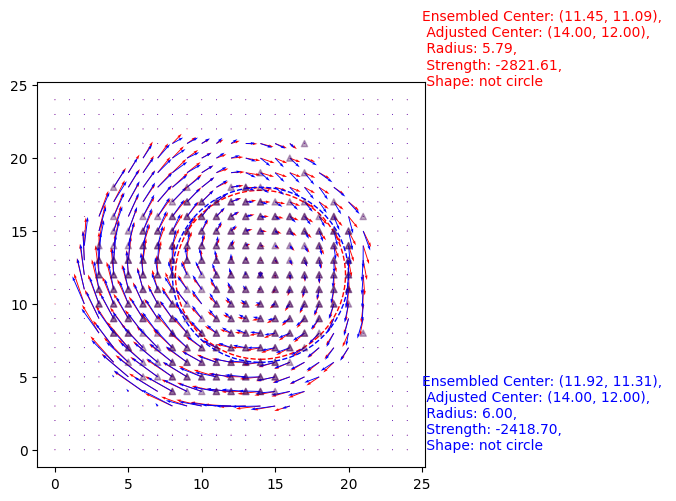

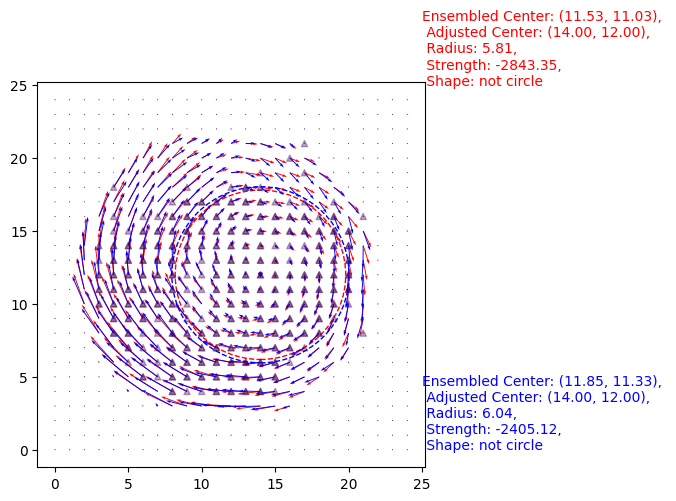

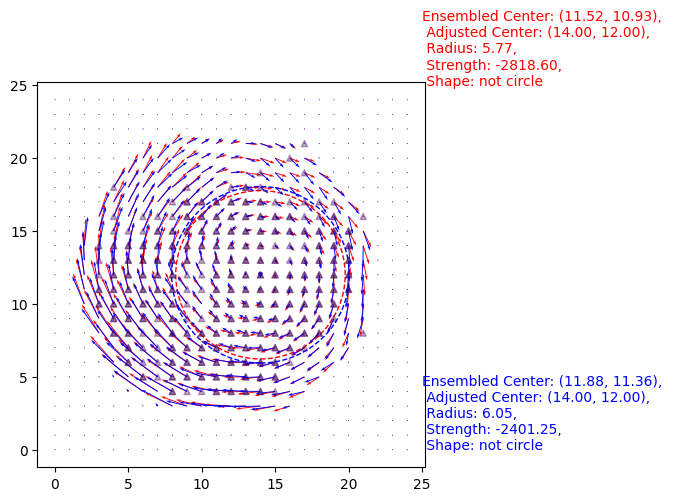

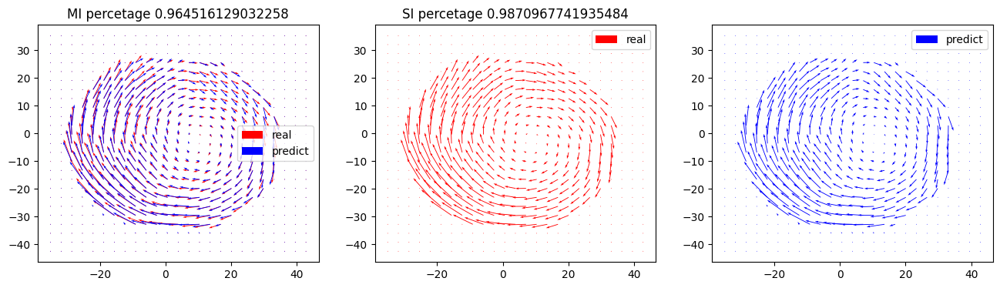

36
MI(average/percent):
0.9383173535911215 0.9580645161290322
SI(average/percent):
0.9780073215094549 0.9870967741935484
37
MI(average/percent):
0.9356771240374973 0.9580645161290322
SI(average/percent):
0.9774309832746643 0.9870967741935484
38
MI(average/percent):
0.9328422324505459 0.9580645161290322
SI(average/percent):
0.9765630950561767 0.9838709677419355
39
MI(average/percent):
0.9295323053827479 0.9419354838709677
SI(average/percent):
0.9723054796893594 0.9806451612903225
40
MI(average/percent):
0.9272092816164181 0.9419354838709677
SI(average/percent):
0.9741682904076024 0.9774193548387097


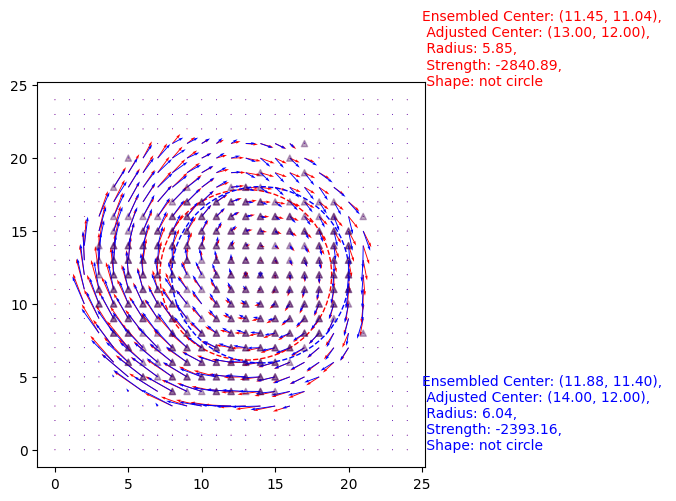

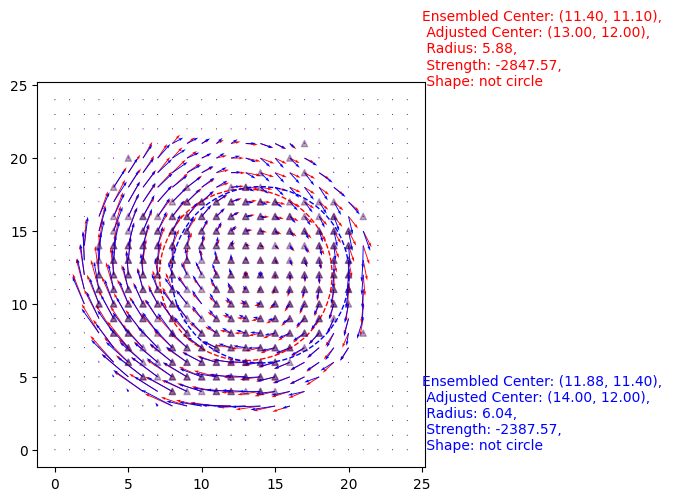

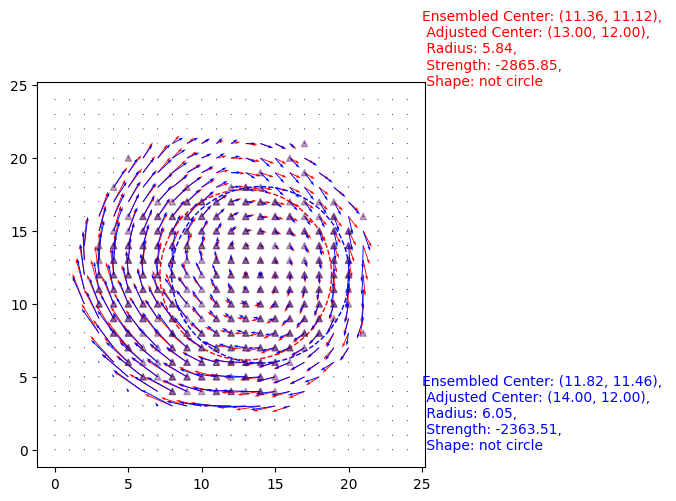

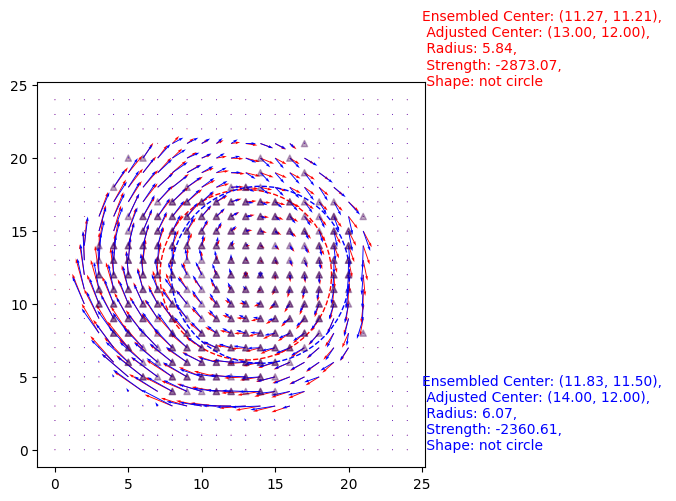

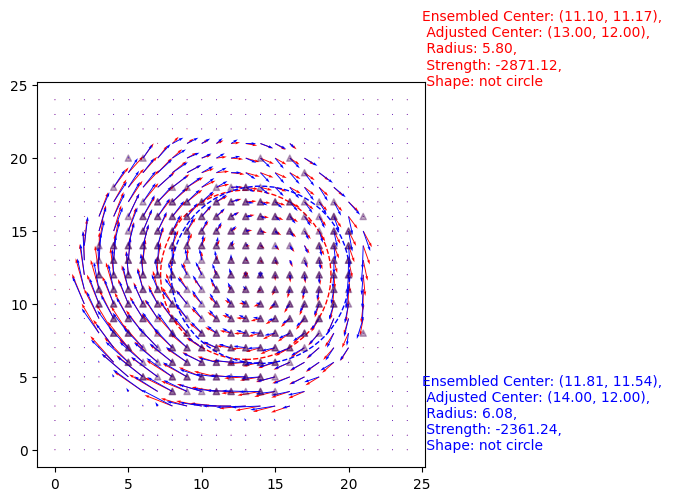

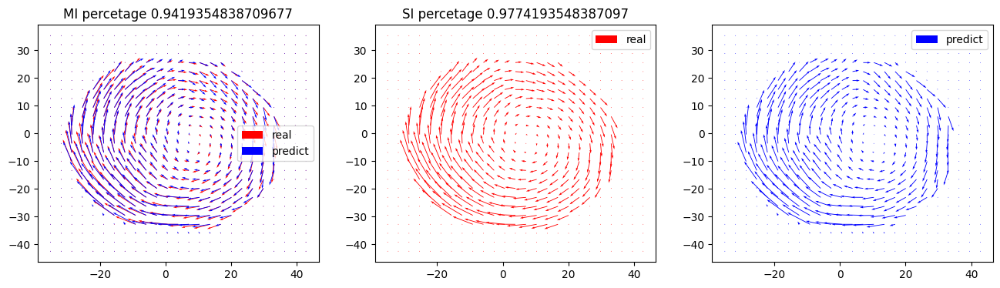

41
MI(average/percent):
0.9257780803332009 0.9387096774193548
SI(average/percent):
0.973012200347628 0.9741935483870968
42
MI(average/percent):
0.9238150002668414 0.932258064516129
SI(average/percent):
0.9714788842955548 0.967741935483871
43
MI(average/percent):
0.9211245376576767 0.9258064516129032
SI(average/percent):
0.9695108243391406 0.967741935483871
44
MI(average/percent):
0.9178974429489216 0.9161290322580645
SI(average/percent):
0.9670321116094373 0.964516129032258
45
MI(average/percent):
0.9142675325609928 0.9225806451612903
SI(average/percent):
0.9641568956412531 0.9612903225806452


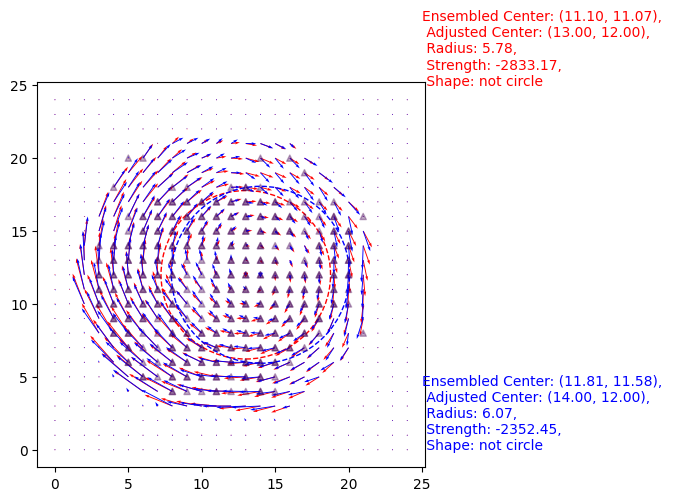

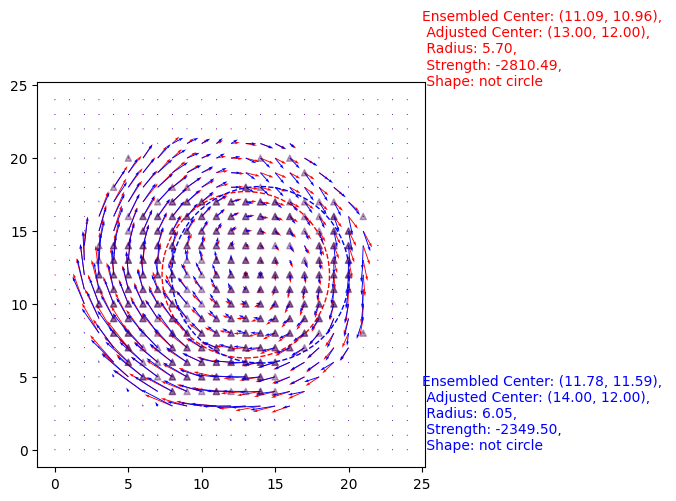

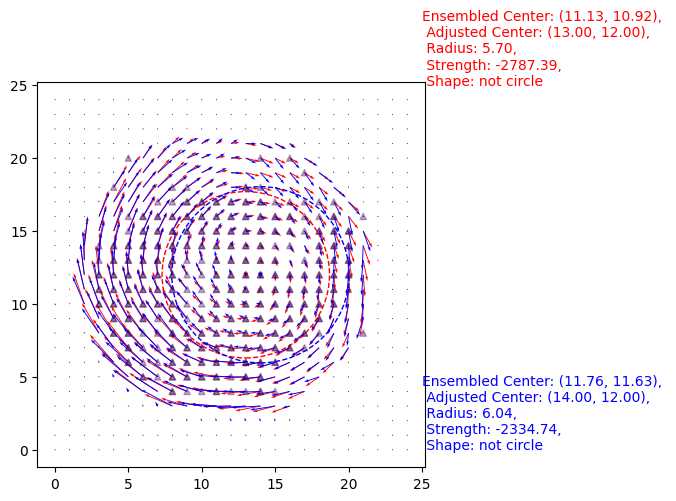

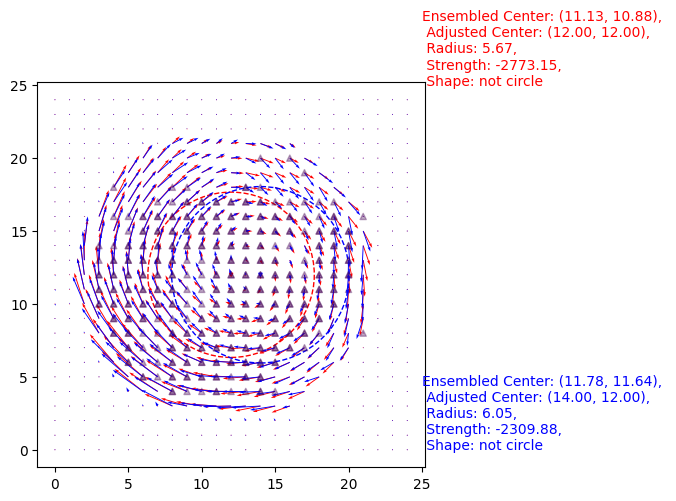

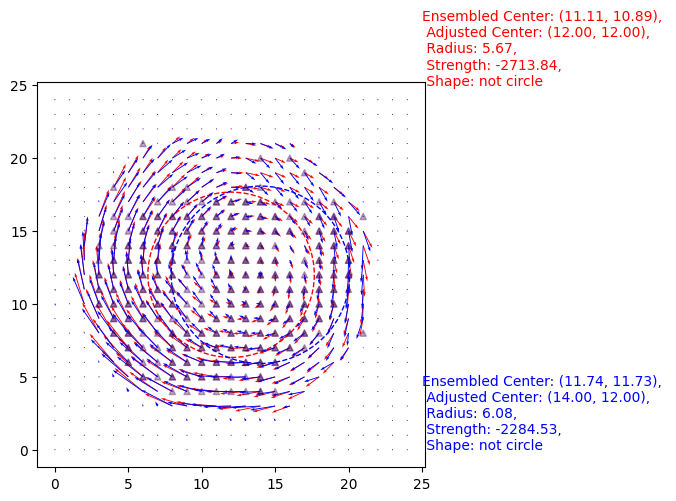

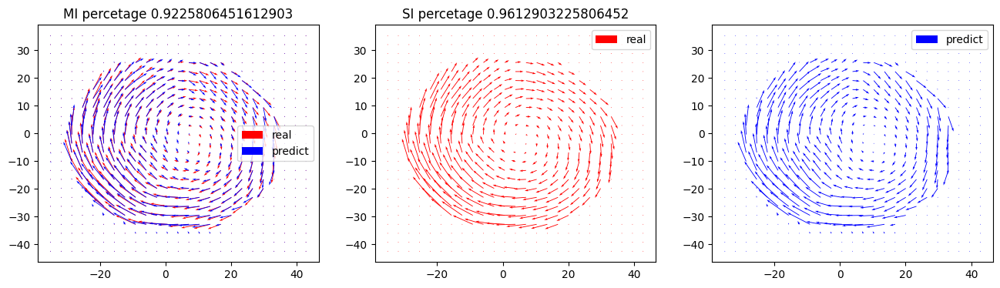

46
MI(average/percent):
0.9144736767779722 0.9193548387096774
SI(average/percent):
0.9626647334165632 0.9612903225806452
47
MI(average/percent):
0.9142862198135335 0.9064516129032258
SI(average/percent):
0.9607877495777435 0.9612903225806452
48
MI(average/percent):
0.9137732285978482 0.9064516129032258
SI(average/percent):
0.9586189333849336 0.9612903225806452
49
MI(average/percent):
0.9128821260025081 0.9032258064516129
SI(average/percent):
0.9560956915269171 0.9612903225806452
50
MI(average/percent):
0.9115510784761172 0.9064516129032258
SI(average/percent):
0.9534911353733952 0.9548387096774194


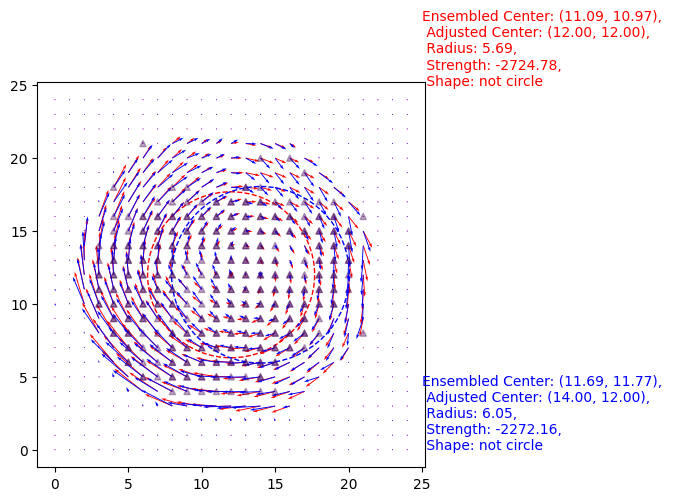

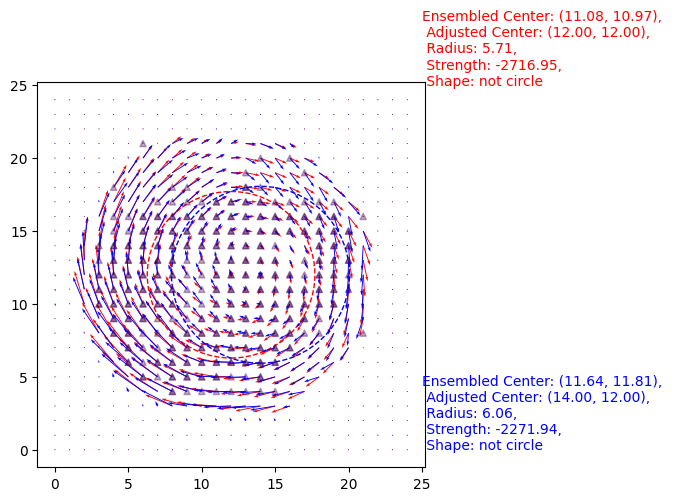

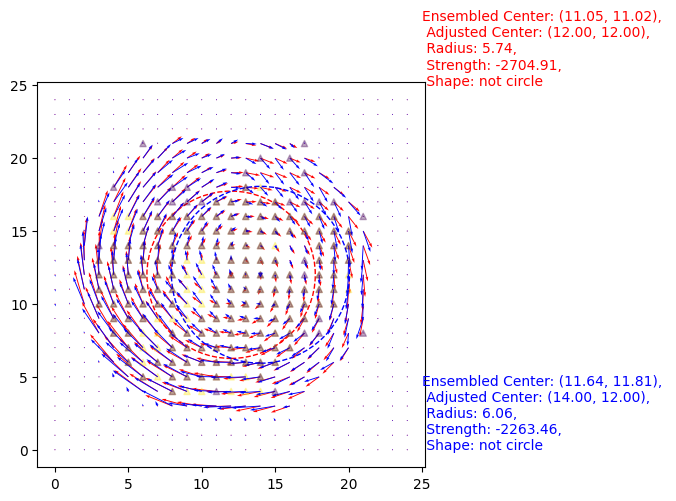

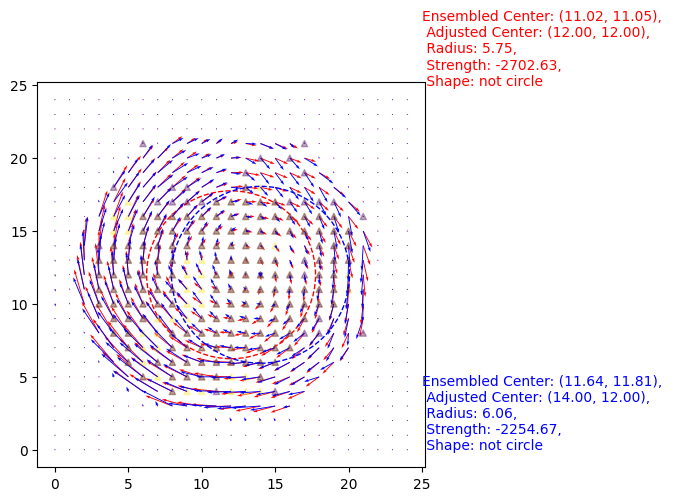

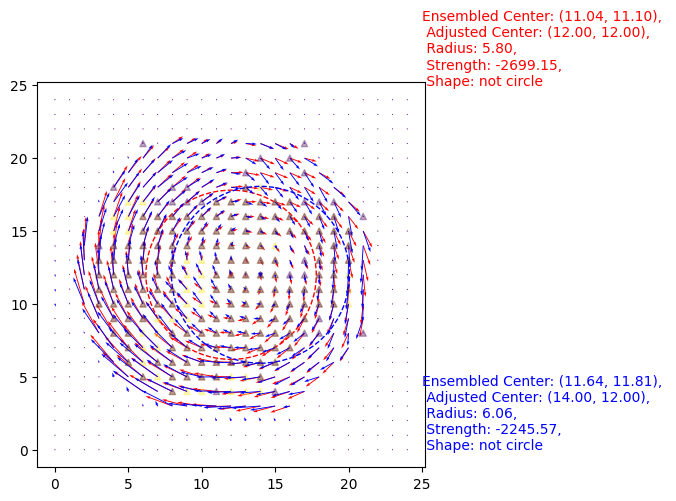

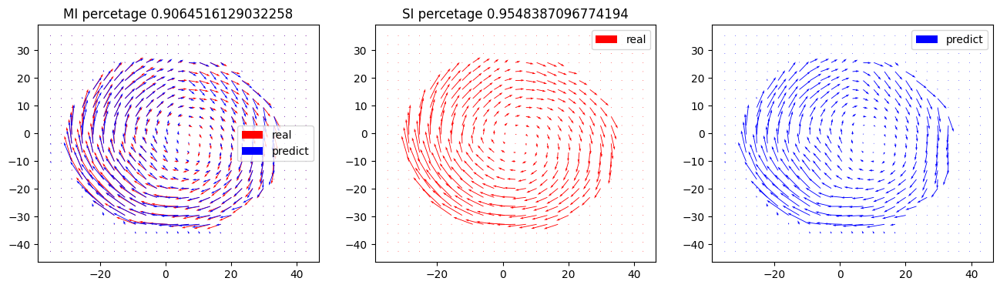

51
MI(average/percent):
0.9107815773123904 0.9064516129032258
SI(average/percent):
0.9548668132077314 0.9580645161290322
52
MI(average/percent):
0.9099213893246888 0.9032258064516129
SI(average/percent):
0.955207266020111 0.9516129032258065
53
MI(average/percent):
0.9089632190729909 0.9032258064516129
SI(average/percent):
0.9547059501188628 0.9483870967741935
54
MI(average/percent):
0.9079557565879929 0.9
SI(average/percent):
0.9538417981598631 0.9483870967741935
55
MI(average/percent):
0.9067745654058454 0.9
SI(average/percent):
0.953041868608991 0.9483870967741935


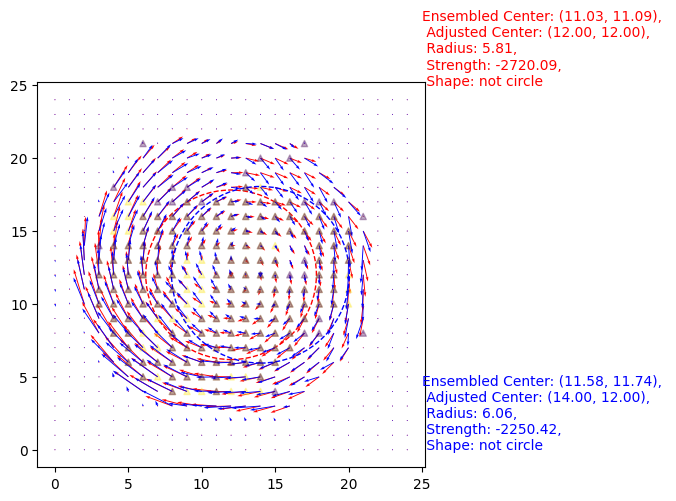

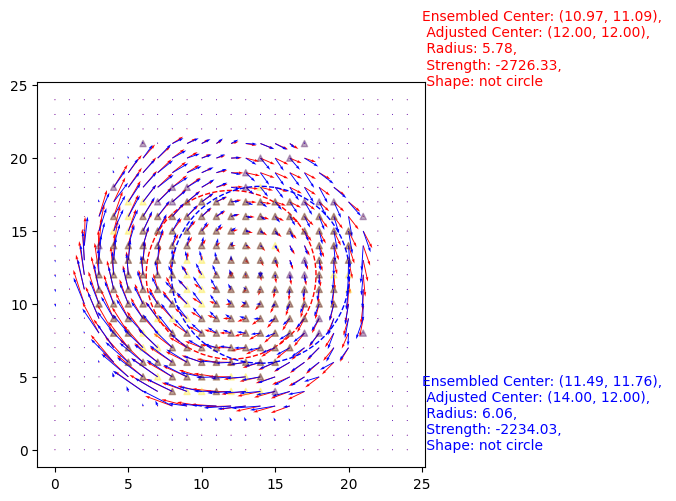

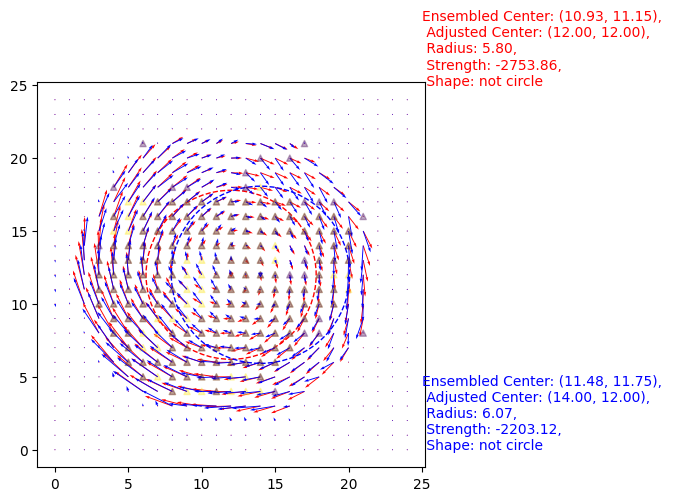

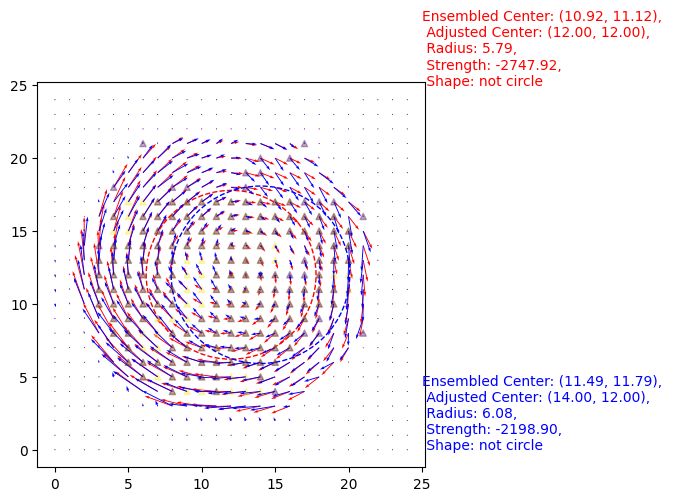

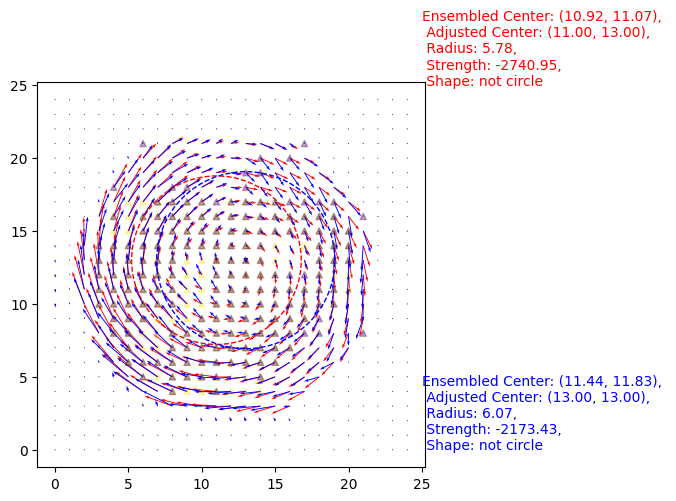

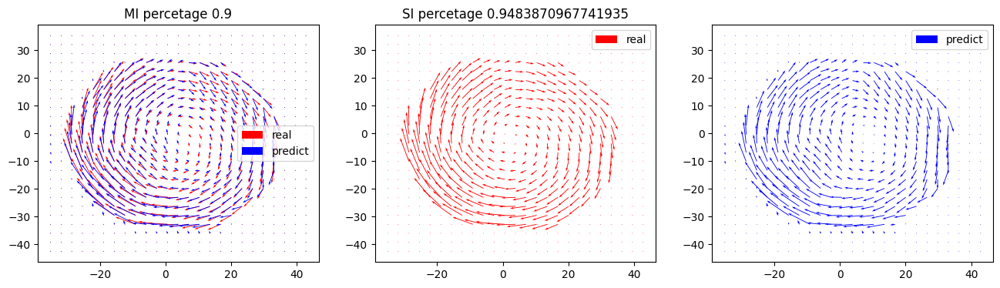

56
MI(average/percent):
0.9052796819127132 0.8935483870967742
SI(average/percent):
0.9519969084434478 0.9451612903225807
57
MI(average/percent):
0.9037071448432206 0.8935483870967742
SI(average/percent):
0.950511873306289 0.9483870967741935
58
MI(average/percent):
0.9020740960272934 0.8903225806451613
SI(average/percent):
0.948525505999099 0.9483870967741935
59
MI(average/percent):
0.9003447678709146 0.8806451612903226
SI(average/percent):
0.9460289590520563 0.9451612903225807
60
MI(average/percent):
0.8984329803885577 0.8774193548387097
SI(average/percent):
0.9438506734571904 0.9451612903225807


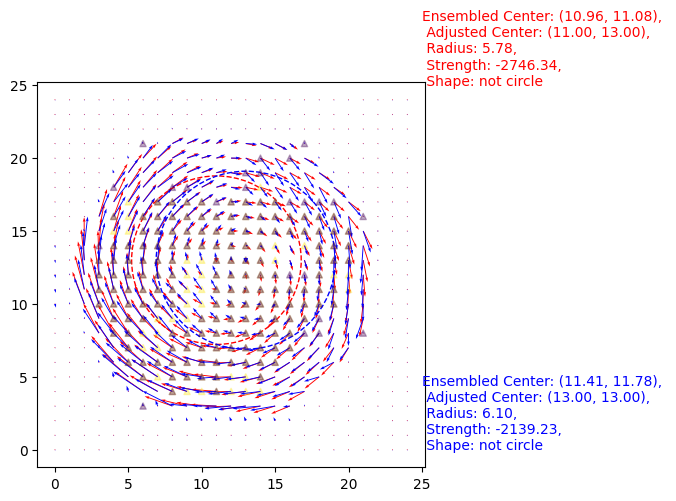

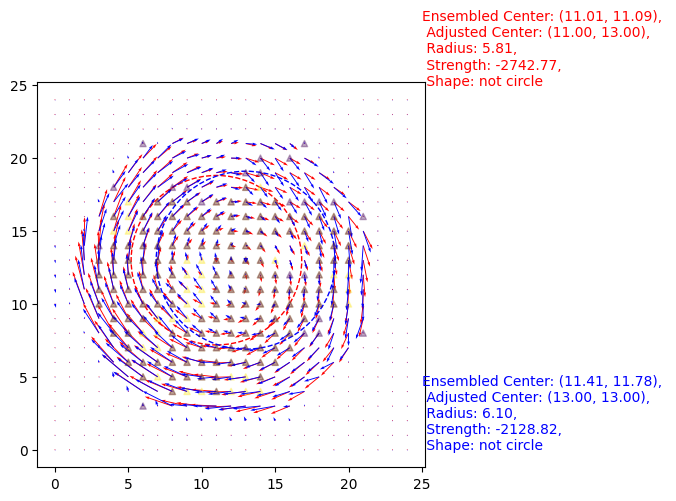

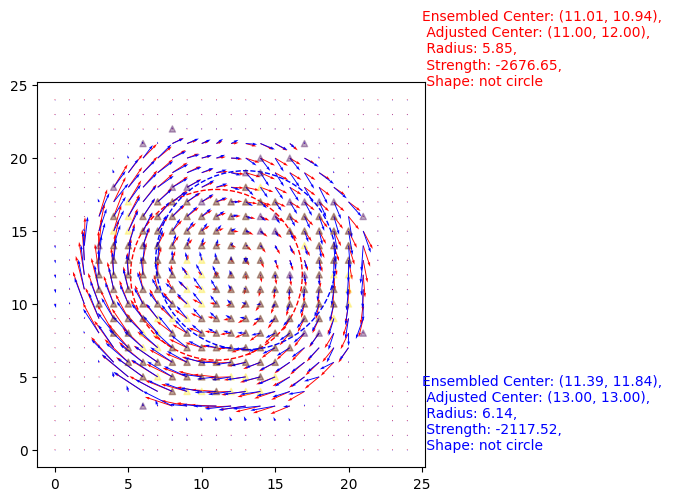

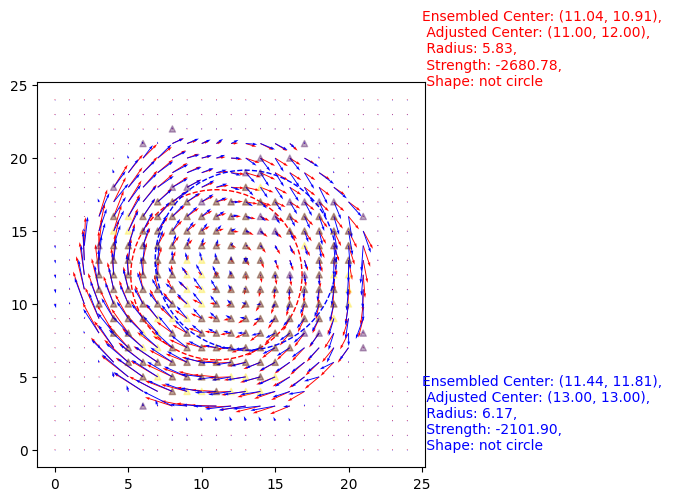

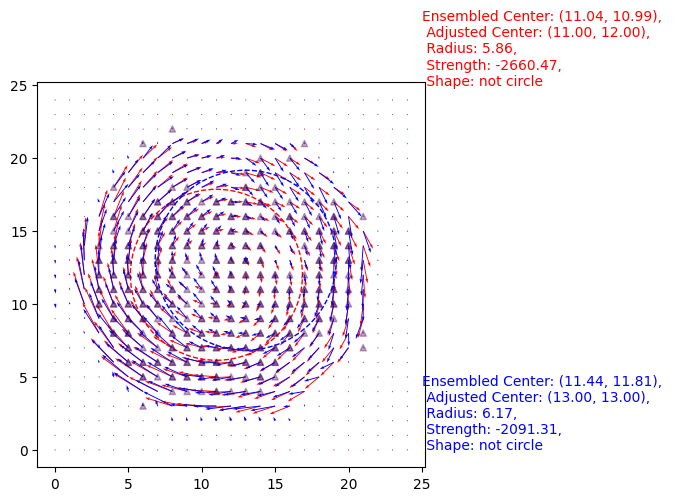

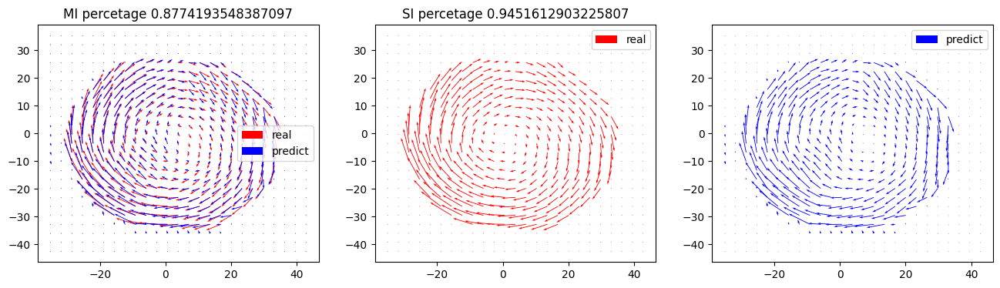

61
MI(average/percent):
0.898424032971052 0.8709677419354839
SI(average/percent):
0.9425100122674462 0.9419354838709677
62
MI(average/percent):
0.8980441776241271 0.8806451612903226
SI(average/percent):
0.9407582304874694 0.9354838709677419
63
MI(average/percent):
0.8976719016302116 0.8838709677419355
SI(average/percent):
0.9397809308387401 0.932258064516129
64
MI(average/percent):
0.8971739657907548 0.8838709677419355
SI(average/percent):
0.9382671394616026 0.932258064516129
65
MI(average/percent):
0.896331791589581 0.8806451612903226
SI(average/percent):
0.9361436960572711 0.9225806451612903


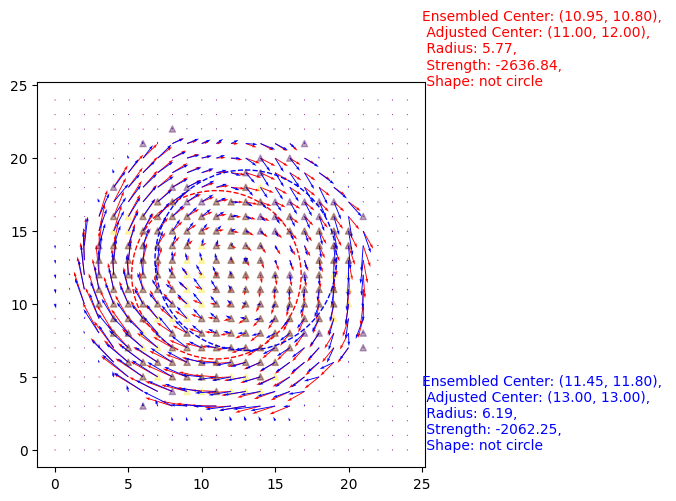

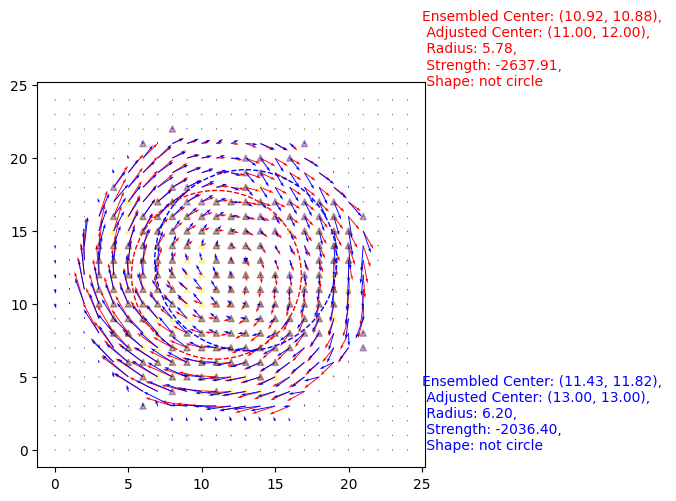

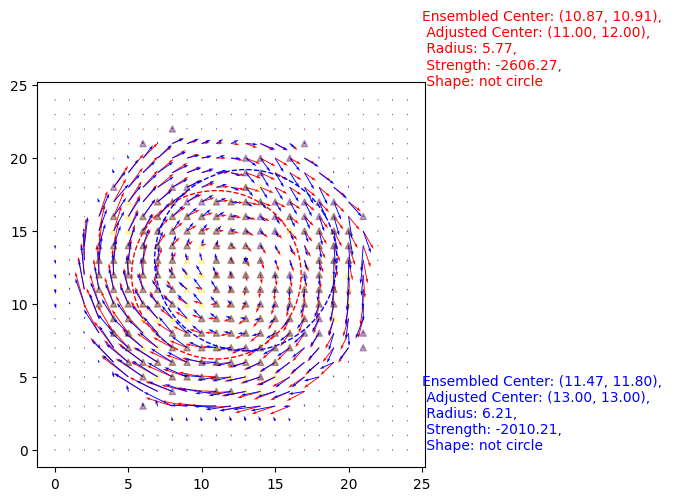

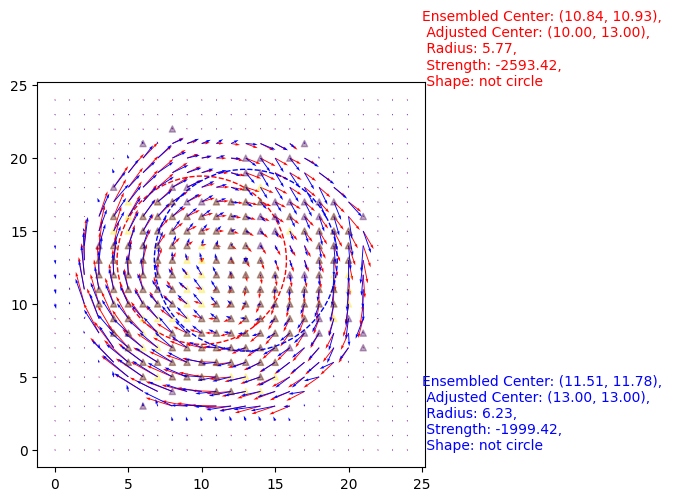

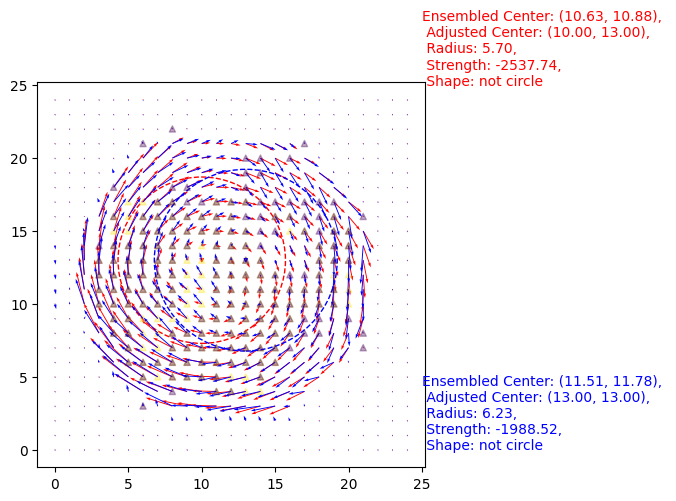

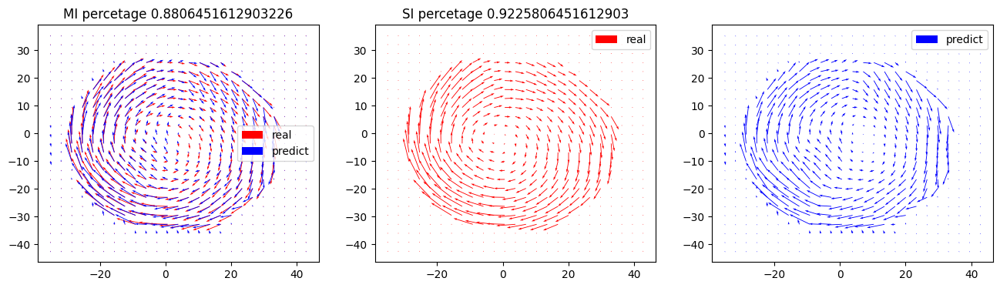

66
MI(average/percent):
0.8949603581037086 0.8806451612903226
SI(average/percent):
0.9322649497078096 0.9161290322580645
67
MI(average/percent):
0.893446390327668 0.8774193548387097
SI(average/percent):
0.9310726785990358 0.9096774193548387
68
MI(average/percent):
0.8919746654639495 0.8741935483870967
SI(average/percent):
0.9288552731084551 0.9096774193548387
69
MI(average/percent):
0.8901025459836452 0.8709677419354839
SI(average/percent):
0.9251507018887288 0.9064516129032258
70
MI(average/percent):
0.8880463338339314 0.8580645161290322
SI(average/percent):
0.9214475550718875 0.9032258064516129


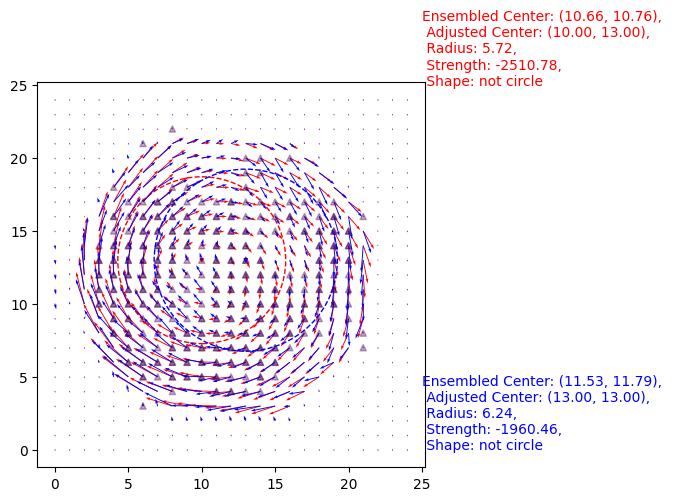

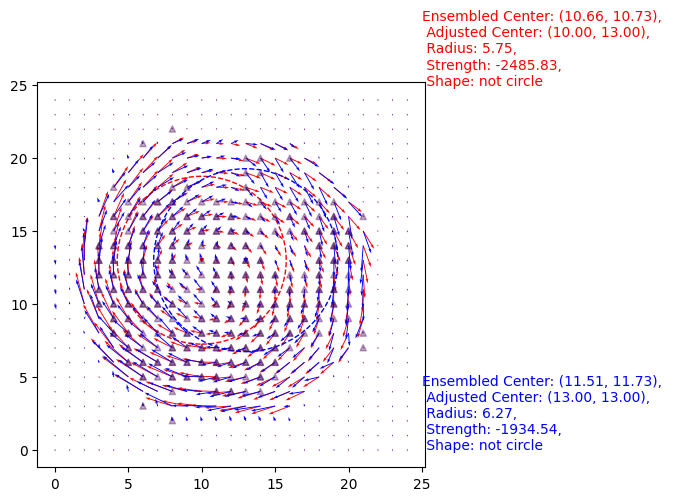

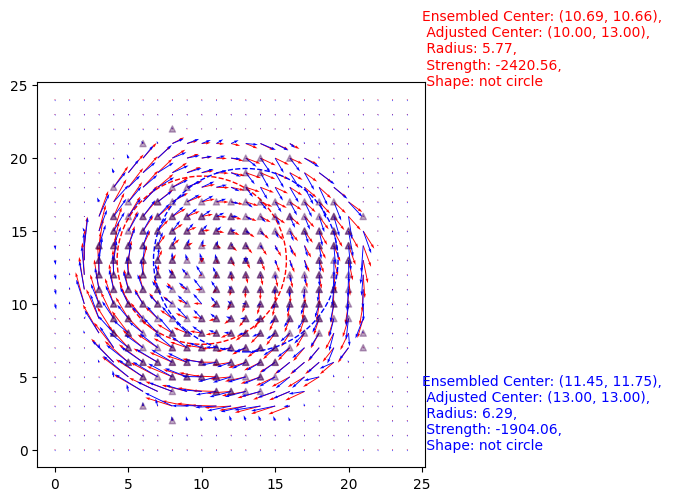

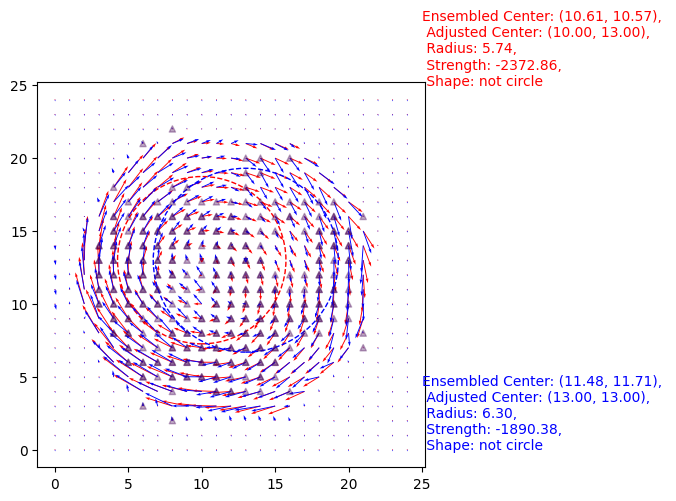

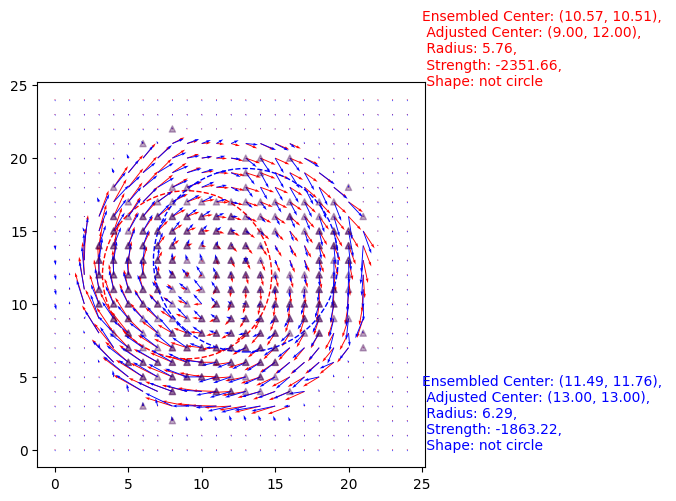

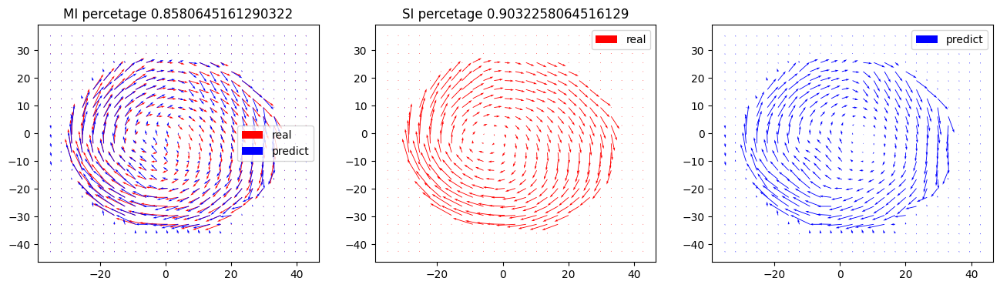

71
MI(average/percent):
0.8868059041741608 0.8612903225806452
SI(average/percent):
0.92085491245121 0.9096774193548387
72
MI(average/percent):
0.885673727907501 0.8580645161290322
SI(average/percent):
0.9209070651564172 0.9032258064516129
73
MI(average/percent):
0.8843866212211263 0.8580645161290322
SI(average/percent):
0.9214516846336803 0.9
74
MI(average/percent):
0.8830406621164362 0.8580645161290322
SI(average/percent):
0.9215552795669886 0.9032258064516129
75
MI(average/percent):
0.8813684951347119 0.8516129032258064
SI(average/percent):
0.9210340872795166 0.9032258064516129


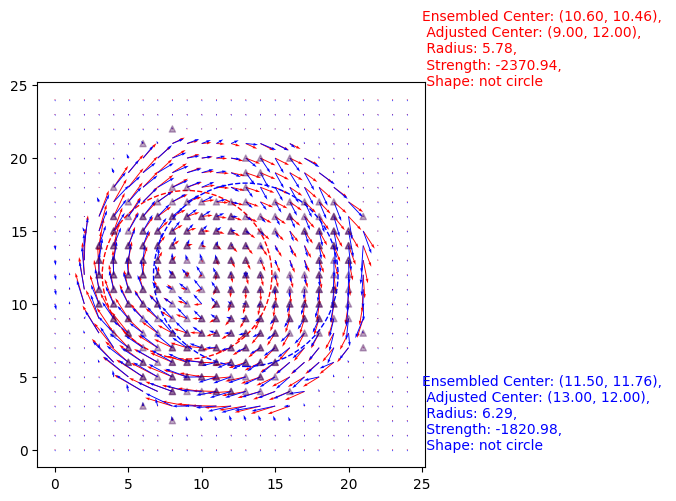

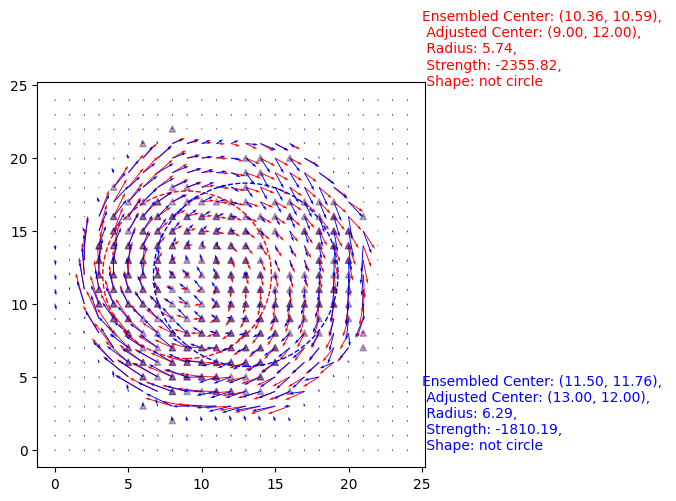

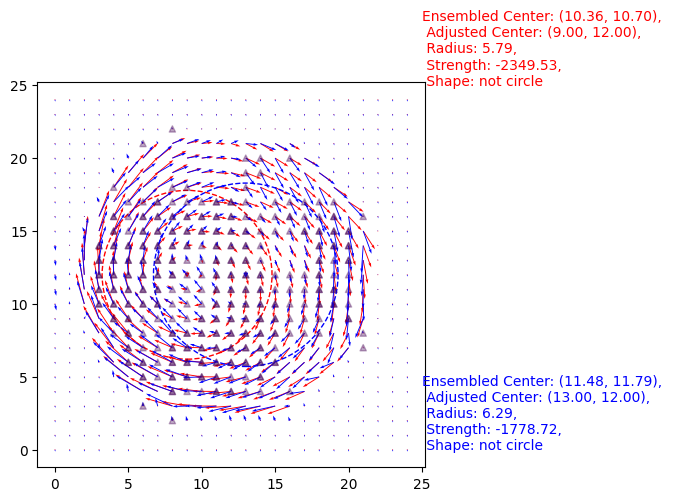

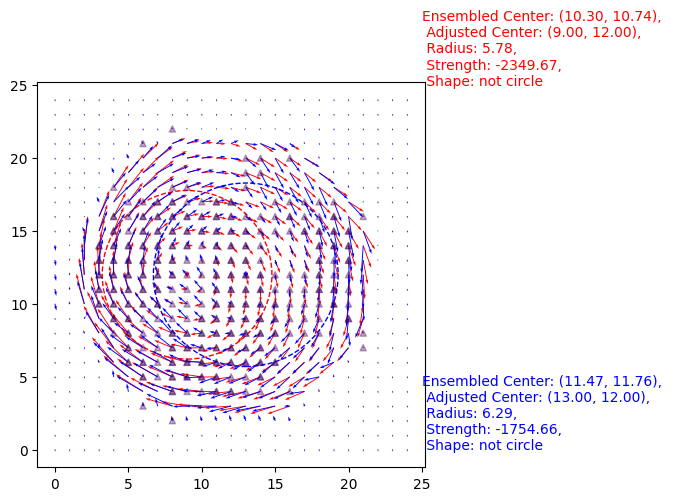

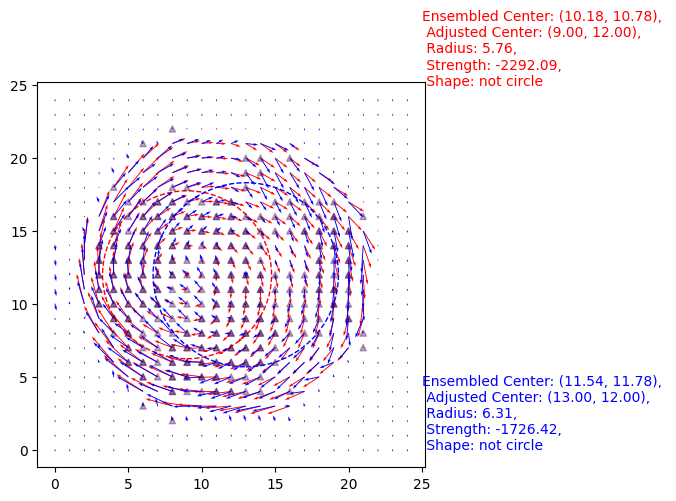

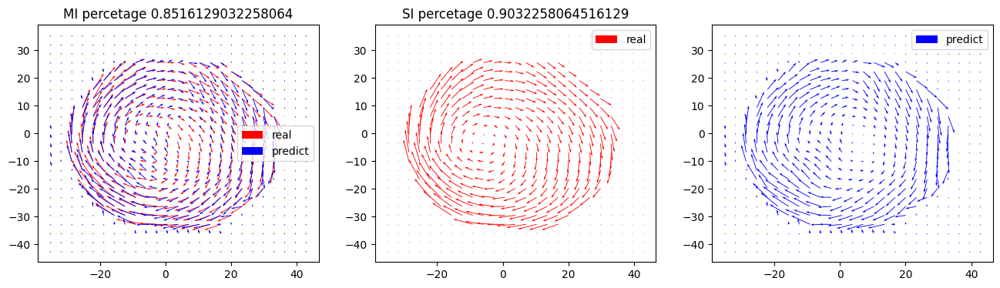

76
MI(average/percent):
0.8810954613811226 0.8483870967741935
SI(average/percent):
0.9207328547438198 0.9064516129032258
77
MI(average/percent):
0.8807684078779549 0.8516129032258064
SI(average/percent):
0.9202786646633903 0.9
78
MI(average/percent):
0.8803501976642456 0.8516129032258064
SI(average/percent):
0.9203270283423357 0.896774193548387
79
MI(average/percent):
0.879443161491083 0.8387096774193549
SI(average/percent):
0.9200014583312406 0.8935483870967742
80
MI(average/percent):
0.8783970529208236 0.8419354838709677
SI(average/percent):
0.9171745922948648 0.8903225806451613


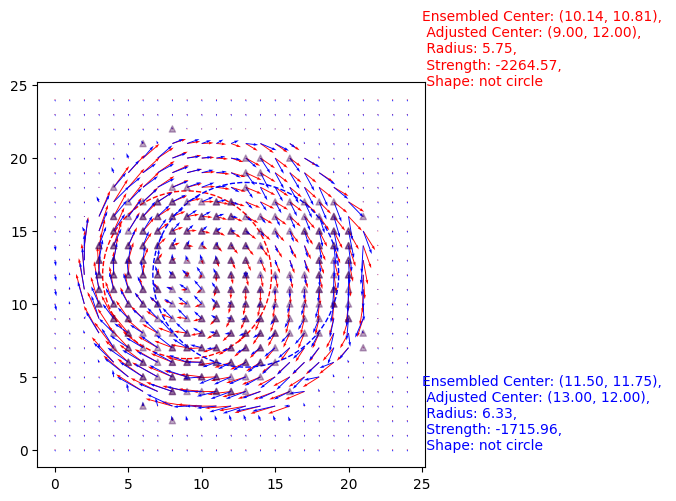

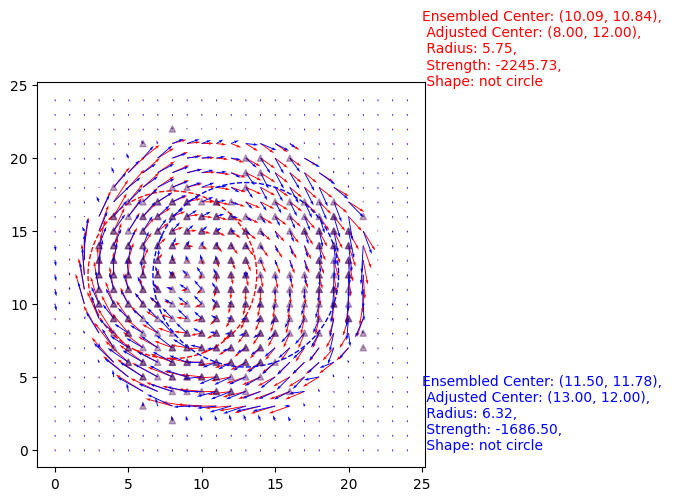

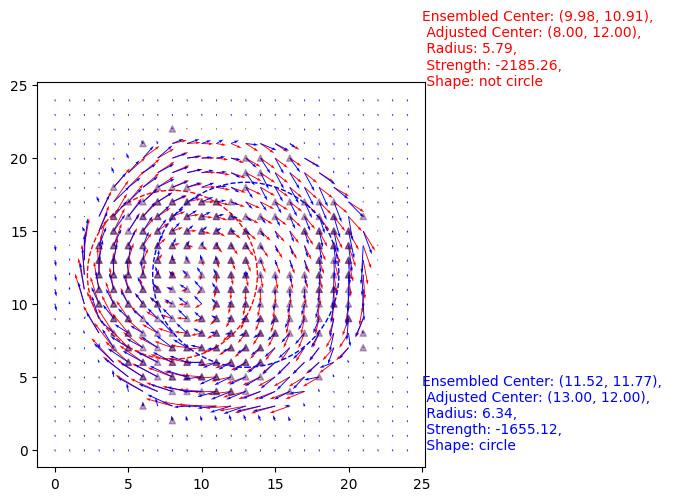

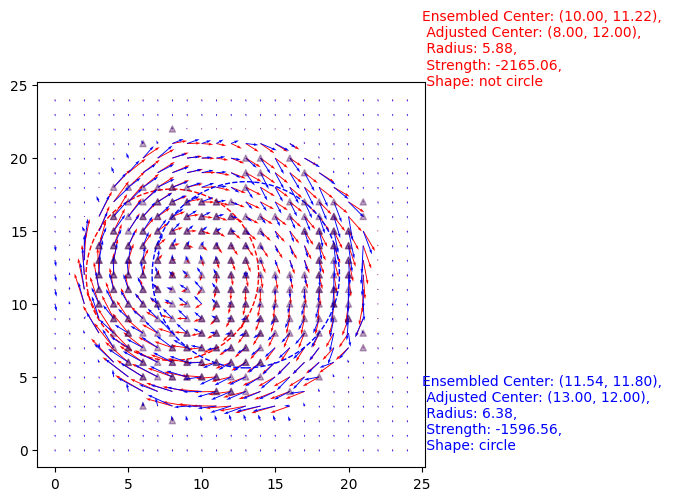

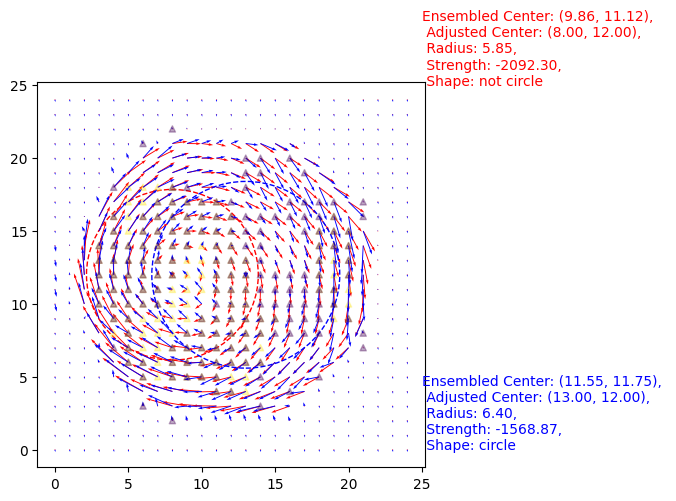

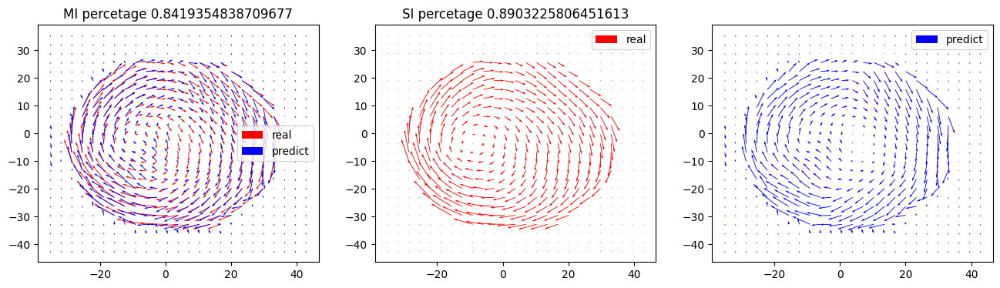

81
MI(average/percent):
0.8763159362221323 0.8483870967741935
SI(average/percent):
0.9154607782151339 0.8838709677419355
82
MI(average/percent):
0.8741512541149314 0.8451612903225807
SI(average/percent):
0.914428892280068 0.8806451612903226
83
MI(average/percent):
0.8717284447080267 0.8451612903225807
SI(average/percent):
0.9128029982077895 0.8774193548387097
84
MI(average/percent):
0.8691957908279432 0.8354838709677419
SI(average/percent):
0.9107384648205534 0.8741935483870967
85
MI(average/percent):
0.8665790648995318 0.8354838709677419
SI(average/percent):
0.9081957747237982 0.867741935483871


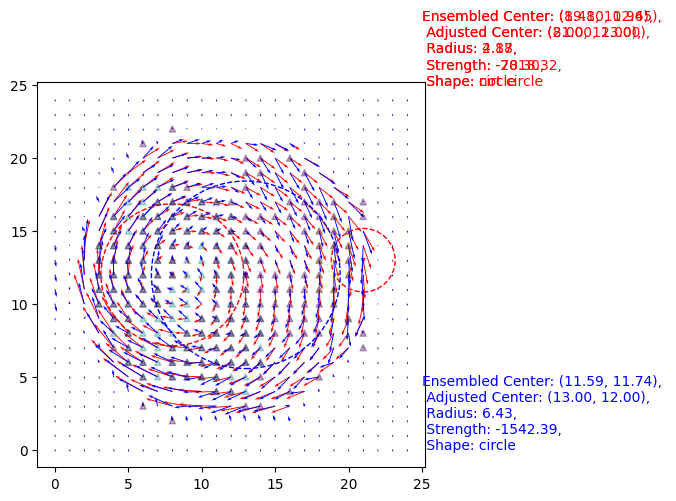

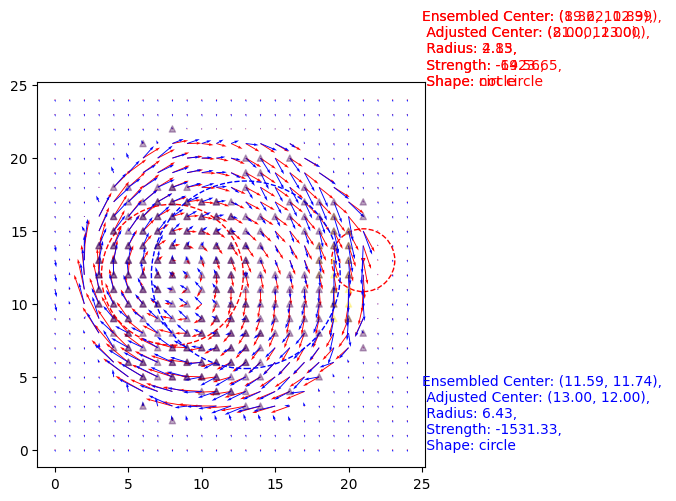

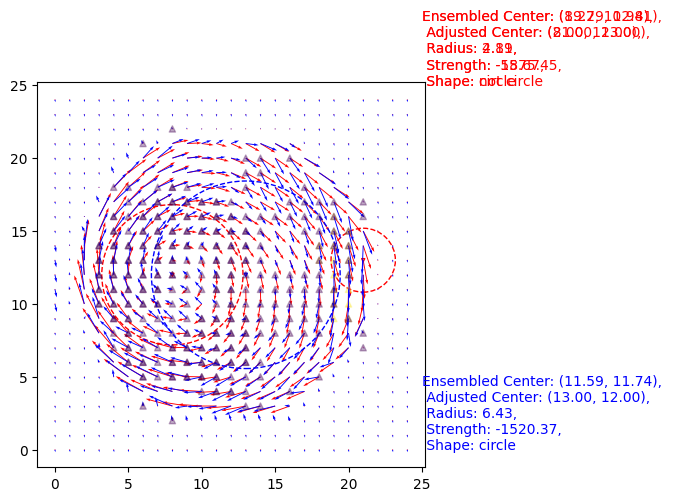

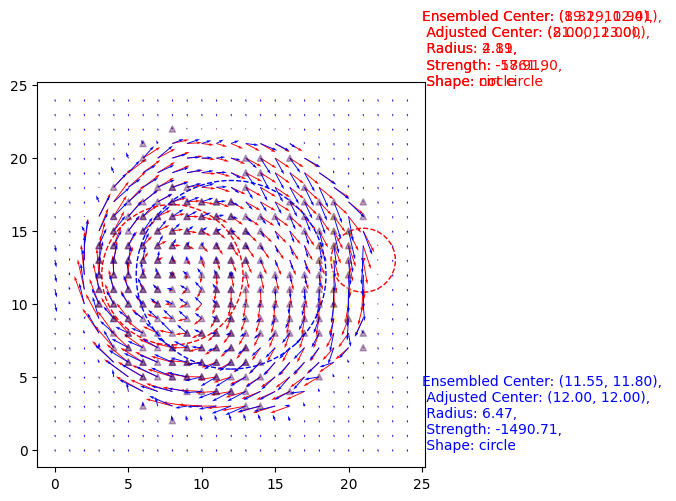

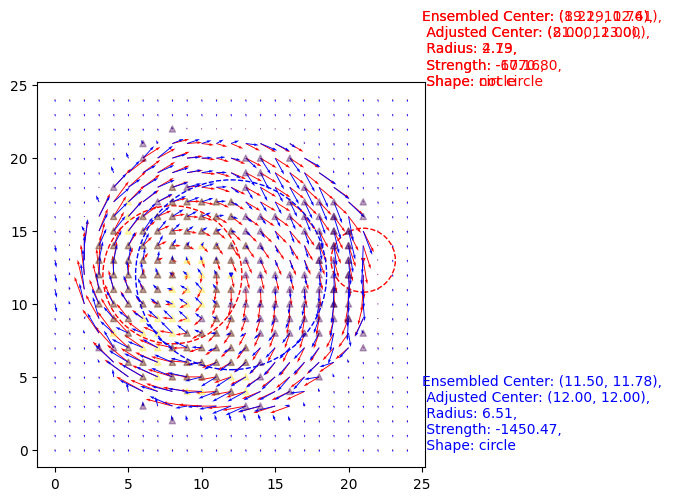

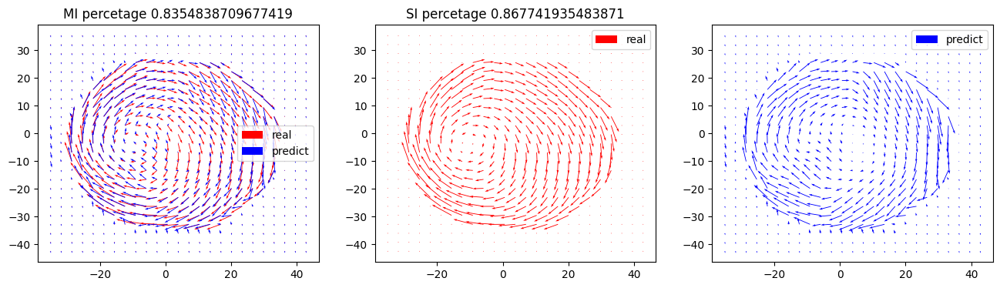

86
MI(average/percent):
0.8658020611720596 0.8290322580645161
SI(average/percent):
0.9064153423920939 0.867741935483871
87
MI(average/percent):
0.8648498719475076 0.8290322580645161
SI(average/percent):
0.9045978153135452 0.864516129032258
88
MI(average/percent):
0.8633358088330776 0.8193548387096774
SI(average/percent):
0.903334746501973 0.864516129032258
89
MI(average/percent):
0.8616964778701465 0.8193548387096774
SI(average/percent):
0.9015743456507291 0.8548387096774194
90
MI(average/percent):
0.8598220600707065 0.8225806451612904
SI(average/percent):
0.8979095623474376 0.8483870967741935


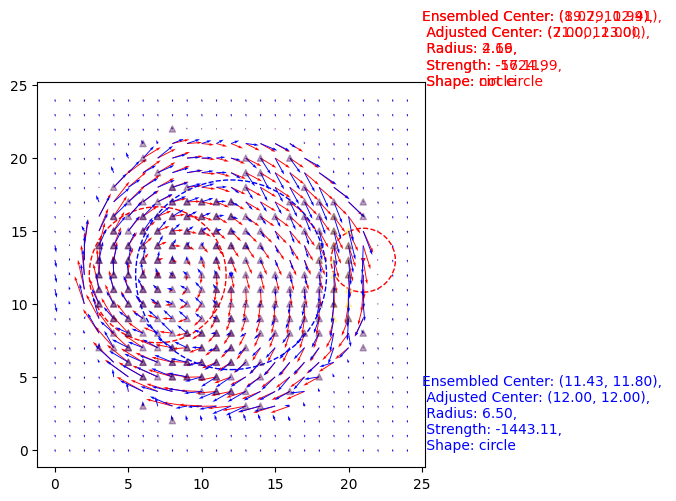

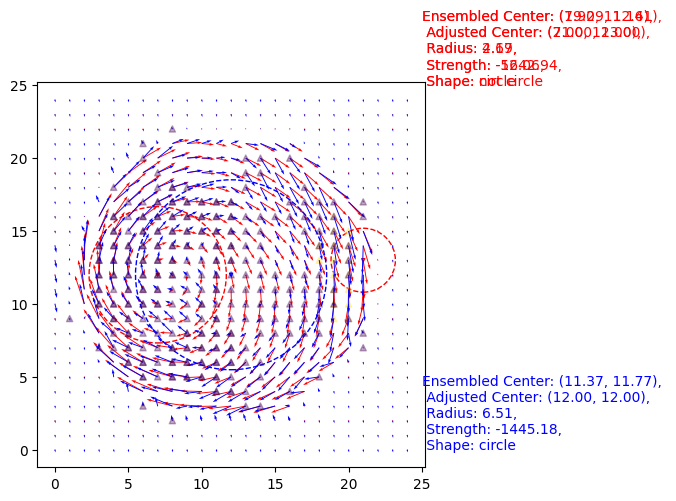

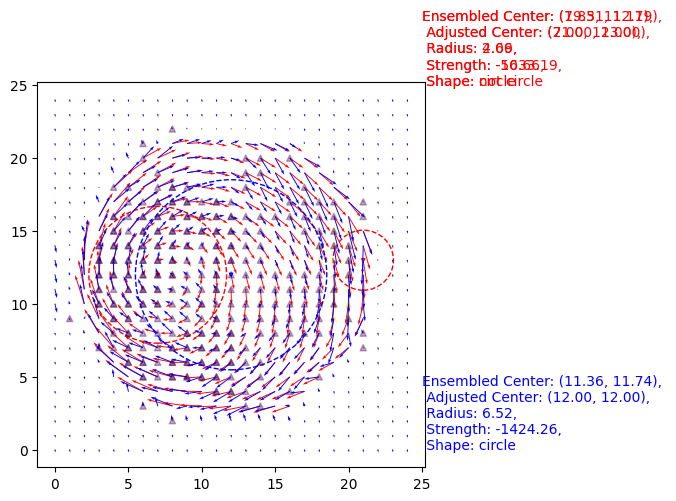

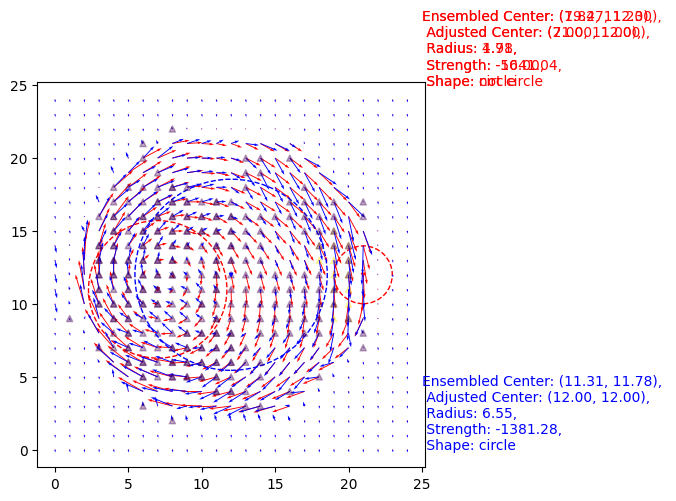

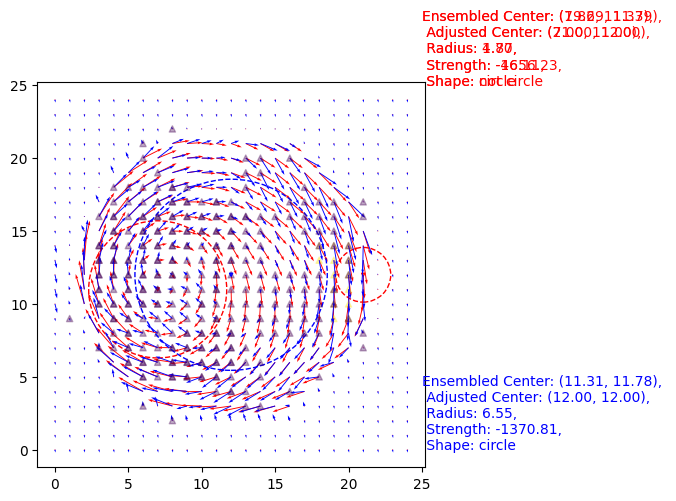

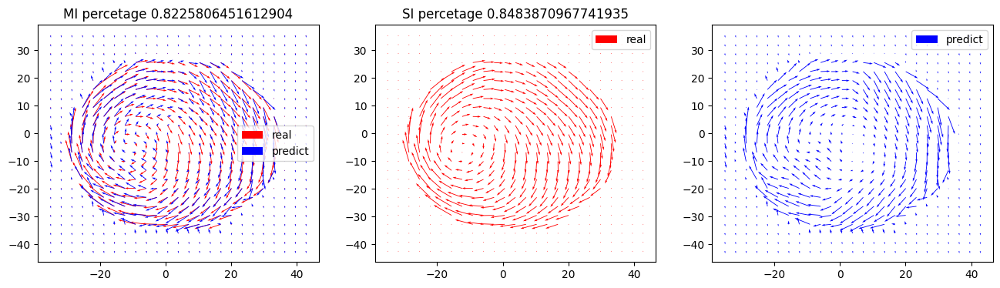

91
MI(average/percent):
0.858104234609339 0.8193548387096774
SI(average/percent):
0.8980718776509494 0.8516129032258064
92
MI(average/percent):
0.8564321712326174 0.8064516129032258
SI(average/percent):
0.8981046367595718 0.8548387096774194
93
MI(average/percent):
0.8546673197539628 0.8
SI(average/percent):
0.8983424473448198 0.8516129032258064
94
MI(average/percent):
0.8525193352052629 0.7935483870967742
SI(average/percent):
0.8995488500561802 0.864516129032258
95
MI(average/percent):
0.8501589704593322 0.7870967741935484
SI(average/percent):
0.8985667121143612 0.8612903225806452


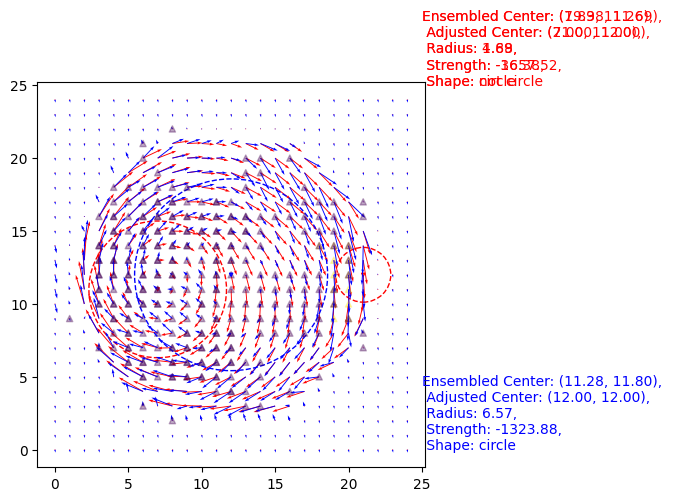

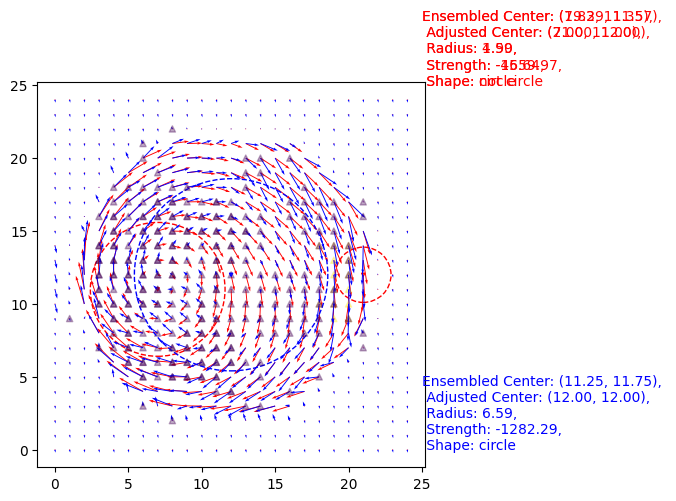

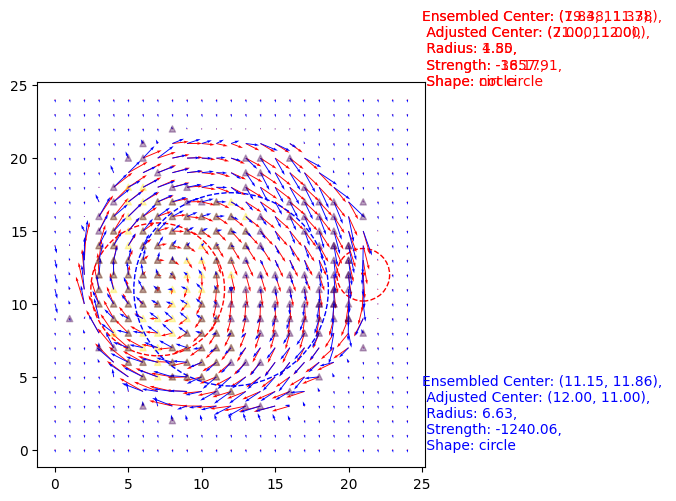

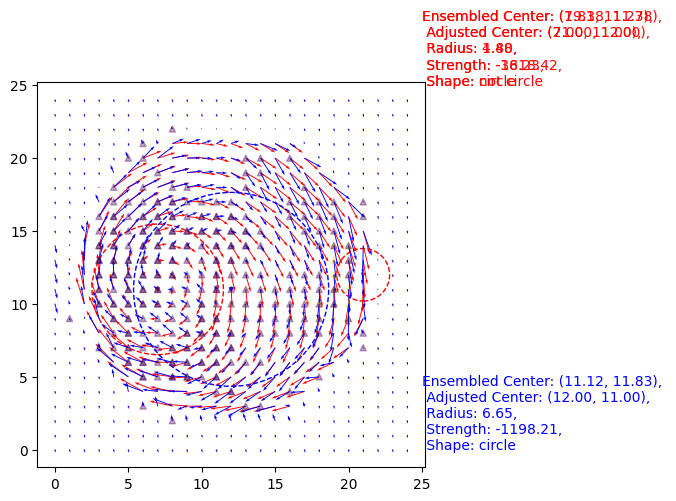

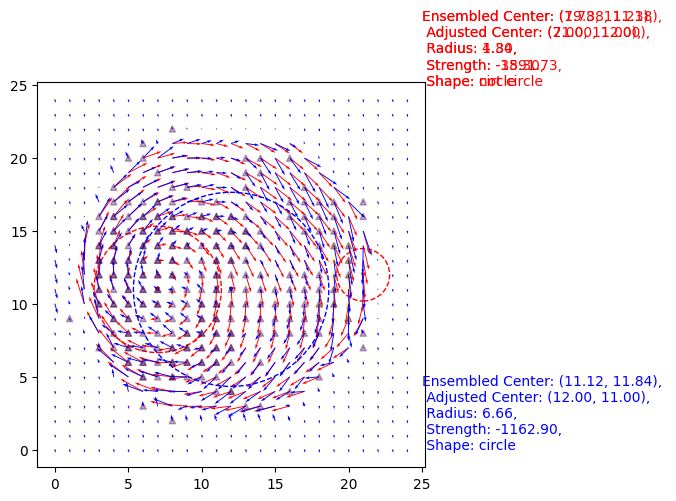

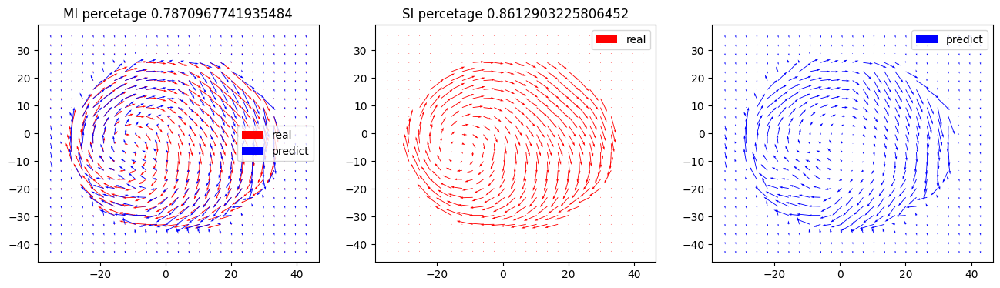

96
MI(average/percent):
0.8477933804625962 0.7774193548387097
SI(average/percent):
0.8960493759035453 0.8580645161290322
97
MI(average/percent):
0.8454193635455176 0.7774193548387097
SI(average/percent):
0.8953068541150883 0.8516129032258064
98
MI(average/percent):
0.8427756789043376 0.7709677419354839
SI(average/percent):
0.8943020963241103 0.8516129032258064
99
MI(average/percent):
0.840211340794377 0.7677419354838709
SI(average/percent):
0.8929801456085452 0.8516129032258064
100
MI(average/percent):
0.8377677881923163 0.7645161290322581
SI(average/percent):
0.8909633470180355 0.8516129032258064


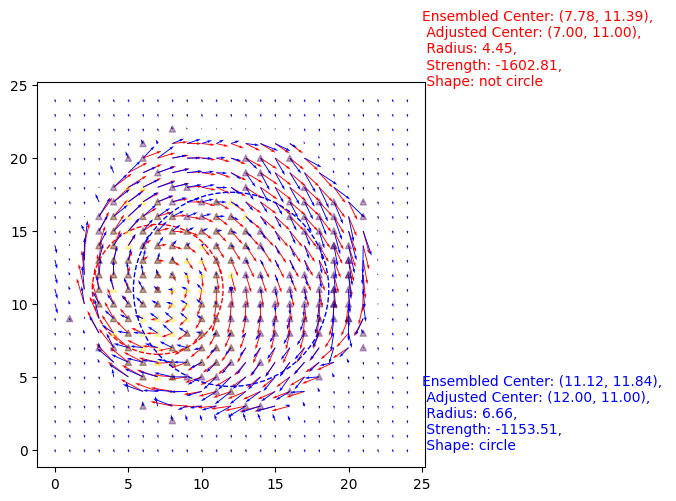

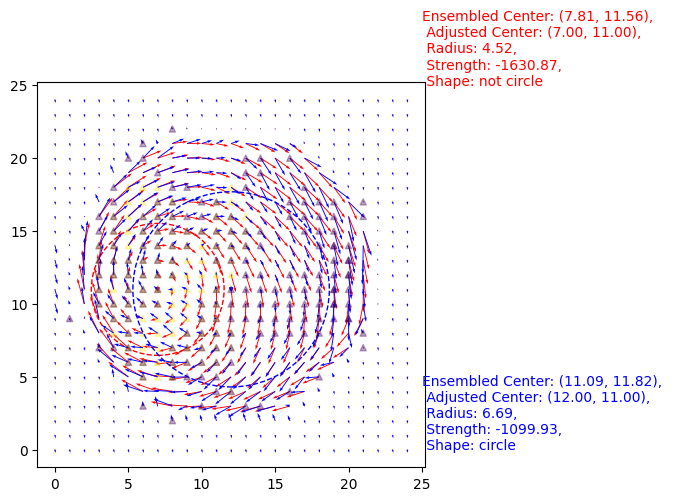

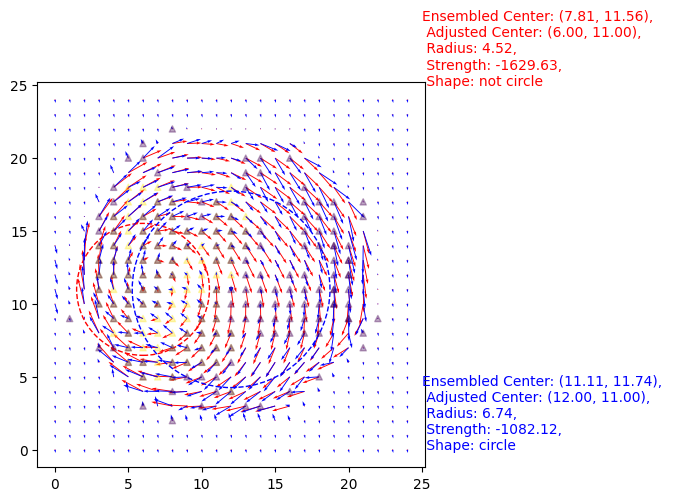

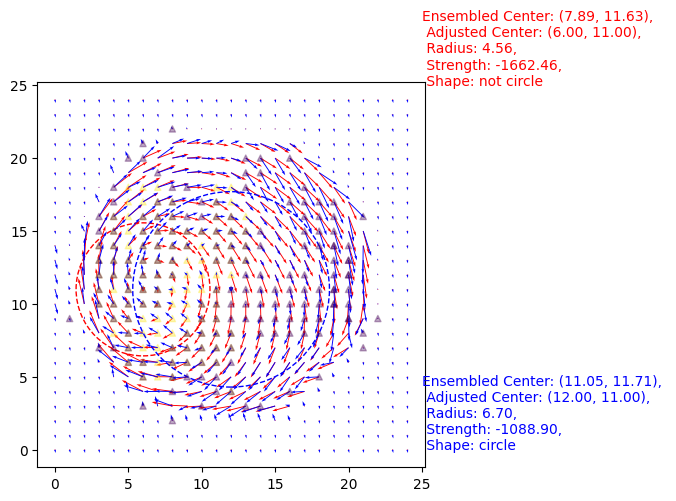

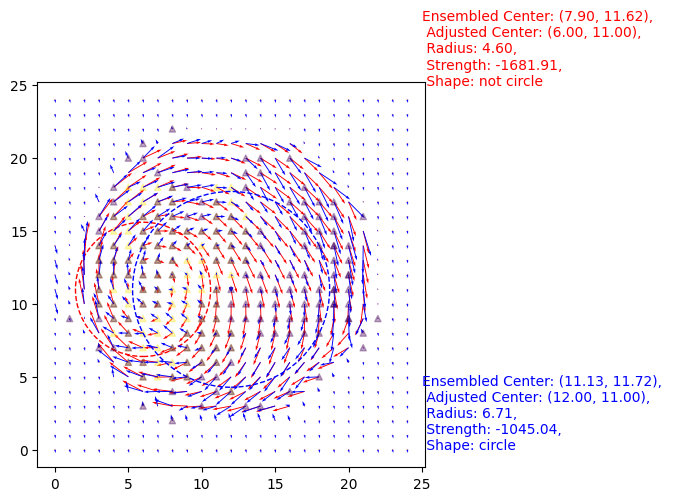

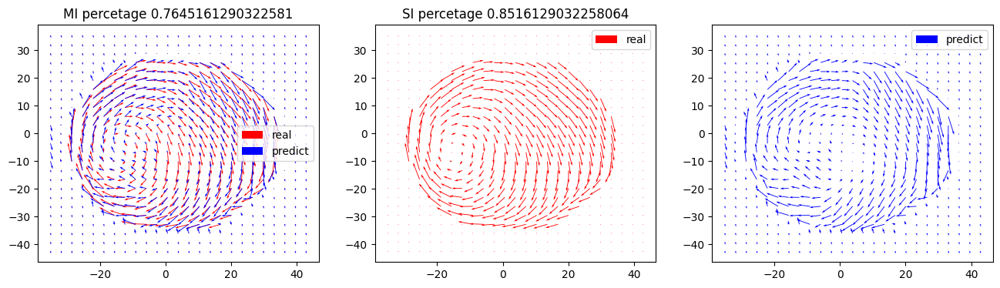

101
MI(average/percent):
0.8374263998083415 0.7612903225806451
SI(average/percent):
0.8901745467862785 0.8483870967741935
102
MI(average/percent):
0.8371594754990795 0.7580645161290323
SI(average/percent):
0.8890297778545487 0.8354838709677419
103
MI(average/percent):
0.8368218397807269 0.7548387096774194
SI(average/percent):
0.8877145127788224 0.8419354838709677
104
MI(average/percent):
0.8361690590747108 0.7483870967741936
SI(average/percent):
0.8863044419250302 0.8354838709677419
105
MI(average/percent):
0.8352183552145878 0.7387096774193549
SI(average/percent):
0.8849024378414501 0.8258064516129032


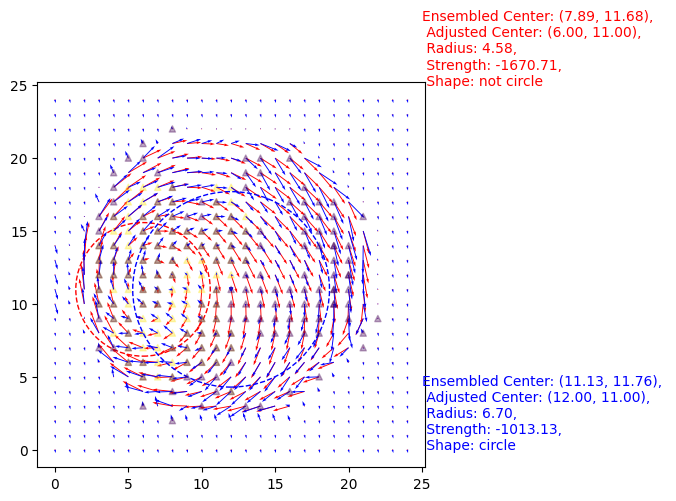

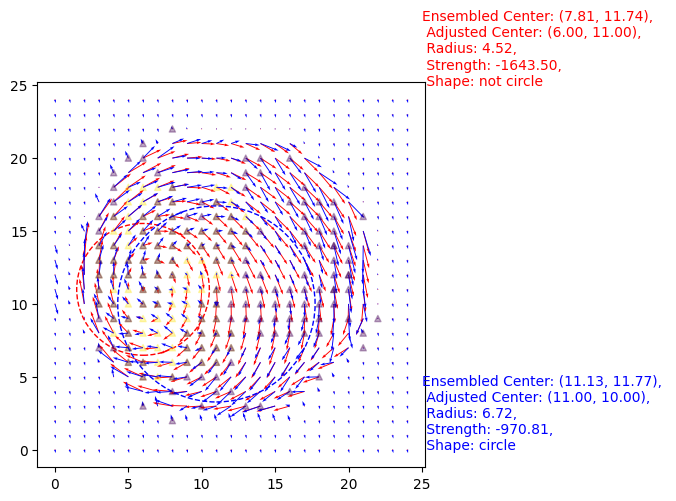

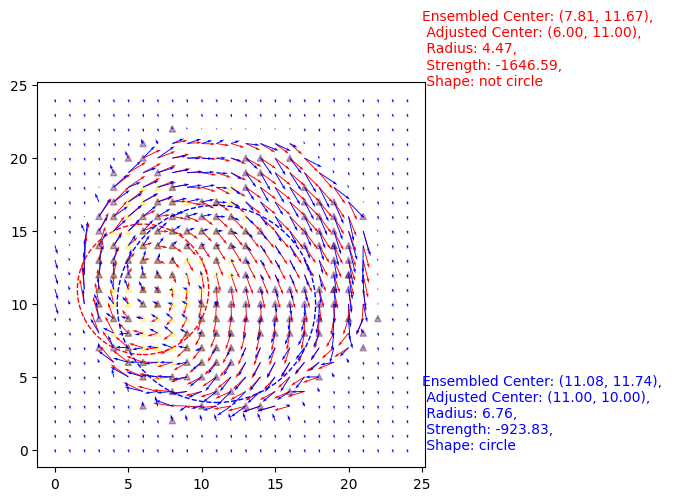

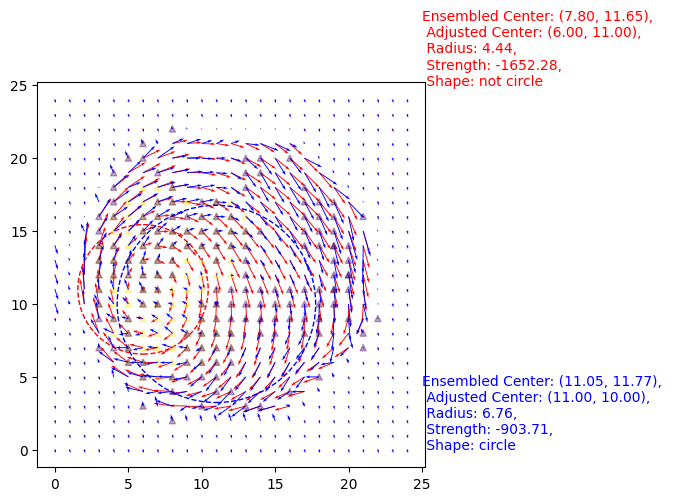

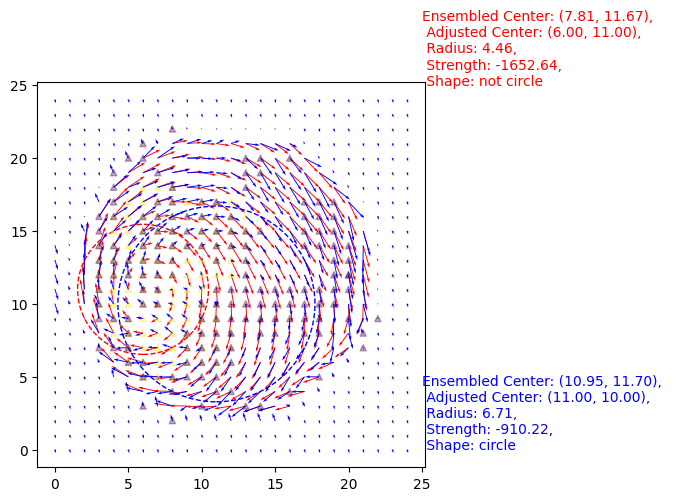

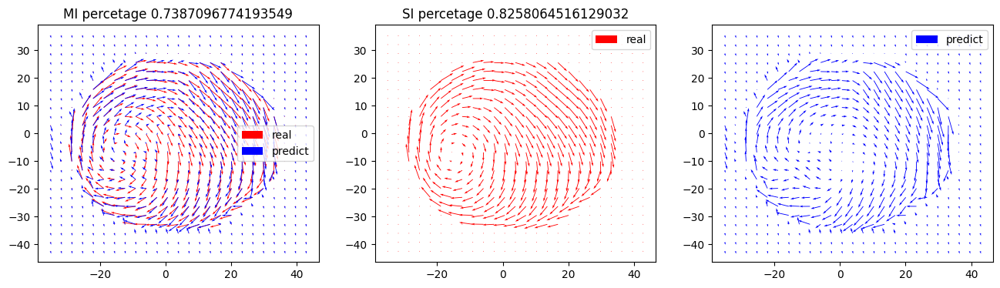

106
MI(average/percent):
0.835644338629589 0.7516129032258064
SI(average/percent):
0.8833258870861996 0.832258064516129
107
MI(average/percent):
0.836034093405342 0.7516129032258064
SI(average/percent):
0.8833124155653715 0.832258064516129
108
MI(average/percent):
0.8363447967162021 0.7483870967741936
SI(average/percent):
0.8824832094746328 0.8193548387096774
109
MI(average/percent):
0.836325359871638 0.7516129032258064
SI(average/percent):
0.8802777061404707 0.8129032258064516
110
MI(average/percent):
0.836257153984132 0.7451612903225806
SI(average/percent):
0.8768752883809184 0.8064516129032258


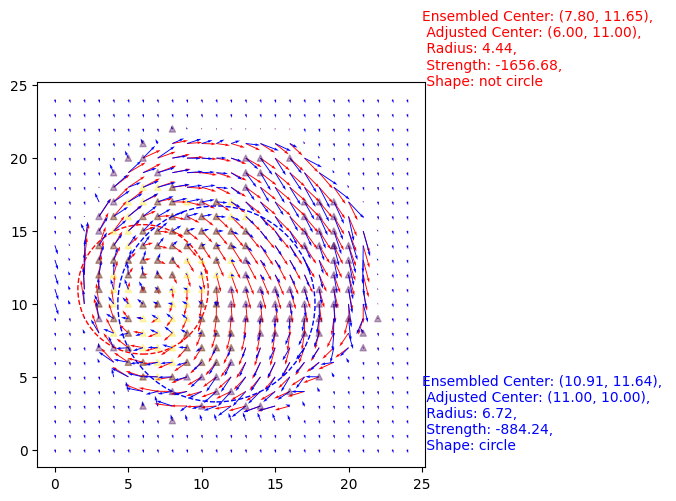

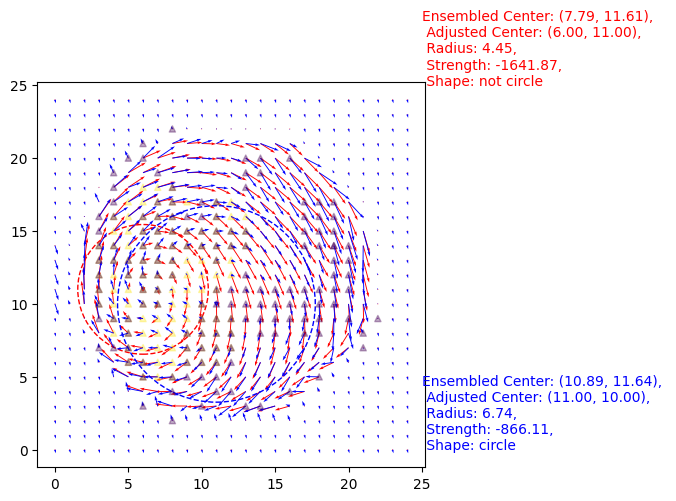

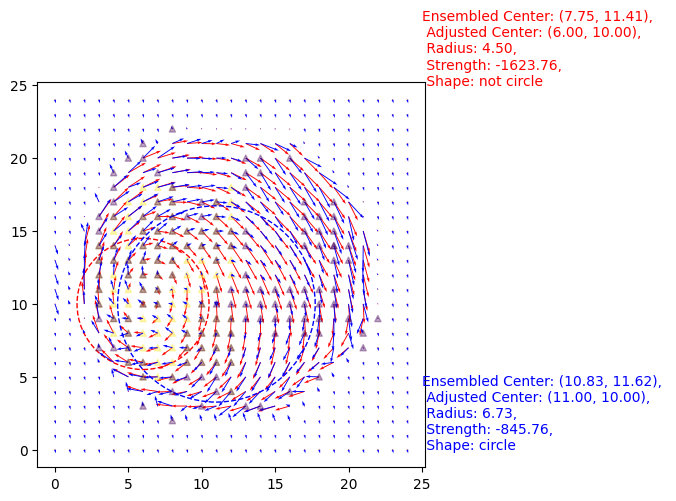

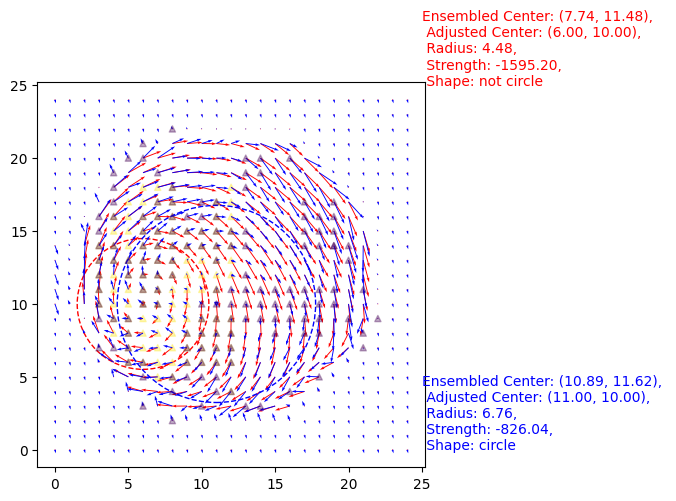

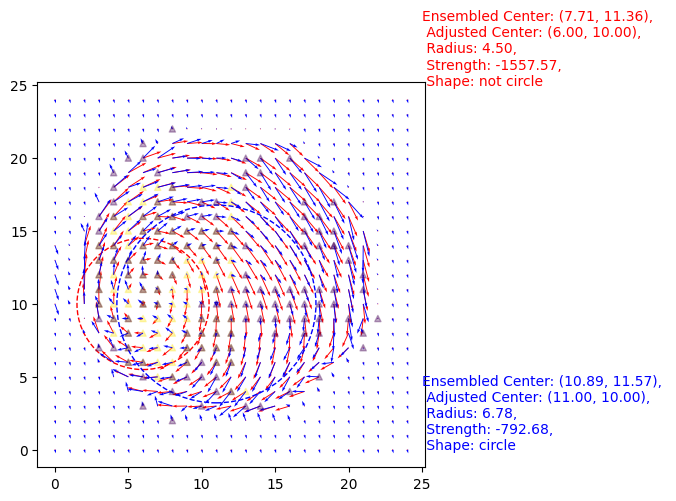

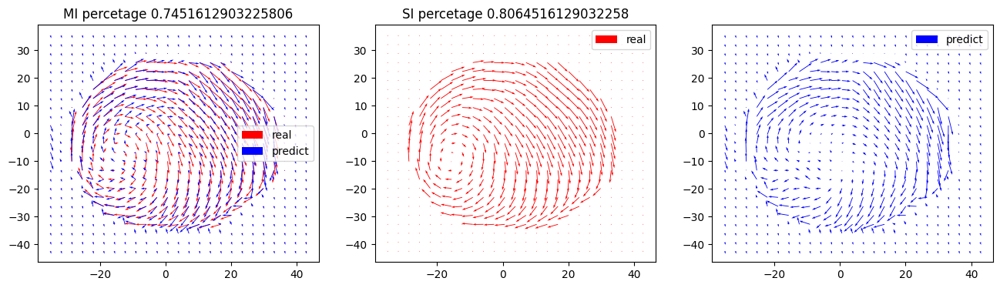

111
MI(average/percent):
0.83596070246045 0.7451612903225806
SI(average/percent):
0.8752790132293657 0.8096774193548387
112
MI(average/percent):
0.8354185894878362 0.7419354838709677
SI(average/percent):
0.8740619470414693 0.8096774193548387
113
MI(average/percent):
0.8348830266018487 0.7451612903225806
SI(average/percent):
0.8730197078885591 0.8129032258064516
114
MI(average/percent):
0.8343203978449785 0.7451612903225806
SI(average/percent):
0.8723305633109238 0.8064516129032258
115
MI(average/percent):
0.8335777363386375 0.7516129032258064
SI(average/percent):
0.8720840879531134 0.8096774193548387


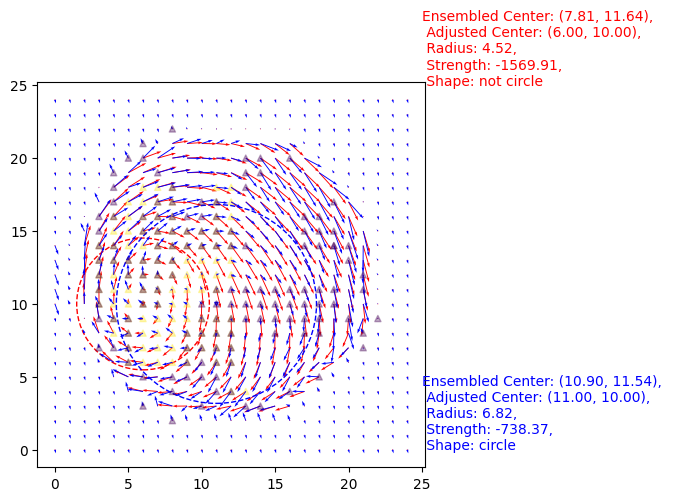

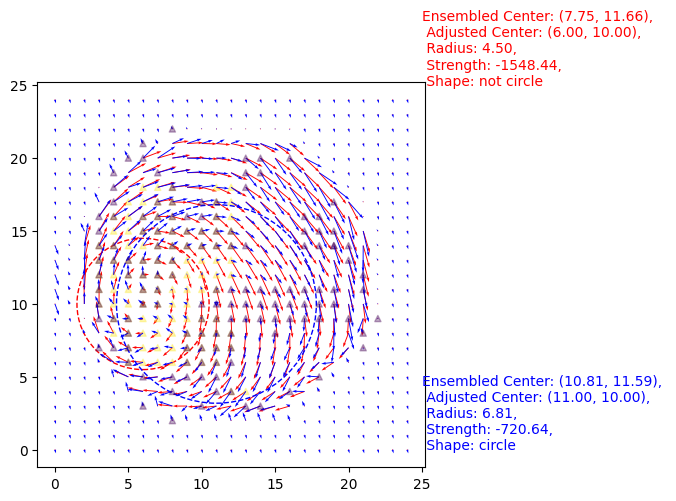

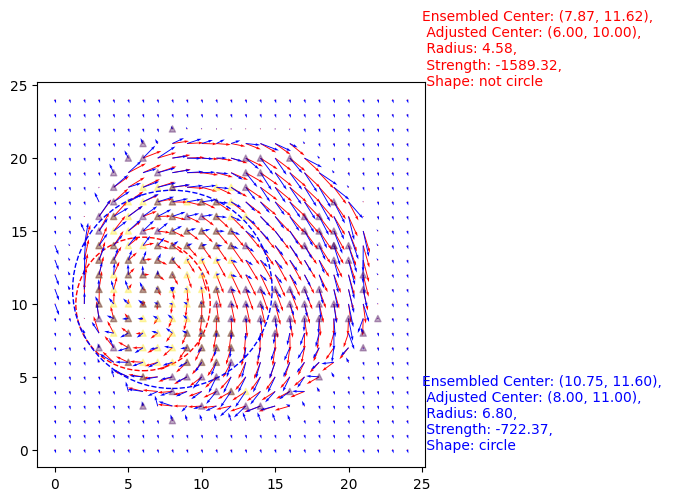

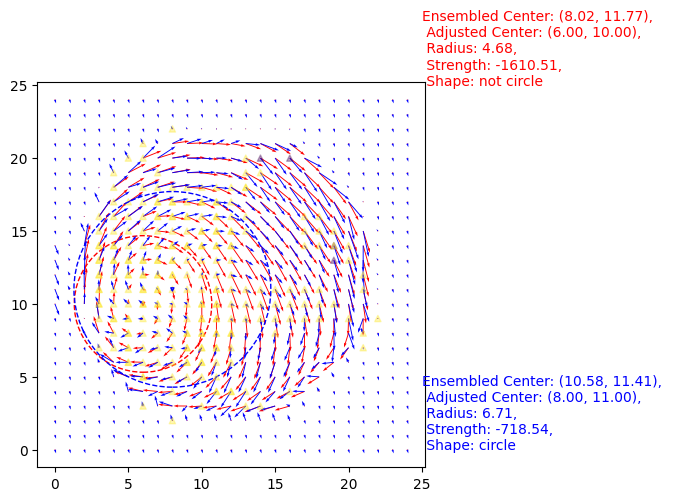

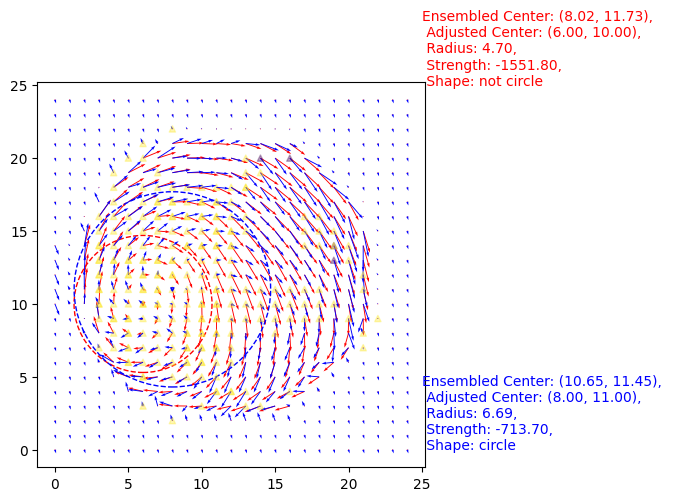

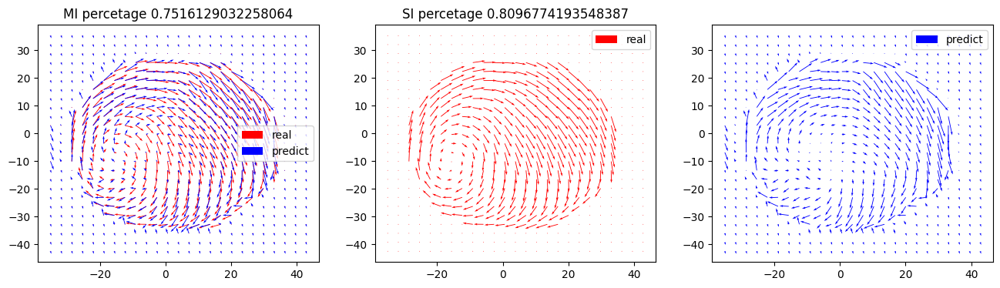

116
MI(average/percent):
0.8348913980842899 0.7483870967741936
SI(average/percent):
0.8736191556737621 0.8064516129032258
117
MI(average/percent):
0.8360804856118698 0.7451612903225806
SI(average/percent):
0.8745535257456702 0.8064516129032258
118
MI(average/percent):
0.8372281999260698 0.7516129032258064
SI(average/percent):
0.8750318746177536 0.8
119
MI(average/percent):
0.8377933451330868 0.7516129032258064
SI(average/percent):
0.8758569236859546 0.8064516129032258
120
MI(average/percent):
0.8376796960298204 0.7516129032258064
SI(average/percent):
0.8762674551091415 0.8064516129032258


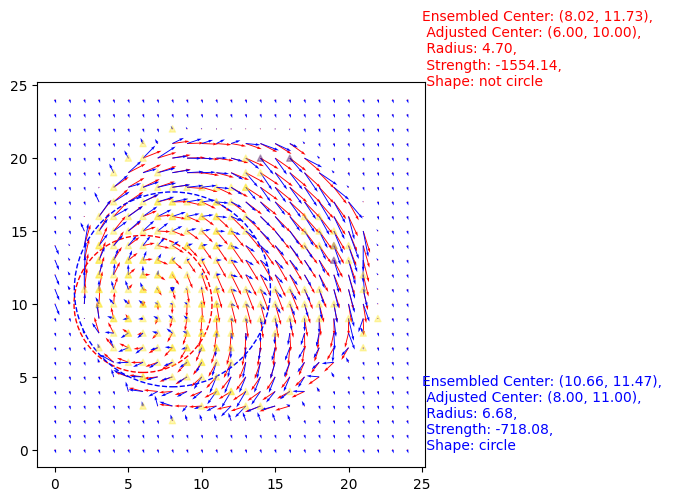

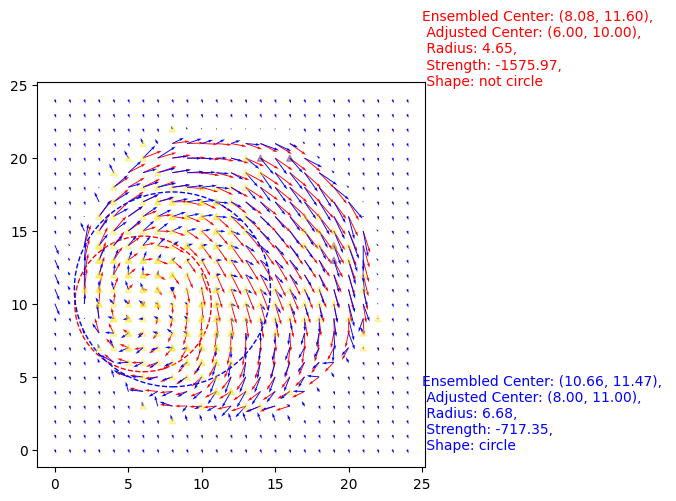

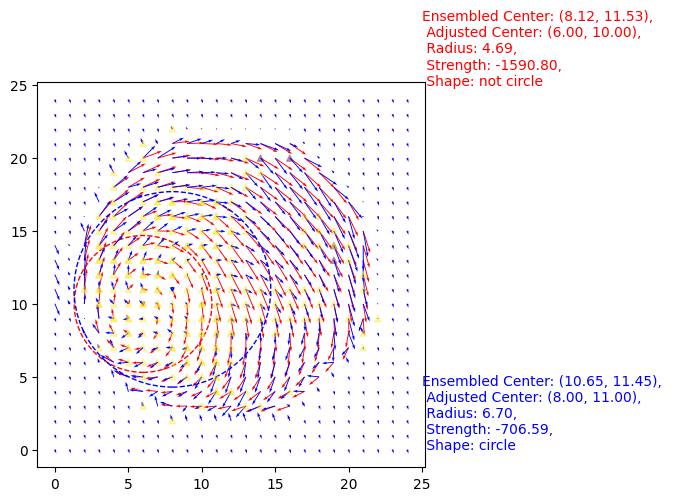

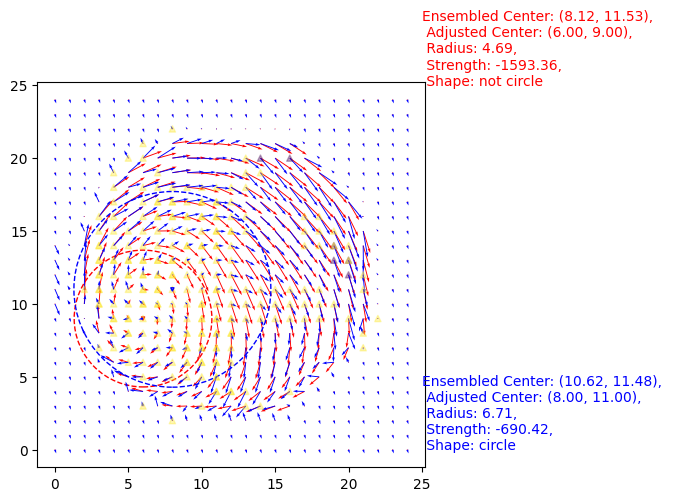

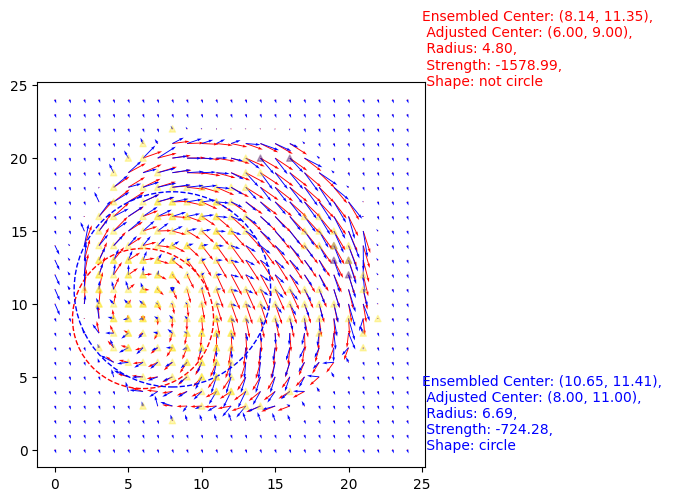

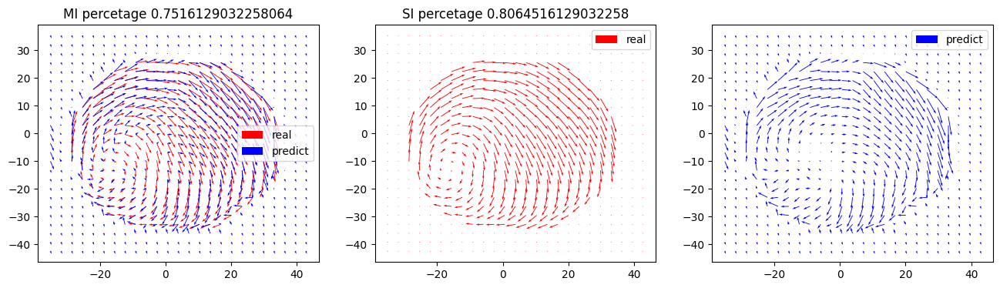

121
MI(average/percent):
0.8381324645156709 0.7548387096774194
SI(average/percent):
0.874500290785227 0.8
122
MI(average/percent):
0.8385928012001971 0.7548387096774194
SI(average/percent):
0.8728650647329005 0.8129032258064516
123
MI(average/percent):
0.8390010839571705 0.7419354838709677
SI(average/percent):
0.8730918249241154 0.8032258064516129
124
MI(average/percent):
0.8393876945046405 0.7354838709677419
SI(average/percent):
0.8740680764168375 0.8032258064516129
125
MI(average/percent):
0.8396573519755895 0.7387096774193549
SI(average/percent):
0.8751822421015297 0.8032258064516129


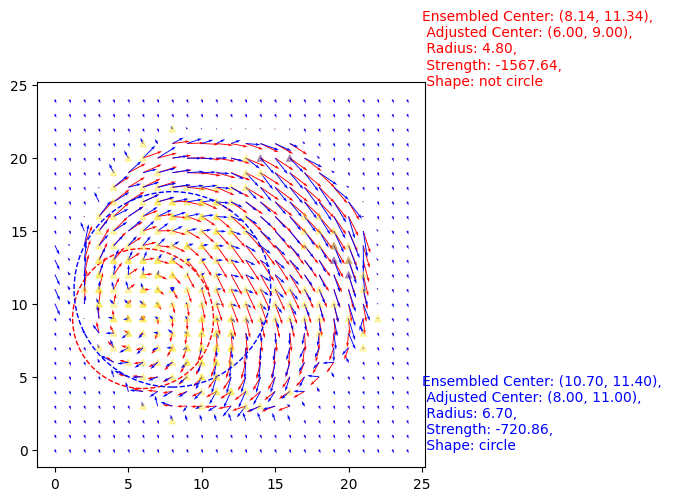

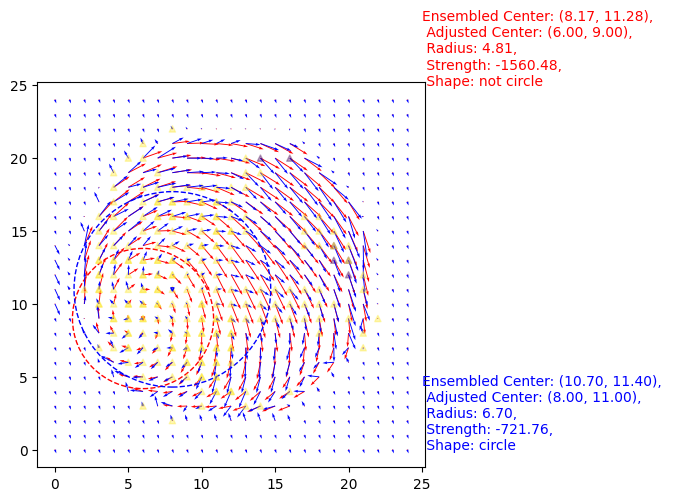

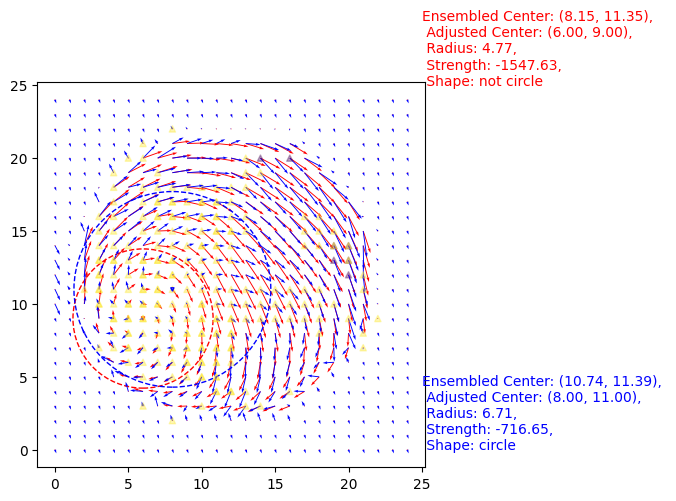

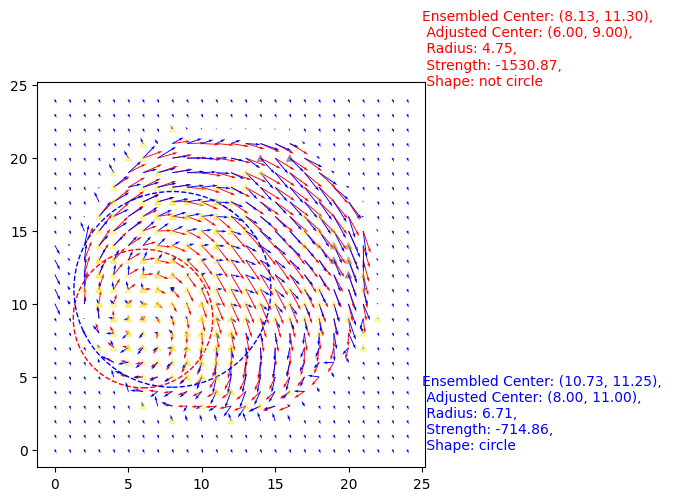

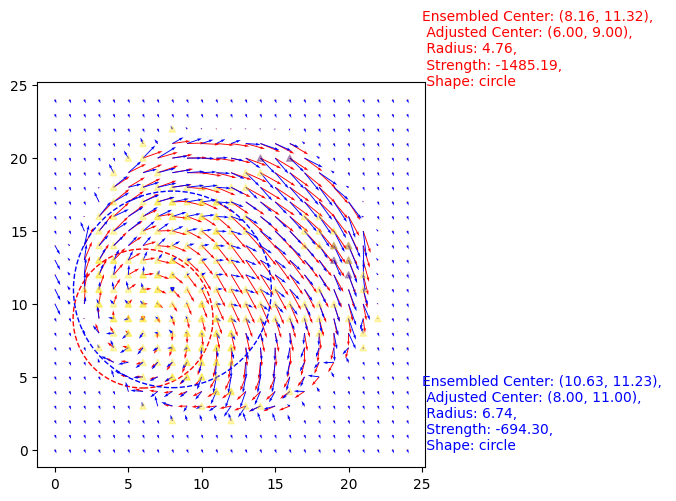

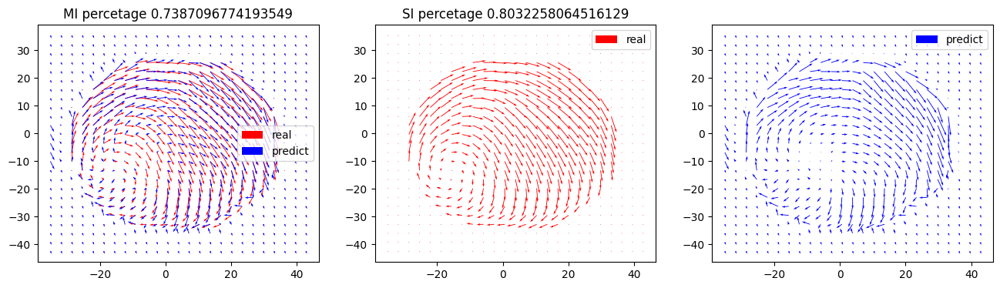

126
MI(average/percent):
0.8393640846906594 0.7451612903225806
SI(average/percent):
0.8772463680916 0.8032258064516129
127
MI(average/percent):
0.8386414506615741 0.7387096774193549
SI(average/percent):
0.8790239779023916 0.8064516129032258
128
MI(average/percent):
0.8375437984662495 0.7225806451612903
SI(average/percent):
0.8805569419884762 0.8129032258064516
129
MI(average/percent):
0.8364096182300935 0.7096774193548387
SI(average/percent):
0.8813818609273325 0.8161290322580645
130
MI(average/percent):
0.8346700638200941 0.7
SI(average/percent):
0.8817340088937 0.8129032258064516


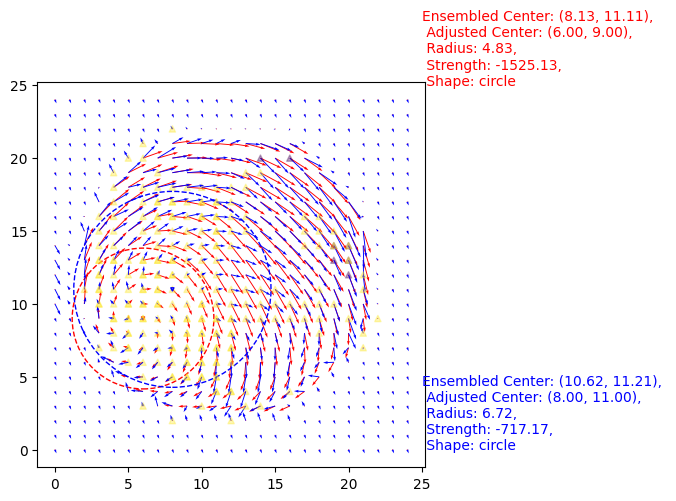

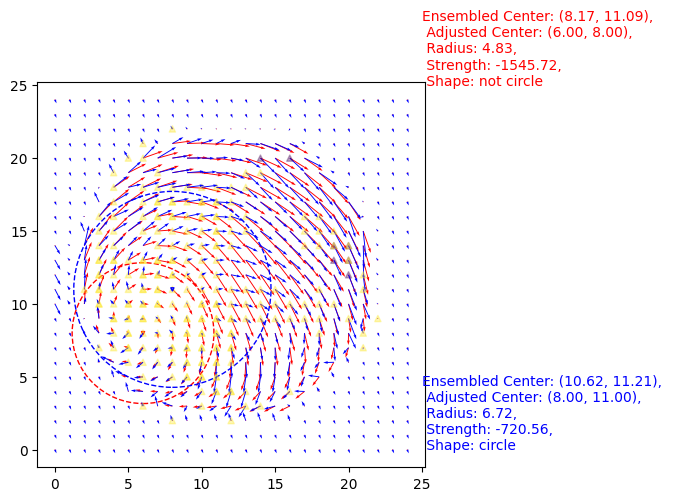

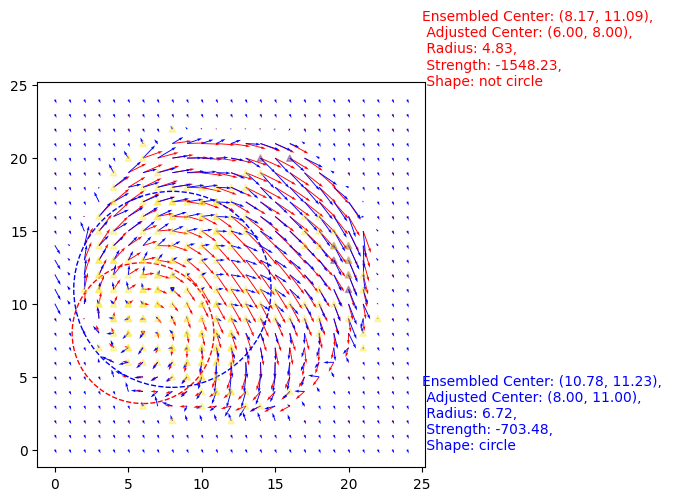

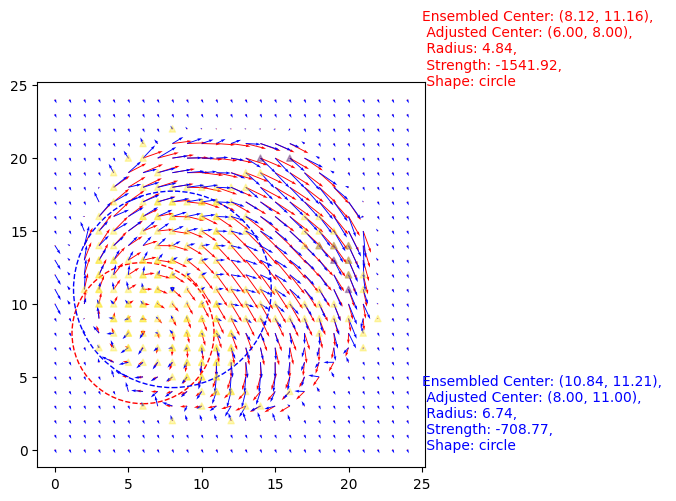

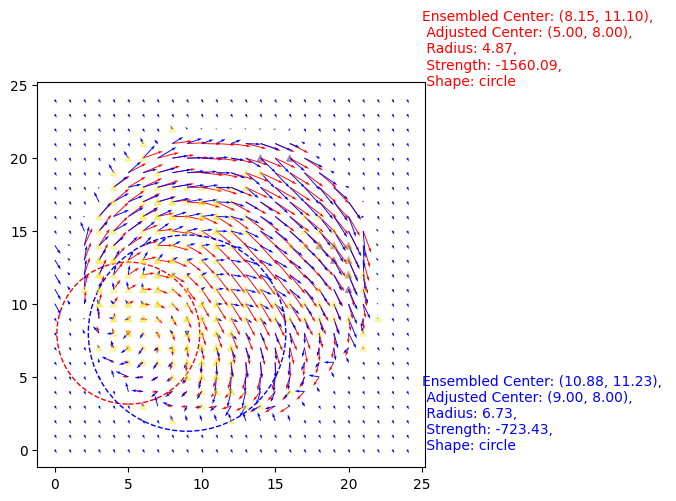

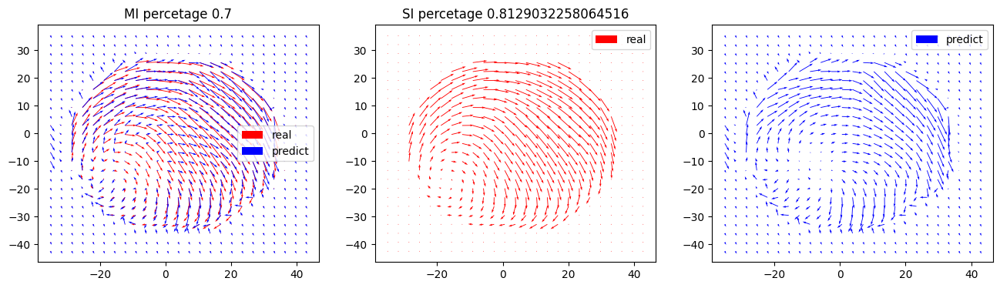

131
MI(average/percent):
0.8352197838837532 0.6935483870967742
SI(average/percent):
0.8823790063685046 0.8129032258064516
132
MI(average/percent):
0.8357356110386707 0.6838709677419355
SI(average/percent):
0.8829334771188084 0.8129032258064516
133
MI(average/percent):
0.8363098797094405 0.6935483870967742
SI(average/percent):
0.8834849315807837 0.8129032258064516
134
MI(average/percent):
0.8369922330645438 0.6967741935483871
SI(average/percent):
0.8836631663266444 0.8225806451612904
135
MI(average/percent):
0.8378677976934706 0.6935483870967742
SI(average/percent):
0.8832108022630922 0.8225806451612904


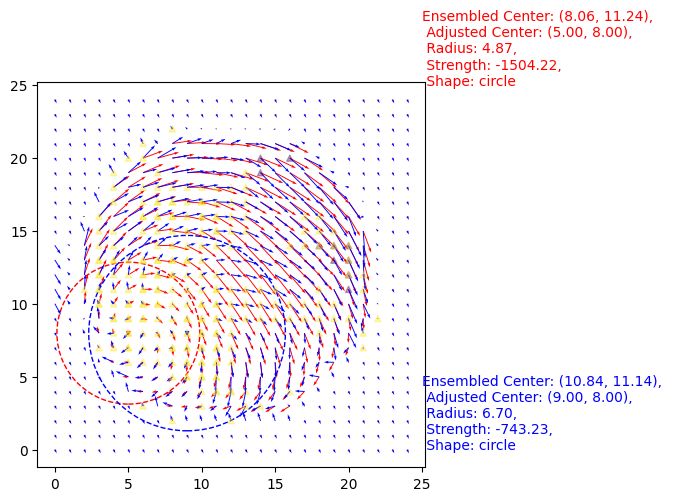

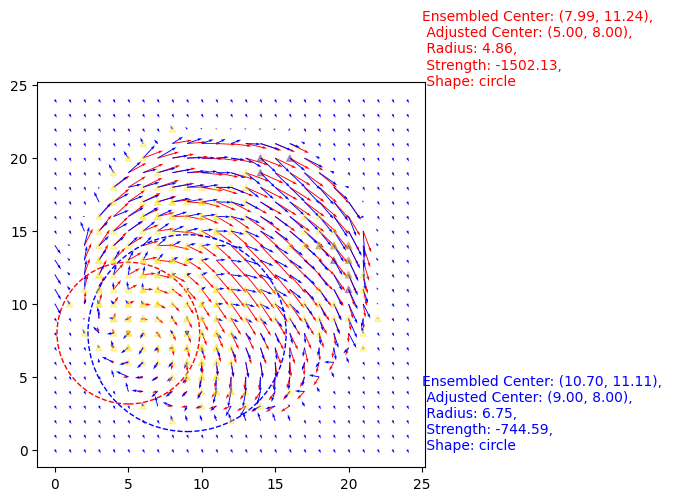

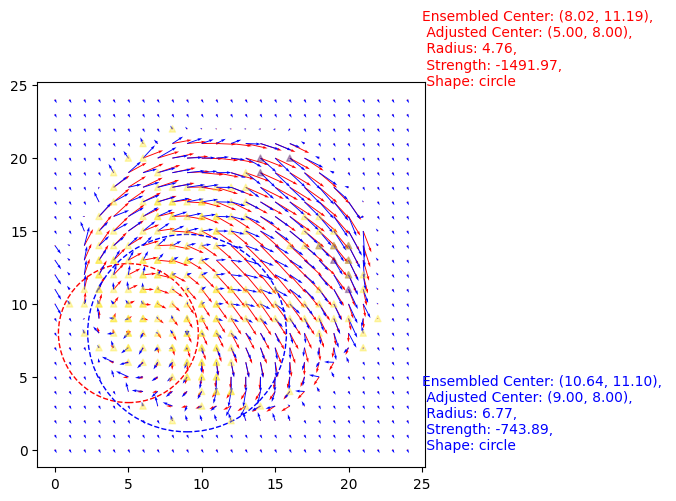

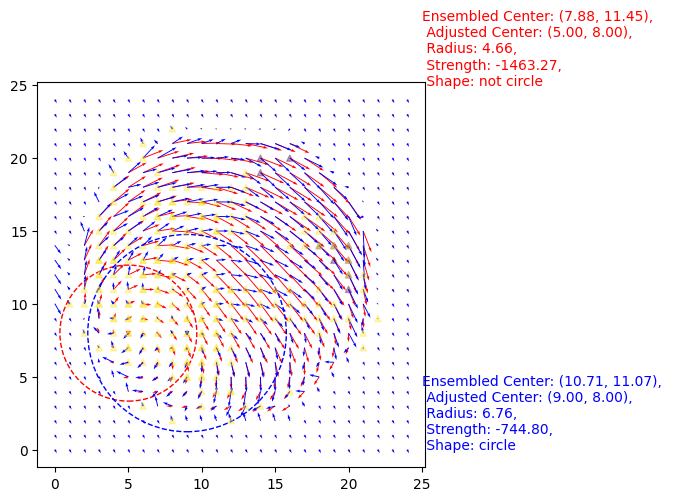

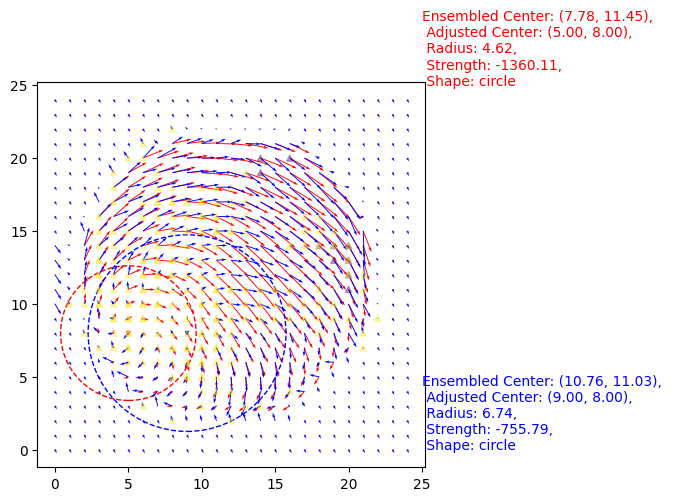

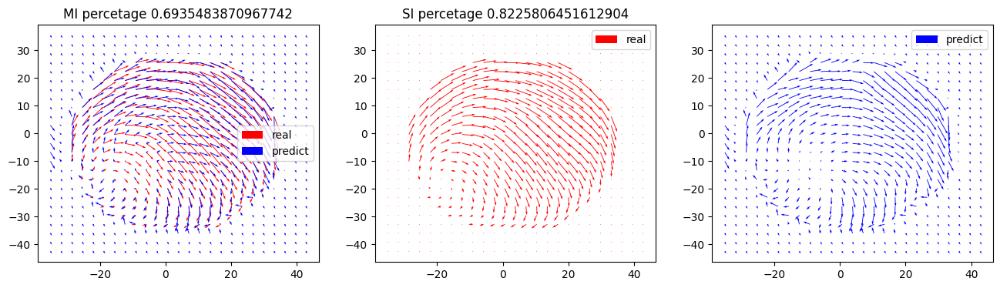

136
MI(average/percent):
0.8373035793351885 0.7064516129032258
SI(average/percent):
0.8829237989993644 0.8129032258064516
137
MI(average/percent):
0.8364179976409352 0.7129032258064516
SI(average/percent):
0.8822496123311254 0.8096774193548387
138
MI(average/percent):
0.8356040750771443 0.7193548387096774
SI(average/percent):
0.8799117261635446 0.8096774193548387
139
MI(average/percent):
0.8348823395598853 0.7193548387096774
SI(average/percent):
0.8769717888203001 0.8096774193548387
140
MI(average/percent):
0.8342040573831417 0.7129032258064516
SI(average/percent):
0.8764112080160611 0.8064516129032258


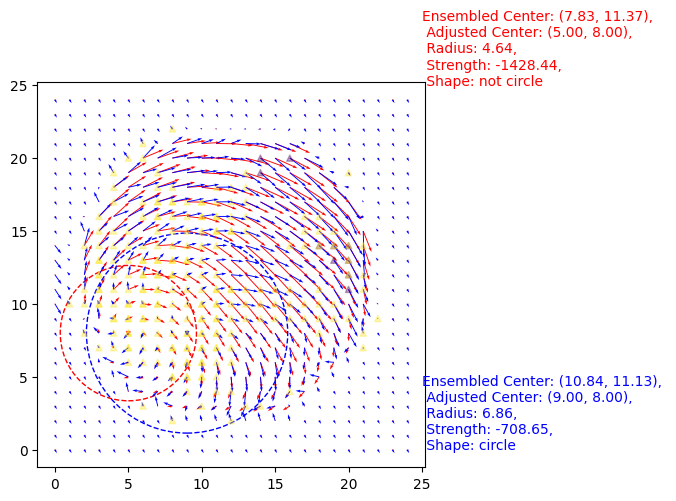

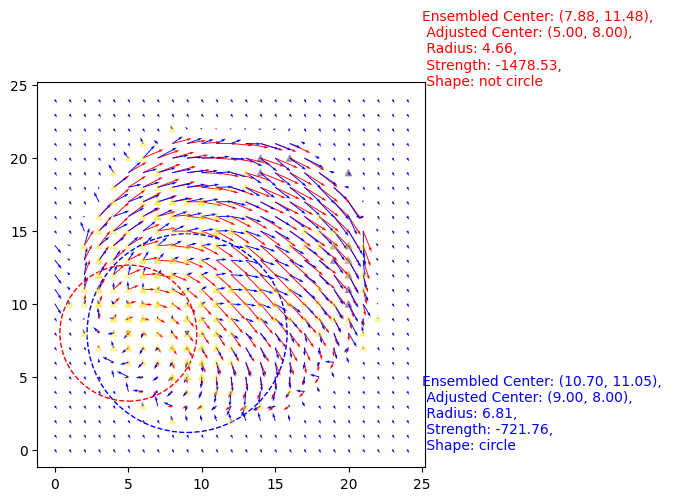

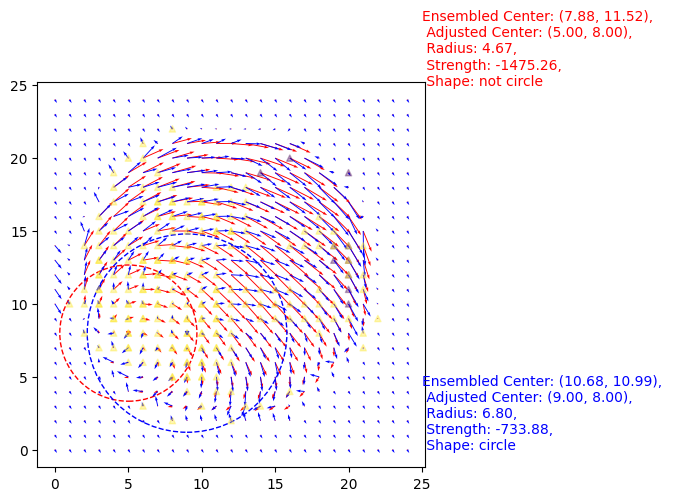

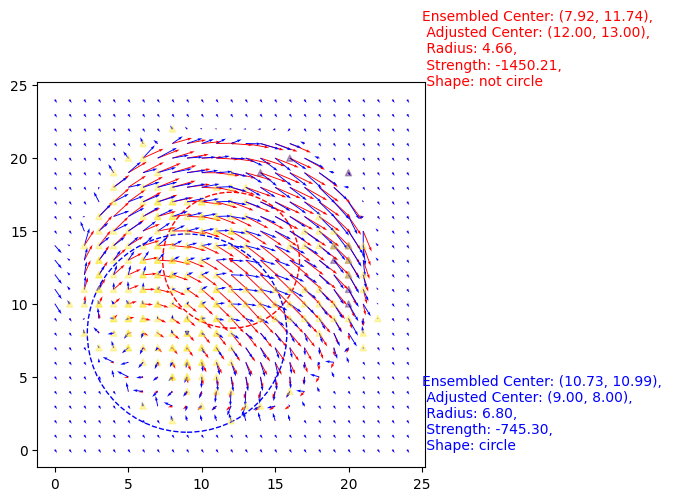

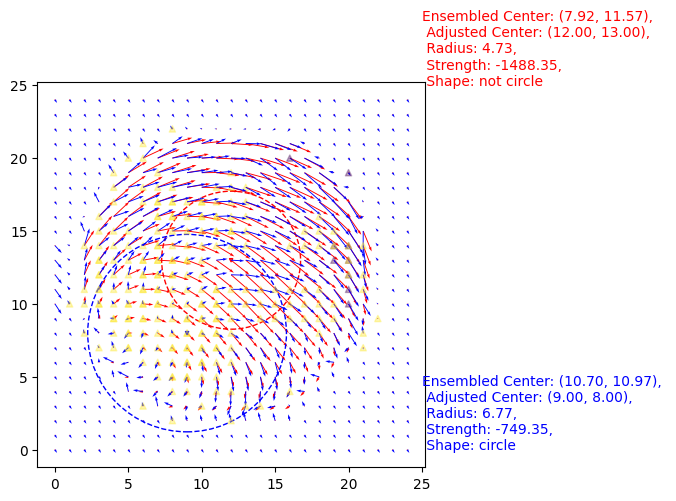

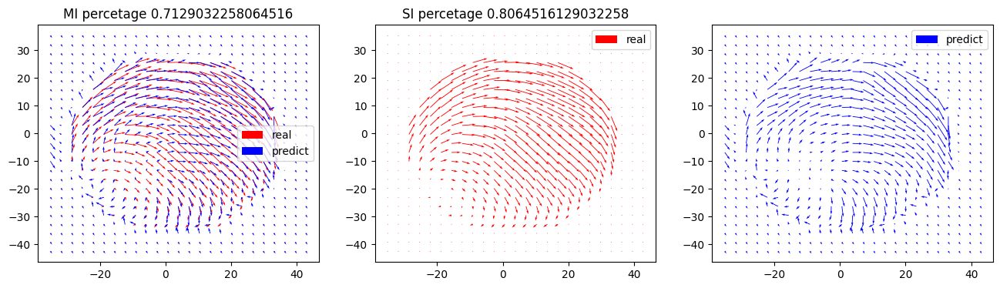

141
MI(average/percent):
0.834036492100585 0.7161290322580646
SI(average/percent):
0.8739279976380109 0.7935483870967742
142
MI(average/percent):
0.8341379033487963 0.7096774193548387
SI(average/percent):
0.8699731322453307 0.7967741935483871
143
MI(average/percent):
0.8345000065754656 0.7193548387096774
SI(average/percent):
0.8648131974820058 0.7935483870967742
144
MI(average/percent):
0.8351800102847402 0.7193548387096774
SI(average/percent):
0.8601834771626125 0.7935483870967742
145
MI(average/percent):
0.8362800407288945 0.7354838709677419
SI(average/percent):
0.8550663439998164 0.7935483870967742


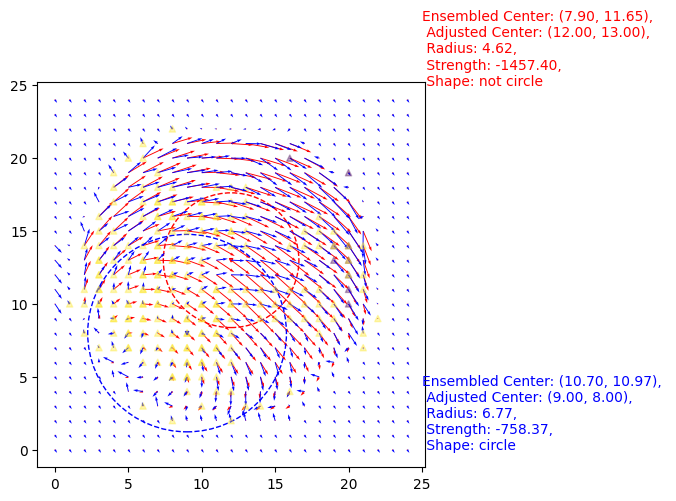

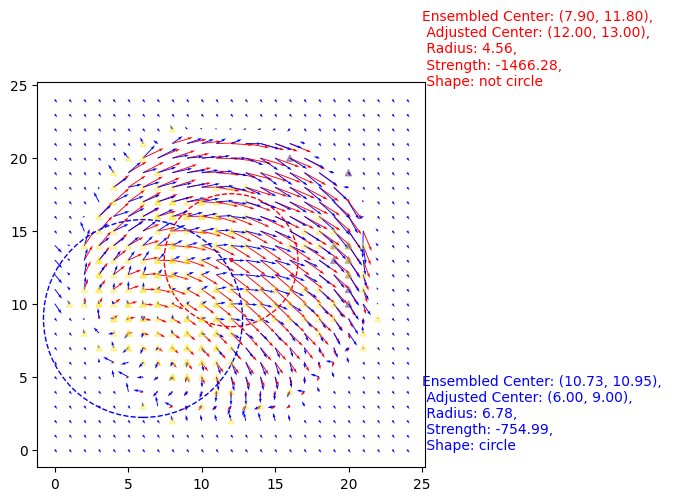

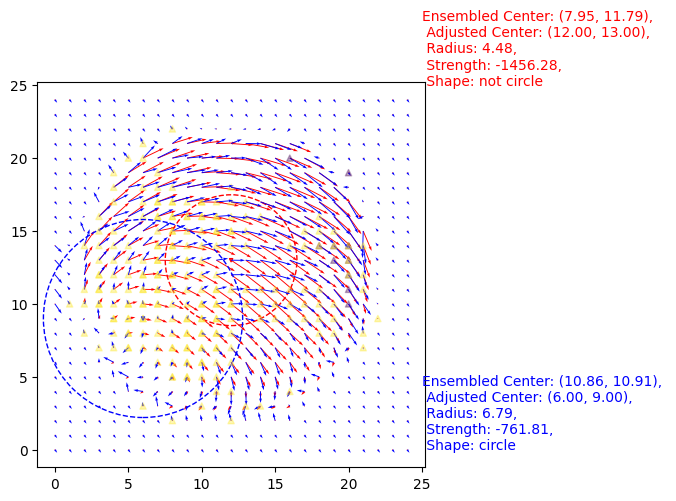

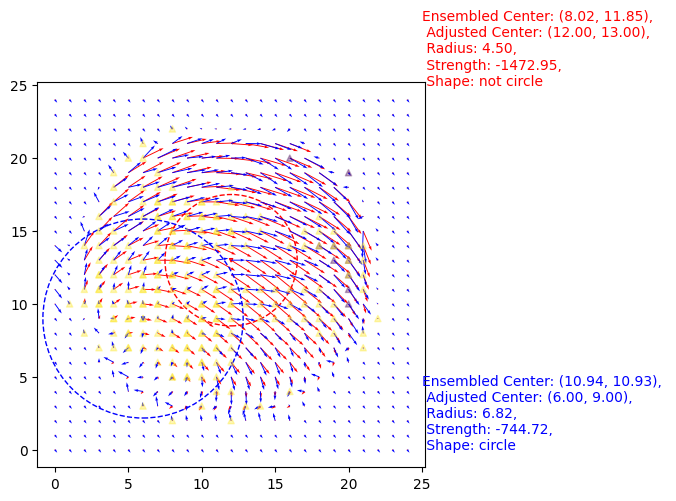

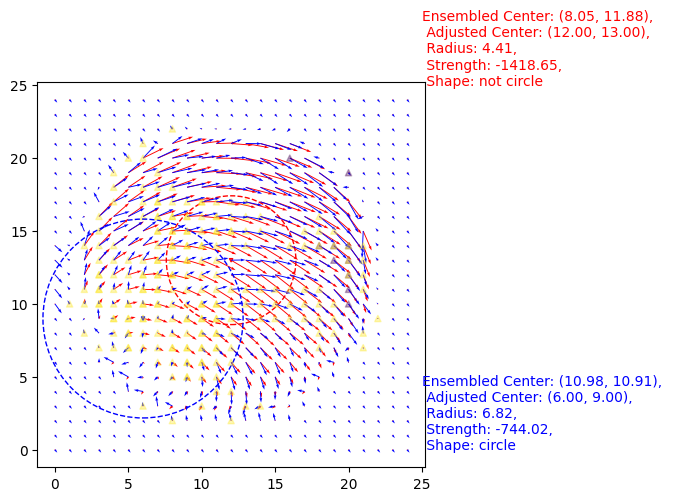

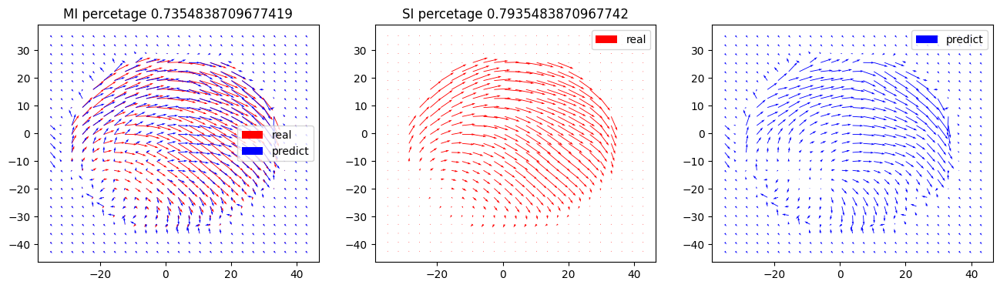

In [13]:
map_num=p_tot
center=np.zeros((p_tot,6))

strength=np.zeros((map_num,2))
bias_center=np.zeros(map_num)
for i in range(map_num):
    print(i)
    j=i
    

    
    mi_t[i],mi_t_per[i]=miscore(pltpredict[:,:,j,],v_test[:,:,j,:])
    si_t[i],si_t_per[i]=siscore(pltpredict[:,:,j,],v_test[:,:,j,:])

    center[j],bias_center[j],strength[j] = cmp_center(v_test[:,::-1,j,0].T,v_test[:,::-1,j,1].T,pltpredict[:,::-1,j,0].T,pltpredict[:,::-1,j,1].T,n)
    
    
    
    if i%(addp)==0:
        
        plt.figure(figsize=(16, 4))
        plt.subplot(1, 3, 1)
        plt.title('MI percetage '+str(mi_t_per[i]))
        plt.quiver(spatial_grid[:,:,0],spatial_grid[:,:,1],v_test[:,:,j,0],v_test[:,:,j,1],color='r',label='real')
        plt.quiver(spatial_grid[:,:,0],spatial_grid[:,:,1],pltpredict[:,:,j,0],pltpredict[:,:,j,1],color='b',label='predict')
        plt.legend()
        plt.subplot(1, 3, 2)
        plt.title('SI percetage '+str(si_t_per[i]))
        plt.quiver(spatial_grid[:,:,0],spatial_grid[:,:,1],v_test[:,:,j,0],v_test[:,:,j,1],color='r',label='real')
        #plt.quiver(spatial_grid[:,:,1],spatial_grid[:,:,0],pltpredict[:,:,i,0],pltpredict[:,:,i,1],color='b')
        plt.legend()
        plt.subplot(1, 3, 3)
        #plt.quiver(spatial_grid[:,:,1],spatial_grid[:,:,0],u_dot_train[:,:,i+1,0],u_dot_train[:,:,i+1,1],color='r')
        plt.quiver(spatial_grid[:,:,0],spatial_grid[:,:,1],pltpredict[:,:,j,0],pltpredict[:,:,j,1],color='b',label='predict')
        plt.legend()
        plt.show()
        '''
        plt.figure(figsize=(4, 4))
        plt.quiver(spatial_grid[:,:,0],spatial_grid[:,:,1],df_vx,df_vy)
        plt.show()
        '''
    

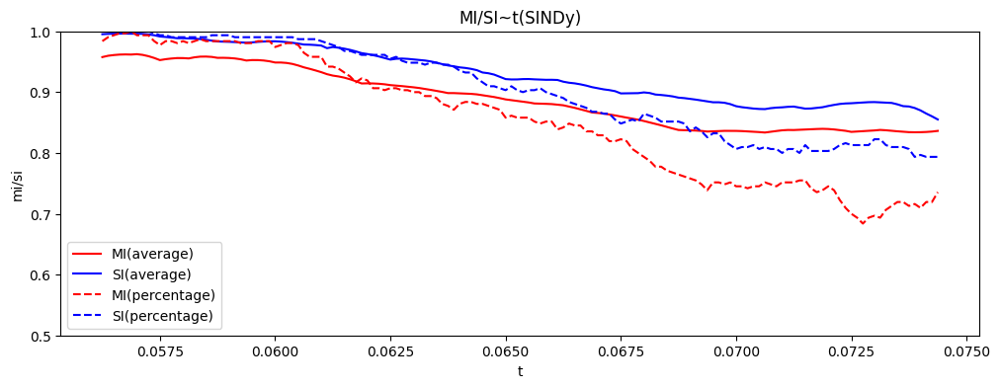

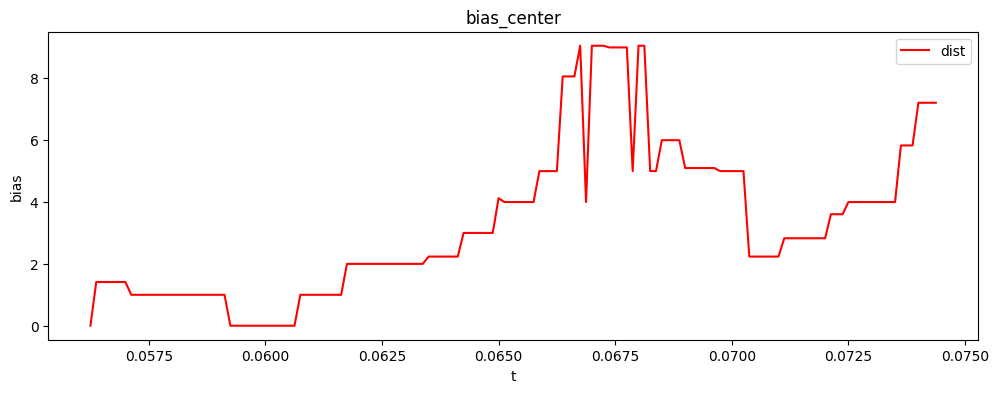

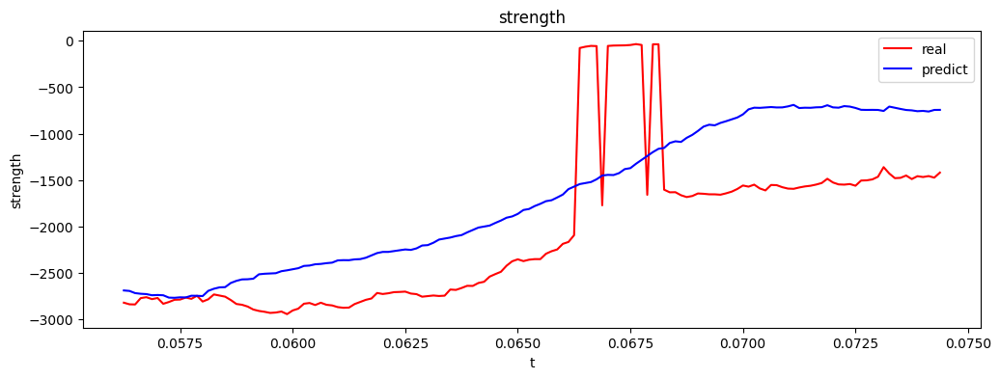

In [14]:
plt.figure(figsize=(12, 4))
plt.title('MI/SI~t(SINDy)')
plt.ylim(0,1)
plt.xlabel('t')
plt.ylabel('mi/si')
plt.plot(t_train,mi_t,'r',label='MI(average)')
plt.plot(t_train,si_t,'b',label='SI(average)')
plt.plot(t_train,mi_t_per,'r--',label='MI(percentage)')
plt.plot(t_train,si_t_per,'b--',label='SI(percentage)')
plt.legend()
plt.ylim(0.5, 1)
plt.plot
plt.show()

plt.figure(figsize=(12, 4))
plt.title('bias_center')
#plt.ylim(0,1)
plt.xlabel('t')
plt.ylabel('bias')
plt.plot(t_train,bias_center,'r',label='dist')

plt.legend()
#plt.ylim(0.5, 1)
plt.plot
plt.show()

plt.figure(figsize=(12, 4))
plt.title('strength')

plt.xlabel('t')
plt.ylabel('strength')
plt.plot(t_train,strength[:,0],'r',label='real')
plt.plot(t_train,strength[:,1],'b',label='predict')

plt.legend()

plt.show()